# COVID19 - District Region of Sao Paulo State, Brazil

In [1]:
from environs import Env
env = Env()
env.str("CUDA_DEVICE_ORDER",'PCI_BUS_ID')
env.int("CUDA_VISIBLE_DEVICES",1)
env.int("NUMBA_ENABLE_CUDASIM",1)
env.bool("OMPI_MCA_opal_cuda_support",True)

import os
import ray
# MB=1024*1024
# GB=MB*1024
# ray.init(num_gpus=5,num_cpus=1)
# @ray.remote(num_gpus=1)
# def use_gpu():
#     print("ray.get_gpu_ids(): {}".format(ray.get_gpu_ids()[0]))
#     print("CUDA_VISIBLE_DEVICES: {}".format(os.environ["CUDA_VISIBLE_DEVICES"]))

# use_gpu.remote()

In [2]:
import urllib.request
import pandas as pd
import numpy as np
from datetime import datetime,timedelta

In [3]:
# Download data
import get_data
LoadData=True

if LoadData:
    get_data.get_data()

Baixando arquivos brasil.io...


In [4]:
dfSP = pd.read_csv("data/dados_municipios_SP.csv")
dfSP
dfSP.query('DRS == "{}"'.format('DRS 01 - Grande São Paulo'))

,date,state,city,place_type,confirmed,deaths,order_for_place,is_last,popEst,estimated_population,city_ibge_code,confirmed_per_100k_inhabitants,death_rate,DRS
8404,2020-12-24,SP,Arujá,city,2804,111,255,True,89824.0,91157.0,3503901.0,3076.01172,0.0396,DRS 01 - Grande São Paulo
8405,2020-12-22,SP,Arujá,city,2764,110,254,False,89824.0,91157.0,3503901.0,3032.13138,0.0398,DRS 01 - Grande São Paulo
8406,2020-12-21,SP,Arujá,city,2757,110,253,False,89824.0,91157.0,3503901.0,3024.45232,0.0399,DRS 01 - Grande São Paulo
8407,2020-12-20,SP,Arujá,city,2753,110,252,False,89824.0,91157.0,3503901.0,3020.06428,0.0400,DRS 01 - Grande São Paulo
8408,2020-12-18,SP,Arujá,city,2728,110,251,False,89824.0,91157.0,3503901.0,2992.63907,0.0403,DRS 01 - Grande São Paulo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
137487,2020-03-30,SP,Vargem Grande Paulista,city,2,1,5,False,52597.0,53468.0,3556453.0,3.74056,0.5000,DRS 01 - Grande São Paulo
137488,2020-03-27,SP,Vargem Grande Paulista,city,2,1,4,False,52597.0,53468.0,3556453.0,3.74056,0.5000,DRS 01 - Grande São Paulo
137489,2020-03-26,SP,Vargem Grande Paulista,city,1,1,3,False,52597.0,53468.0,3556453.0,1.87028,1.0000,DRS 01 - Grande São Paulo
137490,2020-03-25,SP,Vargem Grande Paulista,city,0,1,2,False,52597.0,53468.0,3556453.0,NaN,0.0000,DRS 01 - Grande São Paulo


# Model

In [5]:
# lista DRSs
DRS = list(dfSP["DRS"].unique())
DRS.remove("Indefinido")
DRS

['DRS 09 - Marília',
 'DRS 15 - São José do Rio Preto',
 'DRS 14 - São João da Boa Vista',
 'DRS 06 - Bauru',
 'DRS 16 - Sorocaba',
 'DRS 11 - Presidente Prudente',
 'DRS 05 - Barretos',
 'DRS 13 - Ribeirão Preto',
 'DRS 02 - Araçatuba',
 'DRS 07 - Campinas',
 'DRS 03 - Araraquara',
 'DRS 10 - Piracicaba',
 'DRS 17 - Taubaté',
 'DRS 08 - Franca',
 'DRS 01 - Grande São Paulo',
 'DRS 12 - Registro',
 'DRS 04 - Baixada Santista']

# SEAIR-D Model Equations

$$\begin{array}{l}\frac{d s}{d t}=-[\beta i(t) + \beta_2 a(t)-\mu] \cdot s(t)\\ 
\frac{d e}{d t}=[\beta i(t) + \beta_2 a(t)] \cdot s(t) -(\sigma+\mu) \cdot e(t)\\ 
\frac{d a}{d t}=\sigma e(t) \cdot (1-p)-(\gamma+\mu) \cdot a(t) \\
\frac{d i}{d t}=\sigma e(t) \cdot p - (\gamma + \sigma_2 + \sigma_3 + \mu) \cdot i(t)\\ 
\frac{d r}{d t}=(b + \sigma_2) \cdot i(t) + \gamma \cdot a(t) - \mu \cdot r(t)\\
\frac{d k}{d t}=(a + \sigma_3 - \mu) \cdot d(t)
\end{array}$$

The sum of all people accounted is equal to population considered:

$$s + e + a + i + r + k = N$$

The derivate is:

$$\frac{d s}{d t}+\frac{d e}{d t}+\frac{d a}{d t}+\frac{d i}{d t}+\frac{d r}{d t}+\frac{d k}{d t} = 0$$

The last equation does not need to be solve because:

$$\frac{d k}{d t}=-(\frac{d s}{d t}+\frac{d e}{d t}+\frac{d a}{d t}+\frac{d i}{d t}+\frac{d r}{d t})$$

The sum of all rates are equal to zero! The importance of this equation is that it conservates the rates.


## Parameters

N: the population considered

$\beta$: Effective contact rate [1/min]
    
$\gamma$: Recovery(+Mortality) rate $\gamma=(a+b)$ [1/min]

$a$: mortality of healed  [1/min]

$b$: recovery rate  [1/min]

$\sigma$: is the rate at which individuals move from the exposed to the infectious classes. Its reciprocal ($1/\sigma$) is the average latent (exposed) period.

$\sigma_2$: is the rate at which individuals move from the infectious to the healed classes. Its reciprocal ($1/\sigma_2$) is the average latent (exposed) period

$\sigma_3$: is the rate at which individuals move from the infectious to the dead classes. Its reciprocal ($1/\sigma_3$) is the average latent (exposed) period
    
$p$: is the fraction of the exposed which become symptomatic infectious sub-population.

$(1-p)$: is the fraction of the exposed which becomes asymptomatic infectious sub-population.

## Options: Param.CSV file, changeCSV, Adjust Param, Save CSV, Select Specific DRS

In [6]:
from IPython.display import display, HTML, Markdown

paramOpt=6
changeCSV=True
adjustParam=True
paramSave=False
selectDRS=False

## Different Options to Load Param.CSV file

In [7]:
if paramOpt==0:
    paramFile="data/param.csv"
    version = "1"
    model = "ManualIC"
    
if paramOpt==1:
    paramFile="data/param_optimized_Yabox_HistMin-Copy1.csv"
    version = "106"
    model = "YaboxICAdjusted"

if paramOpt==2:
    paramFile="data/param_optimized_Yabox_HistMin-Copy2.csv.csv"
    version = "107"
    model = "YaboxICAdjusted"
    
if paramOpt==3 or paramOpt==4:
    paramFile="data/param_optimized_Yabox_HistMin-Copy3.csv"
    version = "107"
    model = "YaboxICAdjusted"
    
if paramOpt==5 or paramOpt==6:
    paramFile="data/param_optimized_Yabox_HistMin.csv"
    version = "109"
    model = "YaboxIC"    

In [8]:
dfparam = pd.read_csv(paramFile)
dfparam = dfparam.dropna()
dfparam.e0=0
dfparam.r0=0

display(Markdown("## Original Initial Parameters"))
display(dfparam)

## Original Initial Parameters

,DRS,start-date,prediction-range,s0,e0,a0,i0,r0,d0,START,RATIO,WCASES,WREC
0,DRS 01 - Grande São Paulo,2020-03-20,200,8236559,0,0,131,0,8,41,0.15,0.0541,0.0079
1,DRS 02 - Araçatuba,2020-04-01,200,315758,0,0,125,0,45,120,0.15,0.5656,0.0107
2,DRS 03 - Araraquara,2020-03-31,200,395072,0,0,3,0,96,61,0.15,0.2132,0.0017
3,DRS 04 - Baixada Santista,2020-03-31,200,735609,0,0,172,0,91,21,0.15,0.3301,0.0102
4,DRS 05 - Barretos,2020-04-02,200,148619,0,0,184,0,77,132,0.15,0.1400,0.0118
5,DRS 06 - Bauru,2020-04-01,200,591329,0,0,104,0,81,82,0.15,0.3995,0.0275
6,DRS 07 - Campinas,2020-03-30,200,1341194,0,0,109,0,36,50,0.15,0.2512,0.0086
7,DRS 08 - Franca,2020-03-30,200,244220,0,0,190,0,72,131,0.15,0.3988,0.0420
8,DRS 09 - Marília,2020-03-31,200,211558,0,0,130,0,15,52,0.15,0.2014,0.0093
9,DRS 10 - Piracicaba,2020-03-30,200,606592,0,0,189,0,48,67,0.15,0.3043,0.0165


## Modify param.csv file to fit better the data

In [9]:
if changeCSV and paramOpt==1:
    dfparam['s0'] = pd.to_numeric(dfparam['s0'],errors='coerce')
    dfparam['i0'] = pd.to_numeric(dfparam['i0'],errors='coerce')
    dfparam['d0'] = pd.to_numeric(dfparam['d0'],errors='coerce')
    dfparam['s0'] = dfparam['s0'].astype(float)
    dfparam['i0'] = dfparam['i0'].astype(float)
    dfparam['d0'] = dfparam['d0'].astype(float)
    dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','s0'] = dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','s0'].values[0]*1.1
    dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','i0'] = dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','i0']*.1
    dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','d0'] = dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','d0']*.5
    dfparam.loc[dfparam.DRS=='DRS 02 - Araçatuba','s0'] = dfparam.loc[dfparam.DRS=='DRS 02 - Araçatuba','s0']*3*2
    dfparam.loc[dfparam.DRS=='DRS 02 - Araçatuba','i0'] = dfparam.loc[dfparam.DRS=='DRS 02 - Araçatuba','i0']*.2*0.3
    dfparam.loc[dfparam.DRS=='DRS 02 - Araçatuba','d0'] = dfparam.loc[dfparam.DRS=='DRS 02 - Araçatuba','d0']*0.9
    dfparam.loc[dfparam.DRS=='DRS 03 - Araraquara','i0'] = dfparam.loc[dfparam.DRS=='DRS 03 - Araraquara','i0']*.2
    dfparam.loc[dfparam.DRS=='DRS 03 - Araraquara','d0'] = dfparam.loc[dfparam.DRS=='DRS 03 - Araraquara','d0']*.1
    dfparam.loc[dfparam.DRS=='DRS 04 - Baixada Santista','s0'] = dfparam.loc[dfparam.DRS=='DRS 04 - Baixada Santista','s0']*2.5*1.5
    dfparam.loc[dfparam.DRS=='DRS 05 - Barretos','i0'] = dfparam.loc[dfparam.DRS=='DRS 05 - Barretos','i0']*.1*0.5
    dfparam.loc[dfparam.DRS=='DRS 11 - Presidente Prudente','i0'] = dfparam.loc[dfparam.DRS=='DRS 11 - Presidente Prudente','i0']*.3
    dfparam.loc[dfparam.DRS=='DRS 10 - Piracicaba','i0'] = dfparam.loc[dfparam.DRS=='DRS 10 - Piracicaba','i0']*.3
    dfparam.loc[dfparam.DRS=='DRS 12 - Registro','d0'] = dfparam.loc[dfparam.DRS=='DRS 12 - Registro','d0']*.1
    dfparam.loc[dfparam.DRS=='DRS 12 - Registro','i0'] = dfparam.loc[dfparam.DRS=='DRS 12 - Registro','i0']*.1
    dfparam.loc[dfparam.DRS=='DRS 15 - São José do Rio Preto','i0'] = dfparam.loc[dfparam.DRS=='DRS 15 - São José do Rio Preto','i0']*.3
    dfparam.loc[dfparam.DRS=='DRS 16 - Sorocaba','i0'] = dfparam.loc[dfparam.DRS=='DRS 16 - Sorocaba','i0']*.3
    dfparam.loc[dfparam.DRS=='DRS 17 - Taubaté','i0'] = dfparam.loc[dfparam.DRS=='DRS 17 - Taubaté','i0']*.3        

if changeCSV and (paramOpt==2 or paramOpt==4):
    dfparam['s0'] = pd.to_numeric(dfparam['s0'],errors='coerce')
    dfparam['i0'] = pd.to_numeric(dfparam['i0'],errors='coerce')
    dfparam['d0'] = pd.to_numeric(dfparam['d0'],errors='coerce')
    dfparam['s0'] = dfparam['s0'].astype(float)
    dfparam['i0'] = dfparam['i0'].astype(float)
    dfparam['d0'] = dfparam['d0'].astype(float)
    dfparam.loc[dfparam.DRS=='DRS 05 - Barretos','i0'] = dfparam.loc[dfparam.DRS=='DRS 05 - Barretos','i0']*.1
    dfparam.loc[dfparam.DRS=='DRS 11 - Presidente Prudente','i0'] = dfparam.loc[dfparam.DRS=='DRS 11 - Presidente Prudente','i0']*.1
    dfparam.loc[dfparam.DRS=='DRS 12 - Registro','d0'] = dfparam.loc[dfparam.DRS=='DRS 12 - Registro','d0']*.1
    dfparam.loc[dfparam.DRS=='DRS 12 - Registro','i0'] = dfparam.loc[dfparam.DRS=='DRS 12 - Registro','i0']*.1 
    
if changeCSV and (paramOpt==3 or paramOpt==4):
    dfparam['s0'] = pd.to_numeric(dfparam['s0'],errors='coerce')
    dfparam['i0'] = pd.to_numeric(dfparam['i0'],errors='coerce')
    dfparam['d0'] = pd.to_numeric(dfparam['d0'],errors='coerce')
    dfparam['s0'] = dfparam['s0'].astype(float)
    dfparam['i0'] = dfparam['i0'].astype(float)
    dfparam['d0'] = dfparam['d0'].astype(float)
    dfparam.loc[dfparam.DRS=='DRS 03 - Araraquara','i0'] = dfparam.loc[dfparam.DRS=='DRS 03 - Araraquara','i0']*.1
    dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','i0'] = dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','i0']*.1
    dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','d0'] = dfparam.loc[dfparam.DRS=='DRS 14 - São João da Boa Vista','d0']*.1
    dfparam.loc[dfparam.DRS=='DRS 15 - São José do Rio Preto','i0'] = dfparam.loc[dfparam.DRS=='DRS 15 - São José do Rio Preto','i0']*.1

if changeCSV and (paramOpt==6):
    dfparam['s0'] = pd.to_numeric(dfparam['s0'],errors='coerce')
    dfparam['i0'] = pd.to_numeric(dfparam['i0'],errors='coerce')
    dfparam['d0'] = pd.to_numeric(dfparam['d0'],errors='coerce')
    dfparam['s0'] = dfparam['s0'].astype(float)
    dfparam['i0'] = dfparam['i0'].astype(float)
    dfparam['d0'] = dfparam['d0'].astype(float)
    dfparam.loc[dfparam.DRS=='DRS 12 - Registro','d0'] = dfparam.loc[dfparam.DRS=='DRS 12 - Registro','d0']*.1
    dfparam.loc[dfparam.DRS=='DRS 12 - Registro','i0'] = dfparam.loc[dfparam.DRS=='DRS 12 - Registro','i0']*.5 
    dfparam.loc[dfparam.DRS=='DRS 08 - Franca','d0'] = dfparam.loc[dfparam.DRS=='DRS 08 - Franca','d0']*.1
    dfparam.loc[dfparam.DRS=='DRS 01 - Grande São Paulo','s0'] = dfparam.loc[dfparam.DRS=='DRS 01 - Grande São Paulo','s0']*1.2
    dfparam.loc[dfparam.DRS=='DRS 04 - Baixada Santista','s0'] = dfparam.loc[dfparam.DRS=='DRS 04 - Baixada Santista','s0']*2.5
    dfparam.loc[dfparam.DRS=='DRS 04 - Baixada Santista','d0'] = dfparam.loc[dfparam.DRS=='DRS 04 - Baixada Santista','d0']*0.5
    dfparam.loc[dfparam.DRS=='DRS 03 - Araraquara','d0'] = dfparam.loc[dfparam.DRS=='DRS 03 - Araraquara','d0']*.1
    dfparam.loc[dfparam.DRS=='DRS 09 - Marília','d0'] = dfparam.loc[dfparam.DRS=='DRS 09 - Marília','d0']*1.5
    dfparam.loc[dfparam.DRS=='DRS 09 - Marília','s0'] = dfparam.loc[dfparam.DRS=='DRS 09 - Marília','s0']*0.7

if adjustParam:
    sCorrect=[1.38,1.0,1.05,1.5,1.5,1.4,1.1,1.5,1.15,1.55,1.35,1.2,1.35,1.15,1.55,1.45,1.25]
    dfparam.s0=dfparam.s0.multiply(sCorrect[:len(DRS)], axis=0)
    
if selectDRS and paramOpt==1:
    DRS=['DRS 14 - São João da Boa Vista','DRS 02 - Araçatuba','DRS 03 - Araraquara',
        'DRS 04 - Baixada Santista','DRS 05 - Barretos','DRS 11 - Presidente Prudente',
        'DRS 10 - Piracicaba','DRS 12 - Registro','DRS 16 - Sorocaba','DRS 17 - Taubaté']    
    
if selectDRS and paramOpt==2:
    DRS=['DRS 05 - Barretos','DRS 11 - Presidente Prudente',
        'DRS 12 - Registro']
    
if selectDRS and paramOpt==3:
    DRS=['DRS 03 - Araraquara','DRS 14 - São João da Boa Vista',
        'DRS 15 - São José do Rio Preto']

if selectDRS and paramOpt==4:
    DRS=['DRS 05 - Barretos','DRS 11 - Presidente Prudente',
        'DRS 12 - Registro', 'DRS 03 - Araraquara','DRS 14 - São João da Boa Vista',
        'DRS 15 - São José do Rio Preto']

if selectDRS and paramOpt==6:
    DRS=['DRS 01 - Grande São Paulo', 
         'DRS 04 - Baixada Santista',
         'DRS 03 - Araraquara',
         'DRS 02 - Araçatuba']

if not selectDRS:
    DRS=dfparam.DRS    

dfparam['s0'] = dfparam['s0'].astype(int)
dfparam['i0'] = dfparam['i0'].astype(int)
dfparam['d0'] = dfparam['d0'].astype(int)

if paramSave:
    dfparam.to_csv("new_"+paramFile)    
    
dfparam['prediction-range']=300

display(Markdown("## Modified Initial Parameters"))

# dfparam['DRS'] = dfparam['DRS'].str.encode('latin-1')
    
display(dfparam)


## Modified Initial Parameters

,DRS,start-date,prediction-range,s0,e0,a0,i0,r0,d0,START,RATIO,WCASES,WREC
0,DRS 01 - Grande São Paulo,2020-03-20,300,13639741,0,0,131,0,8,41,0.15,0.0541,0.0079
1,DRS 02 - Araçatuba,2020-04-01,300,315758,0,0,125,0,45,120,0.15,0.5656,0.0107
2,DRS 03 - Araraquara,2020-03-31,300,414825,0,0,3,0,9,61,0.15,0.2132,0.0017
3,DRS 04 - Baixada Santista,2020-03-31,300,2758533,0,0,172,0,45,21,0.15,0.3301,0.0102
4,DRS 05 - Barretos,2020-04-02,300,222928,0,0,184,0,77,132,0.15,0.1400,0.0118
5,DRS 06 - Bauru,2020-04-01,300,827860,0,0,104,0,81,82,0.15,0.3995,0.0275
6,DRS 07 - Campinas,2020-03-30,300,1475313,0,0,109,0,36,50,0.15,0.2512,0.0086
7,DRS 08 - Franca,2020-03-30,300,366330,0,0,190,0,7,131,0.15,0.3988,0.0420
8,DRS 09 - Marília,2020-03-31,300,170304,0,0,130,0,22,52,0.15,0.2014,0.0093
9,DRS 10 - Piracicaba,2020-03-30,300,940217,0,0,189,0,48,67,0.15,0.3043,0.0165


# Solver Loading and Version

In [10]:
%reload_ext autoreload
%autoreload 2
import LearnerYabox_v2 as Learner #Yabox

2020-12-28 12:44:55,897	INFO services.py:1092 -- View the Ray dashboard at http://127.0.0.1:8266


In [11]:
allDistricts=True
cleanRecovered=False
version="9"

if allDistricts:
    display(DRS)
else:
    districtRegionSelected="DRS 01 - Grande São Paulo"
    display(districtRegionSelected)

0          DRS 01 - Grande São Paulo
1                 DRS 02 - Araçatuba
2                DRS 03 - Araraquara
3          DRS 04 - Baixada Santista
4                  DRS 05 - Barretos
5                     DRS 06 - Bauru
6                  DRS 07 - Campinas
7                    DRS 08 - Franca
8                   DRS 09 - Marília
9                DRS 10 - Piracicaba
10      DRS 11 - Presidente Prudente
11                 DRS 12 - Registro
12           DRS 13 - Ribeirão Preto
13    DRS 14 - São João da Boa Vista
14    DRS 15 - São José do Rio Preto
15                 DRS 16 - Sorocaba
16                  DRS 17 - Taubaté
Name: DRS, dtype: object

In [12]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines){
    return true;}

<IPython.core.display.Javascript object>

# Main Loop

In [13]:

if allDistricts:

    loop=[0,6,11,17]
    for i in range(0,len(loop)-1):
        results=[]
        for districtRegion in DRS[loop[i]:loop[i+1]]:
            query = dfparam.query('DRS == "{}"'.format(districtRegion)).reset_index()
            parameters = np.array(query.iloc[:, 2:])[0]
            dR=ray.put(districtRegion)
            pr=ray.put(parameters)
            cR=ray.put(cleanRecovered)
            vR=ray.put(version)
            f=Learner.Learner.remote(dR, *parameters, cR, vR)
            result = f.train.remote() 
            results.append(result)
        display("Running {:d} to {:d}".format(loop[i],loop[i+1]))
        resultsFinal = ray.get(results)

else:
    districtRegion= districtRegionSelected 
    #"DRS 01 - Grande São Paulo" #'DRS 08 - Franca' \
    #'DRS 14 - São João da Boa Vista' #'DRS 04 - Baixada Santista' \
    #'DRS 11 - Presidente Prudente' #'DRS 13 - Ribeirão Preto' \
    #'DRS 05 - Barretos' #'DRS 12 - Registro' #'DRS 15 - São José do Rio Preto' \
    #'DRS 10 - Piracicaba'#'DRS 17 - Taubaté'#'DRS 02 - Araçatuba'# \
    #'DRS 03 - Araraquara' #DRS 07 - Campinas'#'DRS 16 - Sorocaba'#'DRS 06 - Bauru' \
    #'DRS 09 - Marília' #"DRS 01 - Grande São Paulo"
    query = dfparam.query('DRS == "{}"'.format(districtRegion)).reset_index()
    parameters = np.array(query.iloc[:, 2:])[0]
    dR=ray.put(districtRegion)
    cR=ray.put(cleanRecovered)
    vR=ray.put(version)
    f=Learner.Learner.remote(dR, *parameters, cR, vR)
    result = f.train.remote() 
    results.append(result)



'Running 0 to 6'

  0%|          | 465/9625000 [00:33<98:28:46, 27.15it/s] 


  0%|          | 1891/9625000 [01:03<43:45:19, 61.09it/s]


  0%|          | 4278/9625000 [01:32<27:25:54, 97.42it/s]


  0%|          | 5671/9625000 [02:00<23:12:49, 115.11it/s]


  0%|          | 12720/9625000 [02:24<12:27:00, 214.46it/s]


  0%|          | 18336/9625000 [02:47<9:53:54, 269.59it/s] 


  0%|          | 16471/9625000 [03:01<12:20:00, 216.41it/s]
(pid=15016) /home/ats4i/anaconda3/envs/geo_env/lib/python3.6/site-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
(pid=15016)   warnings.warn(warning_msg, ODEintWarning)
  0%|          | 13041/9625000 [03:09<15:59:16, 167.00it/s]


  0%|          | 17578/9625000 [03:31<11:58:50, 222.75it/s]


  0%|          | 29403/9625000 [03:54<9:54:59, 268.79it/s] 


  0%|          | 46056/9625000 [04:16<6:36:51, 402.29it/s]


  0%|          | 34980/9625000 [04:38<8:48:34, 302.38it/s]


  1%|          | 66066/9625000 [05:00<5:24:00, 491.69it/s]


  1%|          | 77421/9625000 [05:22<4:54:44, 539.87it/s]


  1%|          | 89676/9625000 [05:44<4:40:59, 565.56it/s]


  1%|          | 83436/9625000 [06:06<5:06:05, 519.55it/s]


  1%|          | 95266/9625000 [06:27<4:34:20, 578.96it/s]


  1%|          | 87153/9625000 [06:48<5:35:42, 473.52it/s]


  2%|▏         | 147153/9625000 [07:11<3:30:02, 752.04it/s]


  1%|▏         | 123753/9625000 [07:34<4:41:00, 563.53it/s]


  2%|▏         | 197506/9625000 [07:56<2:55:21, 895.99it/s]


  2%|▏         | 198765/9625000 [08:17<2:59:06, 877.15it/s]


  2%|▏         | 237705/9625000 [08:38<2:36:17, 1001.03it/s]


  2%|▏         | 237705/9625000 [08:59<2:39:49, 978.92it/s]


  3%|▎         | 258121/9625000 [09:20<2:38:59, 981.92it/s]


  2%|▏         | 234955/9625000 [09:40<2:52:47, 905.70it/s]


  2%|▏         | 205120/9625000 [10:01<3:22:46, 774.23it/s]


  4%|▎         | 352380/9625000 [10:21<2:07:18, 1213.89it/s]


  4%|▎         | 350703/9625000 [10:42<2:03:25, 1252.43it/s]


  3%|▎         | 312445/9625000 [11:04<2:28:01, 1048.57it/s]


  3%|▎         | 299925/9625000 [11:25<2:44:25, 945.25it/s]


  4%|▍         | 430128/9625000 [11:47<1:53:50, 1346.14it/s]


  5%|▌         | 489555/9625000 [12:07<1:45:27, 1443.81it/s]


  4%|▍         | 406351/9625000 [12:27<2:08:26, 1196.17it/s]


  4%|▍         | 431056/9625000 [12:47<2:04:40, 1229.05it/s]


  6%|▌         | 583740/9625000 [13:07<1:33:18, 1614.98it/s]


  5%|▌         | 481671/9625000 [13:28<1:57:40, 1294.97it/s]


  4%|▍         | 412686/9625000 [13:47<2:24:19, 1063.90it/s]


  7%|▋         | 686206/9625000 [14:07<1:22:19, 1809.72it/s]


  5%|▍         | 458403/9625000 [14:28<2:12:29, 1153.07it/s]


  8%|▊         | 753378/9625000 [14:51<1:16:29, 1933.18it/s]


  8%|▊         | 795691/9625000 [15:13<1:14:59, 1962.13it/s]


  7%|▋         | 646953/9625000 [15:33<1:40:41, 1486.02it/s]


  6%|▌         | 555985/9625000 [15:53<1:51:25, 1356.47it/s]


  9%|▉         | 853471/9625000 [16:13<1:15:18, 1941.33it/s]


  8%|▊         | 741153/9625000 [16:33<1:30:54, 1628.71it/s]


  7%|▋         | 687378/9625000 [16:52<1:39:20, 1499.48it/s]


 11%|█         | 1049076/9625000 [17:11<1:02:52, 2272.99it/s]


  7%|▋         | 693253/9625000 [17:31<1:39:09, 1501.28it/s]


  7%|▋         | 721801/9625000 [17:50<1:39:06, 1497.15it/s]


  8%|▊         | 808356/9625000 [18:10<1:30:00, 1632.58it/s]


 12%|█▏        | 1143828/9625000 [18:32<1:03:10, 2237.73it/s]


 13%|█▎        | 1271215/9625000 [18:52<54:34, 2550.82it/s]


  9%|▉         | 844350/9625000 [19:13<1:27:37, 1670.26it/s]


 13%|█▎        | 1269621/9625000 [19:33<57:41, 2414.06it/s]


  9%|▉         | 910575/9625000 [19:53<1:28:39, 1638.11it/s]


 10%|█         | 1007490/9625000 [20:13<1:19:39, 1803.04it/s]


 16%|█▌        | 1537381/9625000 [20:32<46:53, 2874.61it/s]


 15%|█▌        | 1466328/9625000 [20:51<50:52, 2672.86it/s]


 17%|█▋        | 1653471/9625000 [21:10<41:20, 3213.38it/s]


 12%|█▏        | 1146855/9625000 [21:28<1:12:40, 1944.09it/s]


 18%|█▊        | 1779441/9625000 [21:47<36:48, 3551.80it/s]


 17%|█▋        | 1680861/9625000 [22:06<42:40, 3101.99it/s]


 12%|█▏        | 1192740/9625000 [22:25<1:11:30, 1965.33it/s]


 15%|█▌        | 1450956/9625000 [22:44<59:45, 2280.01it/s]  


 22%|██▏       | 2081820/9625000 [23:02<25:42, 4890.62it/s]


 23%|██▎       | 2170486/9625000 [23:18<22:16, 5576.13it/s]


 24%|██▎       | 2265256/9625000 [23:34<20:44, 5912.88it/s]


 25%|██▍       | 2366400/9625000 [23:52<20:16, 5966.32it/s]


 15%|█▌        | 1461195/9625000 [24:08<1:01:53, 2198.53it/s]


 22%|██▏       | 2122830/9625000 [24:24<34:22, 3637.83it/s]


 28%|██▊       | 2669205/9625000 [24:40<18:01, 6431.04it/s]


 18%|█▊        | 1773786/9625000 [24:56<49:23, 2649.11it/s]


 24%|██▍       | 2318781/9625000 [25:11<26:12, 4644.91it/s]


 17%|█▋        | 1640766/9625000 [25:25<54:07, 2458.50it/s]


 32%|███▏      | 3034416/9625000 [25:43<16:56, 6484.01it/s]


 20%|██        | 1943406/9625000 [25:58<47:03, 2720.30it/s]


 28%|██▊       | 2662278/9625000 [26:14<20:41, 5609.28it/s]


 35%|███▌      | 3376101/9625000 [26:32<13:53, 7496.55it/s]


 29%|██▉       | 2804896/9625000 [26:47<18:13, 6237.39it/s]


 37%|███▋      | 3603270/9625000 [27:02<13:12, 7602.54it/s]


 31%|███       | 2995128/9625000 [27:17<16:04, 6873.61it/s]


 32%|███▏      | 3093828/9625000 [27:31<16:12, 6716.54it/s]


 33%|███▎      | 3201715/9625000 [27:47<15:53, 6735.83it/s]


 34%|███▍      | 3301165/9625000 [28:01<15:04, 6988.30it/s]


 35%|███▌      | 3399528/9625000 [28:16<14:43, 7043.18it/s]


 22%|██▏       | 2110485/9625000 [28:30<42:31, 2945.51it/s]


 37%|███▋      | 3605955/9625000 [28:45<14:10, 7076.84it/s]


 47%|████▋     | 4510506/9625000 [29:01<10:04, 8465.56it/s]


 47%|████▋     | 4570776/9625000 [29:18<42:01, 2004.15it/s]


 49%|████▉     | 4704778/9625000 [29:33<09:19, 8788.05it/s]


 42%|████▏     | 4051281/9625000 [29:47<11:26, 8116.60it/s]


 25%|██▍       | 2392578/9625000 [30:05<38:31, 3128.98it/s]


 44%|████▍     | 4235505/9625000 [30:20<11:17, 7950.50it/s]


 26%|██▌       | 2485335/9625000 [30:34<36:02, 3301.04it/s]


 29%|██▊       | 2762425/9625000 [30:49<32:52, 3478.59it/s]


 27%|██▋       | 2582128/9625000 [31:03<35:42, 3287.68it/s]


 59%|█████▉    | 5673396/9625000 [31:17<06:50, 9622.45it/s]


 60%|██████    | 5805528/9625000 [31:30<06:33, 9708.52it/s] 


 52%|█████▏    | 4988061/9625000 [31:45<08:32, 9042.40it/s]


 28%|██▊       | 2731953/9625000 [31:59<30:33, 3759.54it/s]


 32%|███▏      | 3056628/9625000 [32:12<29:39, 3691.07it/s]


 29%|██▉       | 2838153/9625000 [32:25<27:51, 4061.55it/s]


 27%|██▋       | 2641551/9625000 [32:39<38:27, 3025.88it/s]


 59%|█████▊    | 5643120/9625000 [32:55<06:47, 9760.51it/s]


 31%|███▏      | 3017196/9625000 [33:08<25:09, 4376.96it/s]


 32%|███▏      | 3073960/9625000 [33:21<24:47, 4403.96it/s]


 35%|███▍      | 3365715/9625000 [33:34<26:37, 3917.13it/s]


 63%|██████▎   | 6070870/9625000 [33:50<08:16, 7155.00it/s]
(pid=15015) /home/ats4i/anaconda3/envs/geo_env/lib/python3.6/site-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
(pid=15015)   warnings.warn(warning_msg, ODEintWarning)
 63%|██████▎   | 6077841/9625000 [33:51<07:04, 8347.44it/s]


 34%|███▍      | 3278080/9625000 [34:04<20:03, 5272.71it/s]


 35%|███▍      | 3342405/9625000 [34:16<20:18, 5156.62it/s]


 67%|██████▋   | 6471003/9625000 [34:29<04:51, 10803.72it/s]


 69%|██████▉   | 6619341/9625000 [34:43<04:44, 10573.20it/s]


 38%|███▊      | 3654456/9625000 [34:56<22:51, 4352.94it/s]


 72%|███████▏  | 6887616/9625000 [35:08<04:14, 10759.90it/s]


 73%|███████▎  | 7021878/9625000 [35:21<04:05, 10604.99it/s]


 39%|███▊      | 3719628/9625000 [35:36<33:02, 2979.36it/s]


 89%|████████▉ | 8542911/9625000 [35:48<01:36, 11201.78it/s]


 34%|███▍      | 3288330/9625000 [36:01<28:59, 3643.21it/s]


 35%|███▍      | 3334653/9625000 [36:13<26:58, 3886.38it/s]


 42%|████▏     | 4042746/9625000 [36:28<14:41, 6330.11it/s]


 43%|████▎     | 4131375/9625000 [36:41<19:36, 4667.62it/s]


 83%|████████▎ | 8018010/9625000 [36:53<02:28, 10844.95it/s]


 97%|█████████▋| 9350650/9625000 [37:06<00:21, 12686.59it/s]


 99%|█████████▉| 9524430/9625000 [37:20<00:07, 12743.44it/s]


 46%|████▌     | 4405996/9625000 [37:27<13:28, 6454.94it/s]
9625078it [37:27, 13171.01it/s]                             
 86%|████████▌ | 8260080/9625000 [37:28<13:03, 1743.07it/s]
9629466it [37:28, 12830.76it/s]
 86%|████████▌ | 8264145/9625000 [37:28<09:43, 2330.43it/s]
9633855it [37:28, 12700.35it/s]
 46%|████▌     | 4411935/9625000 [37:28<13:59, 6206.79it/s]
9638245it [37:28, 12980.72it/s]
 86%|████████▌ | 8272278/9625000 [37:29<05:47, 3897.03it/s]
9642636it [37:29, 12814.75it/s]
 86%|████████▌ | 8276346/9625000 [37:29<04:36, 4883.24it/s]
9647028it [37:29, 12686.10it/s]
 86%|████████▌ | 8280415/9625000 [37:29<03:49, 5860.00it/s]
9651421it [37:30, 12751.36it/s]
 38%|███▊      | 3643650/9625000 [37:30<23:11, 4297.45it/s]
9655815it [37:30, 12478.34it/s]
 86%|████████▌ | 8288556/9625000 [37:30<02:49, 7906.80it/s]
9660210it [37:30, 12644.36it/s]
 38%|███▊      | 3646350/9625000 [37:30<23:05, 4315.75it/s]
9664606it [37:31, 12835.90it/s]
 86%|████████▌ | 8296701/9625000 [37:31<02:26, 9076

 46%|████▋     | 4462578/9625000 [37:37<13:32, 6355.71it/s]
9743905it [37:37, 13179.08it/s]
 87%|████████▋ | 8362005/9625000 [37:37<01:53, 11142.91it/s]
9748320it [37:37, 13097.54it/s]
 87%|████████▋ | 8366095/9625000 [37:37<01:53, 11122.63it/s]
9752736it [37:37, 13346.77it/s]
 87%|████████▋ | 8370186/9625000 [37:38<01:51, 11289.46it/s]
9757153it [37:38, 13307.79it/s]
 46%|████▋     | 4471545/9625000 [37:38<13:36, 6311.23it/s]
9761571it [37:38, 13234.18it/s]
9765990it [37:38, 13164.11it/s]
 46%|████▋     | 4474536/9625000 [37:38<13:41, 6268.50it/s]
9770410it [37:39, 13379.65it/s]
 38%|███▊      | 3681541/9625000 [37:39<23:27, 4223.07it/s]
9774831it [37:39, 13482.84it/s]
 45%|████▌     | 4358628/9625000 [37:39<1:46:41, 822.67it/s]
9779253it [37:39, 13053.13it/s]
 38%|███▊      | 3684255/9625000 [37:40<23:25, 4227.34it/s]
9783676it [37:40, 13070.66it/s]
 47%|████▋     | 4483515/9625000 [37:40<14:01, 6109.48it/s]
9788100it [37:40, 13233.21it/s]
 45%|████▌     | 4364535/9625000 [37:40<1:00

9934653it [37:51, 13684.38it/s]
 89%|████████▊ | 8522256/9625000 [37:51<01:37, 11302.79it/s]
9939111it [37:51, 13578.05it/s]
 39%|███▉      | 3736011/9625000 [37:52<23:07, 4244.13it/s]
9943570it [37:52, 13233.05it/s]
 46%|████▌     | 4429776/9625000 [37:52<15:18, 5656.76it/s]
9948030it [37:52, 12935.66it/s]
 89%|████████▊ | 8534646/9625000 [37:52<01:37, 11199.65it/s]
9952491it [37:52, 13221.71it/s]
 46%|████▌     | 4432753/9625000 [37:53<15:17, 5658.17it/s]
9956953it [37:53, 13016.39it/s]
 47%|████▋     | 4564731/9625000 [37:53<13:19, 6330.63it/s]
9961416it [37:53, 12849.12it/s]
 89%|████████▉ | 8547045/9625000 [37:53<01:33, 11510.42it/s]
9965880it [37:54, 12852.88it/s]
 89%|████████▉ | 8551180/9625000 [37:54<01:36, 11167.85it/s]
9970345it [37:54, 13024.99it/s]
 47%|████▋     | 4570776/9625000 [37:54<14:01, 6005.73it/s]
9974811it [37:54, 12830.59it/s]
 46%|████▌     | 4441690/9625000 [37:54<15:50, 5450.44it/s]
9979278it [37:55, 12829.49it/s]
 46%|████▌     | 4444671/9625000 [37:55<15:3

 39%|███▉      | 3793635/9625000 [38:05<21:45, 4468.25it/s]
10118251it [38:05, 13110.88it/s]
 47%|████▋     | 4504501/9625000 [38:05<14:44, 5791.60it/s]
10122750it [38:06, 13021.40it/s]
 48%|████▊     | 4643628/9625000 [38:06<12:22, 6708.34it/s]
10127250it [38:06, 13452.98it/s]
 90%|█████████ | 8688196/9625000 [38:06<01:23, 11176.18it/s]
10131751it [38:06, 13374.57it/s]
 47%|████▋     | 4510506/9625000 [38:06<14:38, 5825.04it/s]
10136253it [38:06, 13530.26it/s]
 90%|█████████ | 8696535/9625000 [38:07<01:23, 11145.87it/s]
10140756it [38:07, 13556.76it/s]
 48%|████▊     | 4652775/9625000 [38:07<12:52, 6432.65it/s]
10145260it [38:07, 13263.71it/s]
 47%|████▋     | 4516515/9625000 [38:07<15:04, 5647.74it/s]
10149765it [38:08, 13337.02it/s]
 90%|█████████ | 8709051/9625000 [38:08<01:17, 11750.57it/s]
10154271it [38:08, 13485.71it/s]
 48%|████▊     | 4658878/9625000 [38:08<13:09, 6291.00it/s]
10158778it [38:08, 13657.71it/s]
 91%|█████████ | 8717400/9625000 [38:08<01:20, 11286.33it/s]
101632

10303530it [38:19, 13532.38it/s]
 48%|████▊     | 4585906/9625000 [38:19<14:08, 5940.77it/s]
10308070it [38:19, 13506.62it/s]
 92%|█████████▏| 8843115/9625000 [38:19<01:07, 11639.95it/s]
10312611it [38:20, 12959.69it/s]
 40%|████      | 3857253/9625000 [38:20<22:03, 4358.63it/s]
10317153it [38:20, 13149.99it/s]
 48%|████▊     | 4591965/9625000 [38:20<13:36, 6167.00it/s]
10321696it [38:20, 12589.06it/s]
 49%|████▉     | 4738581/9625000 [38:21<12:31, 6498.57it/s]
10326240it [38:21, 12931.71it/s]
 40%|████      | 3862810/9625000 [38:21<21:51, 4393.18it/s]
10330785it [38:21, 12692.42it/s]
 92%|█████████▏| 8864155/9625000 [38:21<01:06, 11457.02it/s]
10335331it [38:21, 12615.35it/s]
 48%|████▊     | 4601061/9625000 [38:22<14:12, 5895.29it/s]
10339878it [38:22, 13134.70it/s]
 92%|█████████▏| 8872578/9625000 [38:22<01:05, 11549.31it/s]
10344426it [38:22, 12921.38it/s]
 92%|█████████▏| 8876791/9625000 [38:22<01:06, 11197.56it/s]
10348975it [38:22, 13083.36it/s]
 48%|████▊     | 4607130/9625000 

10508820it [38:35, 13170.23it/s]
 94%|█████████▎| 9020628/9625000 [38:35<00:53, 11260.01it/s]
10513405it [38:35, 13405.17it/s]
 50%|█████     | 4831386/9625000 [38:35<13:10, 6063.10it/s]
10517991it [38:35, 13499.48it/s]
 49%|████▊     | 4686391/9625000 [38:36<13:09, 6258.55it/s]
10522578it [38:36, 12953.10it/s]
 94%|█████████▍| 9033375/9625000 [38:36<00:51, 11433.69it/s]
10527166it [38:36, 12955.73it/s]
 94%|█████████▍| 9037626/9625000 [38:36<00:51, 11384.70it/s]
10531755it [38:36, 12799.81it/s]
 94%|█████████▍| 9041878/9625000 [38:37<00:51, 11307.21it/s]
10536345it [38:37, 12778.25it/s]
 49%|████▉     | 4695580/9625000 [38:37<13:41, 5997.86it/s]
10540936it [38:37, 12640.63it/s]
 94%|█████████▍| 9050385/9625000 [38:37<00:50, 11268.96it/s]
10545528it [38:37, 12750.45it/s]
 94%|█████████▍| 9054640/9625000 [38:38<00:49, 11411.59it/s]
10550121it [38:38, 12415.84it/s]
 94%|█████████▍| 9058896/9625000 [38:38<00:51, 11075.19it/s]
10554715it [38:38, 12445.88it/s]
 94%|█████████▍| 9063153/96250

 41%|████      | 3927003/9625000 [38:49<20:59, 4523.11it/s]
10693000it [38:49, 12866.11it/s]
 50%|████▉     | 4772505/9625000 [38:49<12:49, 6304.57it/s]
10697625it [38:49, 13087.66it/s]
 50%|████▉     | 4775595/9625000 [38:50<12:58, 6232.86it/s]
10702251it [38:49, 13577.56it/s]
 95%|█████████▌| 9187041/9625000 [38:50<00:38, 11282.24it/s]
10706878it [38:50, 13584.34it/s]
 95%|█████████▌| 9191328/9625000 [38:50<00:37, 11512.10it/s]
10711506it [38:50, 13700.28it/s]
 50%|████▉     | 4781778/9625000 [38:50<12:39, 6380.78it/s]
10716135it [38:51, 13384.85it/s]
 96%|█████████▌| 9199905/9625000 [38:51<00:38, 11137.59it/s]
10720765it [38:51, 13292.25it/s]
 51%|█████▏    | 4934511/9625000 [38:51<11:51, 6588.74it/s]
10725396it [38:51, 13125.34it/s]
 50%|████▉     | 4787965/9625000 [38:51<12:11, 6612.02it/s]
10730028it [38:52, 12906.14it/s]
 41%|████      | 3941028/9625000 [38:52<20:41, 4577.88it/s]
10734661it [38:52, 12585.40it/s]
 50%|████▉     | 4794156/9625000 [38:52<12:14, 6580.39it/s]
1073929

 51%|█████     | 4865640/9625000 [39:02<11:01, 7199.49it/s]
10869453it [39:03, 13017.98it/s]
 41%|████▏     | 3991725/9625000 [39:03<20:28, 4585.03it/s]
10874116it [39:03, 13078.58it/s]
 97%|█████████▋| 9333360/9625000 [39:03<00:26, 10943.13it/s]
10878780it [39:03, 12906.99it/s]
 42%|████▏     | 3994551/9625000 [39:03<21:11, 4429.08it/s]
10883445it [39:04, 12595.32it/s]
 51%|█████     | 4875003/9625000 [39:04<10:38, 7434.17it/s]
10888111it [39:04, 12572.92it/s]
 52%|█████▏    | 5019696/9625000 [39:04<11:46, 6522.94it/s]
10892778it [39:04, 12779.16it/s]
 42%|████▏     | 4000206/9625000 [39:05<20:41, 4531.05it/s]
10897446it [39:05, 12677.35it/s]
 51%|█████     | 4884375/9625000 [39:05<10:44, 7351.84it/s]
10902115it [39:05, 12435.10it/s]
 51%|█████     | 4887501/9625000 [39:05<10:33, 7480.77it/s]
10906785it [39:05, 12565.04it/s]
 51%|█████     | 4890628/9625000 [39:06<10:37, 7425.13it/s]
10911456it [39:06, 12384.94it/s]
 52%|█████▏    | 5032378/9625000 [39:06<10:55, 7008.45it/s]
10916128i

 53%|█████▎    | 5099221/9625000 [39:16<10:52, 6933.00it/s]
11042650it [39:16, 12711.40it/s]
 42%|████▏     | 4056976/9625000 [39:16<18:29, 5019.49it/s]
11047350it [39:16, 12778.34it/s]
 99%|█████████▊| 9485190/9625000 [39:17<00:12, 11081.56it/s]
11052051it [39:17, 12995.91it/s]
 99%|█████████▊| 9489546/9625000 [39:17<00:12, 11101.48it/s]
11056753it [39:17, 12989.38it/s]
 42%|████▏     | 4062675/9625000 [39:17<18:33, 4997.40it/s]
11061456it [39:17, 13311.37it/s]
 52%|█████▏    | 4978590/9625000 [39:18<10:06, 7656.26it/s]
11066160it [39:18, 13310.96it/s]
 99%|█████████▊| 9502620/9625000 [39:18<00:10, 11387.44it/s]
11070865it [39:18, 12805.22it/s]
 99%|█████████▉| 9506980/9625000 [39:18<00:10, 11425.16it/s]
11075571it [39:19, 12907.54it/s]
 52%|█████▏    | 4984903/9625000 [39:19<10:09, 7612.99it/s]
11080278it [39:19, 13067.17it/s]
 42%|████▏     | 4071231/9625000 [39:19<18:15, 5068.43it/s]
11084986it [39:19, 13276.33it/s]
 42%|████▏     | 4074085/9625000 [39:20<18:23, 5032.38it/s]
110896

 53%|█████▎    | 5086455/9625000 [39:32<09:52, 7665.38it/s]
11255140it [39:32, 13364.56it/s]
9655815it [39:32, 10766.45it/s]
 53%|█████▎    | 5124801/9625000 [39:32<40:30, 1851.76it/s]
11259885it [39:32, 13583.80it/s]
 53%|█████▎    | 5089645/9625000 [39:32<09:50, 7677.88it/s]
9660210it [39:32, 10753.53it/s]
 53%|█████▎    | 5128003/9625000 [39:33<31:42, 2363.33it/s]
11264631it [39:33, 13734.43it/s]
9664606it [39:33, 10831.57it/s]
 43%|████▎     | 4142881/9625000 [39:33<17:15, 5296.26it/s]
11269378it [39:33, 13641.17it/s]
 53%|█████▎    | 5131206/9625000 [39:33<25:22, 2950.90it/s]
9669003it [39:33, 10957.90it/s]
 53%|█████▎    | 5096028/9625000 [39:33<10:03, 7508.77it/s]
11274126it [39:33, 13708.60it/s]
 43%|████▎     | 4145760/9625000 [39:33<17:14, 5295.83it/s]
9673401it [39:34, 10819.45it/s]
11278875it [39:34, 13801.86it/s]
 53%|█████▎    | 5137615/9625000 [39:34<18:13, 4104.85it/s]
9677800it [39:34, 10657.69it/s]
 53%|█████▎    | 5102415/9625000 [39:34<09:44, 7740.85it/s]
11283625it

 54%|█████▍    | 5198700/9625000 [39:47<09:30, 7757.94it/s]
11455291it [39:47, 13609.87it/s]
 54%|█████▍    | 5227761/9625000 [39:47<10:13, 7168.62it/s]
9823528it [39:47, 11395.45it/s]
 44%|████▍     | 4215156/9625000 [39:47<18:56, 4761.02it/s]
11460078it [39:47, 13861.79it/s]
 54%|█████▍    | 5201925/9625000 [39:47<09:35, 7688.20it/s]
9827961it [39:47, 11312.90it/s]
 54%|█████▍    | 5230995/9625000 [39:47<10:12, 7177.72it/s]
11464866it [39:47, 13646.72it/s]
 54%|█████▍    | 5205151/9625000 [39:48<09:29, 7761.42it/s]
9832395it [39:48, 10957.88it/s]
 54%|█████▍    | 5234230/9625000 [39:48<10:11, 7177.24it/s]
11469655it [39:48, 13675.80it/s]
 54%|█████▍    | 5208378/9625000 [39:48<09:21, 7868.47it/s]
9836830it [39:48, 11398.43it/s]
 54%|█████▍    | 5237466/9625000 [39:48<09:49, 7442.39it/s]
11474445it [39:48, 13439.72it/s]
 54%|█████▍    | 5211606/9625000 [39:48<09:16, 7930.62it/s]
9841266it [39:48, 11207.78it/s]
11479236it [39:48, 13408.64it/s]
 54%|█████▍    | 5214835/9625000 [39:49<09

 55%|█████▌    | 5321953/9625000 [40:03<09:36, 7462.56it/s]
10006101it [40:03, 11583.37it/s]
 45%|████▍     | 4296846/9625000 [40:03<17:27, 5086.87it/s]
10010575it [40:03, 11721.22it/s]
 56%|█████▌    | 5348085/9625000 [40:03<09:46, 7287.53it/s]
10015050it [40:04, 11649.77it/s]
 56%|█████▌    | 5351356/9625000 [40:04<09:37, 7404.86it/s]
10019526it [40:04, 11474.02it/s]
 56%|█████▌    | 5354628/9625000 [40:04<09:25, 7549.78it/s]
10024003it [40:04, 11796.44it/s]
 45%|████▍     | 4305645/9625000 [40:05<17:00, 5214.19it/s]
10028481it [40:05, 11729.07it/s]
 56%|█████▌    | 5361175/9625000 [40:05<09:08, 7779.50it/s]
10032960it [40:05, 11565.20it/s]
 56%|█████▌    | 5364450/9625000 [40:05<09:08, 7765.36it/s]
10037440it [40:05, 11442.85it/s]
 56%|█████▌    | 5367726/9625000 [40:06<08:56, 7932.03it/s]
10041921it [40:06, 11405.05it/s]
10046403it [40:06, 11774.51it/s]
 45%|████▍     | 4314453/9625000 [40:06<18:17, 4839.79it/s]
10050886it [40:07, 11885.75it/s]
 56%|█████▌    | 5374281/9625000 [40:

10190355it [40:18, 12182.08it/s]
 57%|█████▋    | 5463165/9625000 [40:19<08:49, 7865.93it/s]
11710380it [40:19, 14639.03it/s]
 57%|█████▋    | 5440051/9625000 [40:19<09:31, 7324.38it/s]
10194870it [40:19, 12023.49it/s]
 57%|█████▋    | 5466471/9625000 [40:19<08:52, 7808.30it/s]
11715220it [40:19, 14477.54it/s]
 57%|█████▋    | 5443350/9625000 [40:19<09:42, 7177.35it/s]
10199386it [40:19, 11761.82it/s]
 57%|█████▋    | 5469778/9625000 [40:19<08:46, 7898.65it/s]
11720061it [40:19, 14255.57it/s]
 57%|█████▋    | 5446650/9625000 [40:20<09:19, 7462.61it/s]
10203903it [40:20, 11953.23it/s]
11724903it [40:20, 14097.79it/s]
 57%|█████▋    | 5473086/9625000 [40:20<08:38, 8013.02it/s]
10208421it [40:20, 11648.91it/s]
 57%|█████▋    | 5449951/9625000 [40:20<09:24, 7401.71it/s]
11729746it [40:20, 14021.54it/s]
 57%|█████▋    | 5476395/9625000 [40:20<08:42, 7935.24it/s]
11734590it [40:20, 14163.76it/s]
10212940it [40:20, 11794.79it/s]
 57%|█████▋    | 5479705/9625000 [40:21<09:01, 7653.83it/s]
1173

10358076it [40:33, 11226.89it/s]
 58%|█████▊    | 5579470/9625000 [40:33<08:44, 7720.47it/s]
11919403it [40:33, 14440.90it/s]
10362628it [40:33, 11170.44it/s]
 58%|█████▊    | 5582811/9625000 [40:34<08:18, 8106.93it/s]
11924286it [40:34, 14485.41it/s]
 46%|████▋     | 4456605/9625000 [40:34<16:51, 5108.72it/s]
10367181it [40:34, 11133.84it/s]
 58%|█████▊    | 5556111/9625000 [40:34<08:53, 7623.52it/s]
11929170it [40:34, 14207.28it/s]
 46%|████▋     | 4459591/9625000 [40:34<16:10, 5319.80it/s]
10371735it [40:34, 11156.12it/s]
 58%|█████▊    | 5559445/9625000 [40:34<08:34, 7906.94it/s]
11934055it [40:34, 14017.53it/s]
 58%|█████▊    | 5589496/9625000 [40:34<08:11, 8212.44it/s]
10376290it [40:35, 11194.87it/s]
 46%|████▋     | 4462578/9625000 [40:35<16:04, 5351.27it/s]
11938941it [40:35, 13701.59it/s]
 58%|█████▊    | 5592840/9625000 [40:35<08:18, 8081.61it/s]
10380846it [40:35, 11287.17it/s]
11943828it [40:35, 13624.38it/s]
 46%|████▋     | 4465566/9625000 [40:35<16:21, 5257.64it/s]
1194

 59%|█████▉    | 5693625/9625000 [40:48<07:47, 8416.51it/s]
12125350it [40:48, 14241.38it/s]
10522578it [40:48, 11031.14it/s]
 59%|█████▉    | 5666661/9625000 [40:48<08:20, 7906.87it/s]
12130275it [40:48, 14338.80it/s]
 59%|█████▉    | 5697000/9625000 [40:48<08:11, 7998.64it/s]
10527166it [40:48, 11171.83it/s]
 47%|████▋     | 4534566/9625000 [40:48<16:12, 5233.86it/s]
12135201it [40:49, 13821.73it/s]
 59%|█████▉    | 5700376/9625000 [40:49<08:04, 8094.90it/s]
10531755it [40:49, 10968.51it/s]
 47%|████▋     | 4537578/9625000 [40:49<15:26, 5490.88it/s]
12140128it [40:49, 14157.29it/s]
 59%|█████▉    | 5673396/9625000 [40:49<08:29, 7760.84it/s]
10536345it [40:49, 11239.25it/s]
12145056it [40:49, 14122.81it/s]
 59%|█████▉    | 5707131/9625000 [40:49<08:00, 8150.33it/s]
10540936it [40:50, 10934.48it/s]
 59%|█████▉    | 5676765/9625000 [40:50<08:40, 7580.88it/s]
12149985it [40:50, 14061.39it/s]
 47%|████▋     | 4543605/9625000 [40:50<15:35, 5429.30it/s]
10545528it [40:50, 10961.58it/s]
 59%

12347965it [41:04, 14016.08it/s]
 48%|████▊     | 4616241/9625000 [41:04<15:22, 5430.94it/s]
12352935it [41:04, 13481.86it/s]
 60%|██████    | 5822578/9625000 [41:04<08:08, 7784.81it/s]
12357906it [41:04, 13629.25it/s]
 61%|██████    | 5825991/9625000 [41:05<08:20, 7595.82it/s]
12362878it [41:05, 14038.70it/s]
 48%|████▊     | 4622320/9625000 [41:05<15:28, 5387.03it/s]
12367851it [41:05, 13989.36it/s]
 61%|██████    | 5829405/9625000 [41:05<08:15, 7658.65it/s]
12372825it [41:05, 14487.58it/s]
 48%|████▊     | 4625361/9625000 [41:06<15:52, 5251.03it/s]
12377800it [41:06, 14642.93it/s]
12382776it [41:06, 14826.26it/s]
 48%|████▊     | 4628403/9625000 [41:06<15:44, 5288.82it/s]
12387753it [41:06, 14958.16it/s]
 61%|██████    | 5839653/9625000 [41:06<07:59, 7889.21it/s]
12392731it [41:07, 15149.40it/s]
 61%|██████    | 5843071/9625000 [41:07<08:32, 7383.31it/s]
12397710it [41:07, 15494.75it/s]
12402690it [41:07, 15267.74it/s]
 61%|██████    | 5846490/9625000 [41:07<08:27, 7439.43it/s]
1061

 62%|██████▏   | 5970240/9625000 [41:23<07:29, 8131.15it/s]
10762480it [41:23, 12097.65it/s]
12637878it [41:23, 15100.64it/s]
 49%|████▉     | 4717056/9625000 [41:23<15:13, 5371.98it/s]
12642906it [41:23, 14625.59it/s]
10767120it [41:23, 11722.18it/s]
 62%|██████▏   | 5977153/9625000 [41:24<07:00, 8673.72it/s]
12647935it [41:24, 14668.43it/s]
10771761it [41:24, 11510.91it/s]
 61%|██████    | 5832820/9625000 [41:24<09:37, 6570.76it/s]
12652965it [41:24, 14473.27it/s]
 62%|██████▏   | 5980611/9625000 [41:24<07:14, 8380.99it/s]
10776403it [41:24, 11589.21it/s]
 49%|████▉     | 4723201/9625000 [41:24<15:04, 5419.01it/s]
12657996it [41:24, 14604.90it/s]
 62%|██████▏   | 5984070/9625000 [41:24<07:21, 8254.39it/s]
10781046it [41:25, 11545.72it/s]
12663028it [41:25, 15149.25it/s]
 49%|████▉     | 4726275/9625000 [41:25<15:29, 5272.36it/s]
10785690it [41:25, 11671.60it/s]
12668061it [41:25, 14768.93it/s]
 62%|██████▏   | 5990991/9625000 [41:25<07:20, 8256.55it/s]
10790335it [41:25, 11515.20it/s

 62%|██████▏   | 5939181/9625000 [41:38<07:49, 7852.68it/s]
10939503it [41:38, 11939.18it/s]
12854985it [41:38, 15040.67it/s]
 50%|████▉     | 4794156/9625000 [41:38<15:44, 5116.88it/s]
10944181it [41:38, 11677.14it/s]
12860056it [41:38, 14343.79it/s]
 63%|██████▎   | 6098778/9625000 [41:38<07:27, 7887.50it/s]
10948860it [41:39, 11849.87it/s]
12865128it [41:39, 14444.48it/s]
 50%|████▉     | 4797253/9625000 [41:39<16:07, 4987.98it/s]
12870201it [41:39, 14479.81it/s]
10953540it [41:39, 11642.37it/s]
 62%|██████▏   | 5949525/9625000 [41:39<08:12, 7460.76it/s]
12875275it [41:39, 14192.45it/s]
10958221it [41:39, 11853.87it/s]
 50%|████▉     | 4800351/9625000 [41:39<16:31, 4864.36it/s]
12880350it [41:40, 14172.97it/s]
 62%|██████▏   | 5952975/9625000 [41:40<08:23, 7293.90it/s]
10962903it [41:40, 11919.53it/s]
 63%|██████▎   | 6109260/9625000 [41:40<07:40, 7640.11it/s]
12885426it [41:40, 14316.69it/s]
 50%|████▉     | 4803450/9625000 [41:40<16:12, 4957.10it/s]
10967586it [41:40, 12148.59it/s

 63%|██████▎   | 6053460/9625000 [41:53<07:22, 8062.31it/s]
13073941it [41:53, 14819.99it/s]
 65%|██████▍   | 6211050/9625000 [41:53<06:51, 8300.87it/s]
11122686it [41:53, 12647.43it/s]
13079055it [41:53, 14900.73it/s]
 63%|██████▎   | 6056940/9625000 [41:53<07:17, 8147.59it/s]
11127403it [41:53, 12945.48it/s]
 65%|██████▍   | 6214575/9625000 [41:53<07:10, 7913.35it/s]
13084170it [41:53, 14585.53it/s]
 63%|██████▎   | 6060421/9625000 [41:53<07:06, 8364.19it/s]
11132121it [41:53, 12479.88it/s]
 51%|█████     | 4875003/9625000 [41:54<14:19, 5525.51it/s]
13089286it [41:54, 14570.90it/s]
 63%|██████▎   | 6063903/9625000 [41:54<07:09, 8292.12it/s]
11136840it [41:54, 12183.22it/s]
13094403it [41:54, 14899.41it/s]
 51%|█████     | 4878126/9625000 [41:54<14:39, 5399.19it/s]
11141560it [41:54, 12252.23it/s]
13099521it [41:54, 15008.58it/s]
 65%|██████▍   | 6225156/9625000 [41:55<07:11, 7881.36it/s]
11146281it [41:55, 12292.36it/s]
 63%|██████▎   | 6070870/9625000 [41:55<07:08, 8296.36it/s]
1310

13294746it [42:07, 15080.16it/s]
 51%|█████▏    | 4947085/9625000 [42:07<14:20, 5438.83it/s]
11302635it [42:07, 12444.27it/s]
13299903it [42:08, 15031.90it/s]
 66%|██████▌   | 6335020/9625000 [42:08<06:48, 8044.75it/s]
11307390it [42:08, 12221.97it/s]
13305061it [42:08, 15471.31it/s]
 51%|█████▏    | 4950231/9625000 [42:08<14:16, 5458.42it/s]
13310220it [42:08, 15925.65it/s]
 66%|██████▌   | 6338580/9625000 [42:08<06:41, 8194.44it/s]
11312146it [42:08, 12293.02it/s]
13315380it [42:08, 15581.40it/s]
 51%|█████▏    | 4953378/9625000 [42:08<14:37, 5321.25it/s]
11316903it [42:09, 12315.85it/s]
 66%|██████▌   | 6342141/9625000 [42:09<06:39, 8215.72it/s]
13320541it [42:09, 15836.48it/s]
11321661it [42:09, 12074.04it/s]
 51%|█████▏    | 4956526/9625000 [42:09<14:46, 5265.13it/s]
13325703it [42:09, 15711.66it/s]
 66%|██████▌   | 6349266/9625000 [42:09<06:20, 8607.64it/s]
11326420it [42:09, 11906.55it/s]
 64%|██████▍   | 6189921/9625000 [42:09<06:58, 8204.79it/s]
13330866it [42:09, 15576.24it/s

11498410it [42:24, 12202.20it/s]
 66%|██████▌   | 6306576/9625000 [42:24<06:51, 8061.71it/s]
13559028it [42:24, 15452.47it/s]
 67%|██████▋   | 6478200/9625000 [42:24<05:52, 8923.32it/s]
11503206it [42:24, 12298.90it/s]
13564236it [42:24, 15725.00it/s]
 66%|██████▌   | 6310128/9625000 [42:25<07:08, 7739.82it/s]
11508003it [42:25, 12625.20it/s]
 67%|██████▋   | 6481800/9625000 [42:25<06:14, 8398.63it/s]
13569445it [42:25, 16108.44it/s]
 66%|██████▌   | 6313681/9625000 [42:25<06:56, 7952.77it/s]
11512801it [42:25, 12274.37it/s]
13574655it [42:25, 16373.17it/s]
 67%|██████▋   | 6485401/9625000 [42:25<05:51, 8931.24it/s]
13579866it [42:25, 16051.34it/s]
11517600it [42:25, 12366.78it/s]
 67%|██████▋   | 6489003/9625000 [42:25<05:58, 8743.13it/s]
13585078it [42:26, 15844.47it/s]
11522400it [42:26, 12428.41it/s]
 66%|██████▌   | 6320790/9625000 [42:26<07:09, 7685.43it/s]
13590291it [42:26, 15709.65it/s]
11527201it [42:26, 12472.58it/s]
 66%|██████▌   | 6324346/9625000 [42:26<07:00, 7852.87it/s

 67%|██████▋   | 6427905/9625000 [42:39<06:11, 8597.79it/s]
11681361it [42:39, 12941.36it/s]
13783875it [42:39, 15302.98it/s]
 69%|██████▊   | 6608430/9625000 [42:39<05:29, 9160.30it/s]
11686195it [42:39, 13038.49it/s]
 52%|█████▏    | 5045076/9625000 [42:39<14:03, 5429.90it/s]
13789126it [42:39, 14647.51it/s]
 69%|██████▊   | 6612066/9625000 [42:39<05:41, 8828.84it/s]
11691030it [42:40, 12648.25it/s]
 67%|██████▋   | 6435078/9625000 [42:40<06:20, 8373.18it/s]
13794378it [42:40, 15069.34it/s]
 69%|██████▊   | 6615703/9625000 [42:40<05:36, 8932.37it/s]
11695866it [42:40, 12728.92it/s]
13799631it [42:40, 14863.31it/s]
 69%|██████▉   | 6619341/9625000 [42:40<05:40, 8832.00it/s]
11700703it [42:40, 13062.45it/s]
13804885it [42:40, 14861.99it/s]
 69%|██████▉   | 6622980/9625000 [42:41<05:46, 8661.56it/s]
11705541it [42:41, 12830.69it/s]
13810140it [42:41, 14759.18it/s]
 53%|█████▎    | 5054610/9625000 [42:41<13:40, 5567.80it/s]
11710380it [42:41, 12894.12it/s]
 69%|██████▉   | 6626620/962500

 70%|██████▉   | 6736285/9625000 [42:53<05:21, 8973.23it/s]
11865756it [42:53, 12630.57it/s]
 53%|█████▎    | 5121600/9625000 [42:53<13:42, 5477.08it/s]
13999986it [42:53, 15169.60it/s]
 70%|███████   | 6739956/9625000 [42:53<05:09, 9334.19it/s]
11870628it [42:54, 12556.49it/s]
14005278it [42:54, 15580.73it/s]
 53%|█████▎    | 5124801/9625000 [42:54<13:22, 5606.30it/s]
14010571it [42:54, 15576.22it/s]
11875501it [42:54, 11888.42it/s]
 70%|███████   | 6747301/9625000 [42:54<04:56, 9714.94it/s]
14015865it [42:54, 15836.32it/s]
 53%|█████▎    | 5128003/9625000 [42:54<13:35, 5511.72it/s]
11880375it [42:55, 12068.54it/s]
 68%|██████▊   | 6564876/9625000 [42:55<05:57, 8558.73it/s]
14021160it [42:55, 14765.24it/s]
11885250it [42:55, 12468.73it/s]
 68%|██████▊   | 6568500/9625000 [42:55<05:55, 8595.04it/s]
14026456it [42:55, 15187.06it/s]
11890126it [42:55, 12635.19it/s]
 70%|███████   | 6758326/9625000 [42:55<05:04, 9427.17it/s]
14031753it [42:56, 15223.79it/s]
 68%|██████▊   | 6572125/962500

12051595it [43:08, 13025.94it/s]
 69%|██████▉   | 6677685/9625000 [43:08<05:45, 8534.57it/s]
14217778it [43:08, 15209.45it/s]
 54%|█████▍    | 5201925/9625000 [43:08<12:55, 5700.36it/s]
14223111it [43:08, 15887.63it/s]
12056505it [43:08, 12944.27it/s]
 71%|███████▏  | 6880195/9625000 [43:08<04:52, 9398.31it/s]
14228445it [43:08, 15885.59it/s]
12061416it [43:09, 12988.70it/s]
 72%|███████▏  | 6883905/9625000 [43:09<04:50, 9427.22it/s]
14233780it [43:09, 15491.66it/s]
12066328it [43:09, 13111.11it/s]
 69%|██████▉   | 6688653/9625000 [43:09<05:44, 8512.02it/s]
14239116it [43:09, 14930.38it/s]
 54%|█████▍    | 5208378/9625000 [43:09<13:43, 5361.36it/s]
12071241it [43:09, 13083.92it/s]
 70%|██████▉   | 6692311/9625000 [43:10<05:37, 8678.67it/s]
14244453it [43:10, 14179.32it/s]
12076155it [43:10, 13115.55it/s]
 70%|██████▉   | 6695970/9625000 [43:10<05:39, 8638.74it/s]
14249791it [43:10, 14326.21it/s]
12081070it [43:10, 13177.69it/s]
 72%|███████▏  | 6898755/9625000 [43:10<04:33, 9983.14it/s

 71%|███████   | 6817278/9625000 [43:24<05:11, 8999.83it/s]
14464131it [43:24, 15775.17it/s]
 55%|█████▍    | 5289378/9625000 [43:24<13:15, 5449.66it/s]
12263628it [43:24, 12444.70it/s]
14469510it [43:24, 15899.27it/s]
 71%|███████   | 6820971/9625000 [43:25<05:19, 8783.28it/s]
12268581it [43:25, 12507.40it/s]
 55%|█████▍    | 5292631/9625000 [43:25<13:26, 5374.06it/s]
14474890it [43:25, 16038.98it/s]
 71%|███████   | 6824665/9625000 [43:25<05:21, 8712.92it/s]
12273535it [43:25, 12642.68it/s]
14480271it [43:25, 15690.36it/s]
 55%|█████▌    | 5295885/9625000 [43:25<13:08, 5492.77it/s]
12278490it [43:25, 12491.78it/s]
 71%|███████   | 6828360/9625000 [43:25<05:22, 8668.73it/s]
14485653it [43:25, 16256.76it/s]
14491036it [43:26, 15993.84it/s]
12283446it [43:26, 12532.86it/s]
 55%|█████▌    | 5299140/9625000 [43:26<13:08, 5484.91it/s]
14496420it [43:26, 15991.26it/s]
12288403it [43:26, 12828.70it/s]
 71%|███████   | 6835753/9625000 [43:26<05:13, 8883.03it/s]
14501805it [43:26, 15996.71it/s

 72%|███████▏  | 6965778/9625000 [43:41<04:55, 9010.22it/s]
12482506it [43:41, 12835.10it/s]
 72%|███████▏  | 6969511/9625000 [43:41<04:58, 8894.22it/s]
12487503it [43:42, 13051.05it/s]
 73%|███████▎  | 7066920/9625000 [43:42<04:27, 9552.88it/s]
12492501it [43:42, 13103.36it/s]
 56%|█████▌    | 5390686/9625000 [43:42<12:51, 5489.62it/s]
12497500it [43:42, 12863.72it/s]
 74%|███████▎  | 7074441/9625000 [43:43<04:32, 9356.29it/s]
12502500it [43:43, 13270.51it/s]
 73%|███████▎  | 6984453/9625000 [43:43<04:47, 9175.91it/s]
12507501it [43:43, 12857.08it/s]
 73%|███████▎  | 6988191/9625000 [43:43<04:48, 9153.57it/s]
12512503it [43:44, 12915.49it/s]
 73%|███████▎  | 6991930/9625000 [43:44<04:50, 9059.40it/s]
12517506it [43:44, 12810.07it/s]
 73%|███████▎  | 6995670/9625000 [43:44<04:58, 8801.09it/s]
12522510it [43:44, 12891.64it/s]
 73%|███████▎  | 6999411/9625000 [43:45<04:53, 8946.54it/s]
12527515it [43:45, 12786.02it/s]
 73%|███████▎  | 7003153/9625000 [43:45<04:40, 9362.22it/s]
12532521it

 75%|███████▍  | 7210503/9625000 [43:57<04:16, 9399.14it/s]
14739735it [43:57, 14737.39it/s]
12693241it [43:57, 12929.51it/s]
 75%|███████▍  | 7214301/9625000 [43:57<04:04, 9871.35it/s]
14745165it [43:58, 15087.83it/s]
 57%|█████▋    | 5479705/9625000 [43:57<11:40, 5918.86it/s]
12698280it [43:58, 12935.42it/s]
 74%|███████▍  | 7119651/9625000 [43:58<04:27, 9353.93it/s]
14750596it [43:58, 15066.79it/s]
 75%|███████▍  | 7218100/9625000 [43:58<04:14, 9474.20it/s]
12703320it [43:58, 13108.32it/s]
 74%|███████▍  | 7123425/9625000 [43:58<04:26, 9393.83it/s]
14756028it [43:58, 15451.85it/s]
 75%|███████▌  | 7221900/9625000 [43:58<04:08, 9654.73it/s]
12708361it [43:58, 12872.89it/s]
14761461it [43:59, 15939.17it/s]
 57%|█████▋    | 5486328/9625000 [43:59<11:55, 5782.74it/s]
14766895it [43:59, 15831.09it/s]
12713403it [43:59, 12815.84it/s]
 75%|███████▌  | 7229503/9625000 [43:59<04:01, 9916.43it/s]
14772330it [43:59, 16294.97it/s]
 57%|█████▋    | 5489641/9625000 [43:59<11:49, 5831.40it/s]
1271

 76%|███████▋  | 7347861/9625000 [44:11<04:00, 9464.25it/s]
14963185it [44:11, 15925.55it/s]
12875275it [44:11, 12971.36it/s]
 58%|█████▊    | 5559445/9625000 [44:12<12:25, 5455.76it/s]
14968656it [44:12, 15923.49it/s]
 76%|███████▋  | 7351695/9625000 [44:12<03:57, 9569.76it/s]
12880350it [44:12, 12830.65it/s]
 75%|███████▌  | 7248528/9625000 [44:12<04:20, 9138.23it/s]
14974128it [44:12, 15844.41it/s]
 58%|█████▊    | 5562780/9625000 [44:12<12:24, 5453.18it/s]
12885426it [44:12, 12884.82it/s]
 75%|███████▌  | 7252336/9625000 [44:12<04:13, 9347.51it/s]
14979601it [44:12, 15910.94it/s]
 76%|███████▋  | 7359366/9625000 [44:12<03:49, 9873.75it/s]
12890503it [44:13, 12992.67it/s]
14985075it [44:13, 16078.88it/s]
 58%|█████▊    | 5566116/9625000 [44:13<12:36, 5368.77it/s]
14990550it [44:13, 16240.85it/s]
12895581it [44:13, 12840.65it/s]
 75%|███████▌  | 7259955/9625000 [44:13<04:16, 9209.69it/s]
14996026it [44:13, 16287.90it/s]
 58%|█████▊    | 5569453/9625000 [44:13<12:05, 5589.51it/s]
1290

 59%|█████▊    | 5639761/9625000 [44:26<12:22, 5368.08it/s]
13068828it [44:26, 13009.54it/s]
 78%|███████▊  | 7498128/9625000 [44:27<03:30, 10120.95it/s]
13073941it [44:27, 13250.66it/s]
 59%|█████▊    | 5643120/9625000 [44:27<12:08, 5469.01it/s]
13079055it [44:27, 13286.15it/s]
 59%|█████▊    | 5646480/9625000 [44:28<12:13, 5427.72it/s]
13084170it [44:28, 13216.75it/s]
 77%|███████▋  | 7393935/9625000 [44:28<04:10, 8901.69it/s]
13089286it [44:28, 13108.69it/s]
 77%|███████▋  | 7397781/9625000 [44:28<04:12, 8833.65it/s]
13094403it [44:28, 12916.79it/s]
 78%|███████▊  | 7521381/9625000 [44:29<03:19, 10536.49it/s]
13099521it [44:29, 13011.97it/s]
 77%|███████▋  | 7405476/9625000 [44:29<04:07, 8970.61it/s]
13104640it [44:29, 13429.02it/s]
 77%|███████▋  | 7409325/9625000 [44:29<04:07, 8953.75it/s]
13109760it [44:29, 13376.70it/s]
 77%|███████▋  | 7413175/9625000 [44:30<04:04, 9062.10it/s]
13114881it [44:30, 13274.11it/s]
 77%|███████▋  | 7417026/9625000 [44:30<04:02, 9090.37it/s]
13120003

 60%|██████    | 5791906/9625000 [44:53<10:52, 5873.18it/s]
13217511it [44:53, 1024.15it/s] 
 81%|████████  | 7775596/9625000 [44:53<02:37, 11758.52it/s]
13222653it [44:54, 1419.93it/s]
 60%|██████    | 5795310/9625000 [44:54<11:18, 5641.18it/s]
13227796it [44:54, 1934.47it/s]
 81%|████████  | 7787431/9625000 [44:54<02:43, 11225.79it/s]
13232940it [44:54, 2592.42it/s]
 81%|████████  | 7791378/9625000 [44:55<02:45, 11052.72it/s]
13238085it [44:55, 3408.77it/s]
 81%|████████  | 7795326/9625000 [44:55<02:44, 11106.70it/s]
13243231it [44:55, 4383.66it/s]
 81%|████████  | 7799275/9625000 [44:55<02:43, 11169.94it/s]
13248378it [44:56, 5477.04it/s]
 81%|████████  | 7803225/9625000 [44:56<02:46, 10972.76it/s]
13253526it [44:56, 6531.62it/s]
 81%|████████  | 7807176/9625000 [44:56<02:53, 10459.21it/s]
13258675it [44:56, 7800.23it/s]
 60%|██████    | 5812345/9625000 [44:57<10:43, 5921.62it/s]
13263825it [44:57, 8911.04it/s]
 81%|████████  | 7815081/9625000 [44:57<02:51, 10561.61it/s]
13268976it 

 82%|████████▏ | 7926171/9625000 [45:07<02:38, 10709.59it/s]
13403253it [45:07, 13437.89it/s]
 82%|████████▏ | 7930153/9625000 [45:08<02:39, 10616.41it/s]
13408431it [45:08, 13158.67it/s]
 82%|████████▏ | 7934136/9625000 [45:08<02:51, 9871.60it/s] 
13413610it [45:08, 13015.42it/s]
 82%|████████▏ | 7938120/9625000 [45:09<02:45, 10172.23it/s]
13418790it [45:09, 13268.10it/s]
 79%|███████▉  | 7634278/9625000 [45:09<03:41, 8967.22it/s]
13423971it [45:09, 13685.36it/s]
 79%|███████▉  | 7638186/9625000 [45:09<03:33, 9288.88it/s]
13429153it [45:09, 13542.43it/s]
 61%|██████    | 5887596/9625000 [45:09<10:29, 5938.43it/s]
13434336it [45:10, 13523.25it/s]
 61%|██████    | 5891028/9625000 [45:10<10:18, 6034.75it/s]
13439520it [45:10, 13251.92it/s]
 79%|███████▉  | 7649916/9625000 [45:10<03:31, 9355.69it/s]
13444705it [45:10, 13213.24it/s]
 80%|███████▉  | 7653828/9625000 [45:11<03:28, 9453.38it/s]
13449891it [45:11, 13687.07it/s]
 80%|███████▉  | 7657741/9625000 [45:11<03:25, 9581.82it/s]
134550

 84%|████████▍ | 8098300/9625000 [45:24<02:27, 10355.36it/s]
13632031it [45:24, 14456.57it/s]
 84%|████████▍ | 8102325/9625000 [45:24<02:30, 10104.33it/s]
13637253it [45:24, 14282.43it/s]
 84%|████████▍ | 8106351/9625000 [45:25<02:29, 10158.00it/s]
13642476it [45:25, 13922.83it/s]
 84%|████████▍ | 8110378/9625000 [45:25<02:29, 10142.38it/s]
13647700it [45:25, 13950.18it/s]
 81%|████████  | 7799275/9625000 [45:26<03:00, 10138.44it/s]
13652925it [45:26, 14028.47it/s]
 84%|████████▍ | 8118435/9625000 [45:26<02:26, 10315.41it/s]
13658151it [45:26, 13693.91it/s]
 84%|████████▍ | 8122465/9625000 [45:26<02:23, 10439.35it/s]
13663378it [45:26, 13757.65it/s]
 84%|████████▍ | 8126496/9625000 [45:27<02:18, 10794.07it/s]
13668606it [45:27, 13761.00it/s]
 62%|██████▏   | 5990991/9625000 [45:27<09:47, 6180.76it/s]
13673835it [45:27, 13613.03it/s]
 85%|████████▍ | 8134561/9625000 [45:27<02:13, 11184.19it/s]
13679065it [45:28, 13469.52it/s]
 85%|████████▍ | 8138595/9625000 [45:28<02:16, 10850.17it/s]


 86%|████████▌ | 8268211/9625000 [45:40<02:18, 9761.69it/s]
13852216it [45:41, 13576.12it/s]
 86%|████████▌ | 8272278/9625000 [45:41<02:13, 10161.45it/s]
13857480it [45:41, 13692.70it/s]
 86%|████████▌ | 8276346/9625000 [45:41<02:12, 10164.07it/s]
13862745it [45:41, 13953.04it/s]
 63%|██████▎   | 6077841/9625000 [45:42<10:01, 5895.92it/s]
13868011it [45:42, 13651.91it/s]
 86%|████████▌ | 8284485/9625000 [45:42<02:15, 9865.30it/s] 
13873278it [45:42, 13693.78it/s]
 86%|████████▌ | 8288556/9625000 [45:42<02:14, 9900.73it/s]
13878546it [45:42, 13479.11it/s]
 86%|████████▌ | 8292628/9625000 [45:43<02:08, 10383.34it/s]
13883815it [45:43, 13772.67it/s]
 86%|████████▌ | 8296701/9625000 [45:43<02:03, 10728.53it/s]
13889085it [45:43, 13972.63it/s]
 86%|████████▌ | 8300775/9625000 [45:44<02:04, 10601.95it/s]
13894356it [45:44, 13855.91it/s]
 86%|████████▋ | 8304850/9625000 [45:44<02:03, 10647.38it/s]
13899628it [45:44, 14046.08it/s]
 86%|████████▋ | 8308926/9625000 [45:44<01:59, 10980.93it/s]
13

 88%|████████▊ | 8448105/9625000 [45:57<01:40, 11688.94it/s]
14074165it [45:57, 13751.79it/s]
 88%|████████▊ | 8452216/9625000 [45:57<01:39, 11799.34it/s]
14079471it [45:57, 14046.97it/s]
 88%|████████▊ | 8456328/9625000 [45:57<01:40, 11684.93it/s]
14084778it [45:57, 14042.63it/s]
 88%|████████▊ | 8460441/9625000 [45:58<01:42, 11325.75it/s]
14090086it [45:58, 14038.78it/s]
 64%|██████▍   | 6175855/9625000 [45:58<09:53, 5812.13it/s]
14095395it [45:58, 13924.25it/s]
 88%|████████▊ | 8468670/9625000 [45:58<01:44, 11043.10it/s]
14100705it [45:59, 14043.11it/s]
 88%|████████▊ | 8472786/9625000 [45:59<01:46, 10839.76it/s]
14106016it [45:59, 14345.26it/s]
 64%|██████▍   | 6182886/9625000 [45:59<09:37, 5962.36it/s]
14111328it [45:59, 14299.18it/s]
 88%|████████▊ | 8481021/9625000 [46:00<01:46, 10709.47it/s]
14116641it [46:00, 13878.34it/s]
 88%|████████▊ | 8485140/9625000 [46:00<01:43, 10995.67it/s]
14121955it [46:00, 13542.22it/s]
 64%|██████▍   | 6189921/9625000 [46:00<09:34, 5979.39it/s]
14

14346046it [46:16, 14115.68it/s]
 86%|████████▋ | 8321160/9625000 [46:16<02:12, 9864.24it/s]
14351403it [46:16, 14241.85it/s]
 86%|████████▋ | 8325240/9625000 [46:17<02:07, 10217.65it/s]
14356761it [46:17, 14384.25it/s]
 87%|████████▋ | 8329321/9625000 [46:17<02:07, 10177.11it/s]
14362120it [46:17, 13885.74it/s]
 87%|████████▋ | 8333403/9625000 [46:18<02:03, 10437.69it/s]
14367480it [46:18, 13911.60it/s]
 64%|██████▍   | 6200481/9625000 [46:18<47:13, 1208.52it/s] 
14372841it [46:18, 13880.46it/s]
 90%|█████████ | 8692365/9625000 [46:18<01:18, 11901.81it/s]
14378203it [46:18, 14288.48it/s]
 90%|█████████ | 8696535/9625000 [46:19<01:19, 11732.07it/s]
14383566it [46:19, 14201.84it/s]
 90%|█████████ | 8700706/9625000 [46:19<01:17, 11864.98it/s]
14388930it [46:19, 14537.87it/s]
 90%|█████████ | 8704878/9625000 [46:19<01:19, 11510.19it/s]
14394295it [46:19, 14363.14it/s]
 90%|█████████ | 8709051/9625000 [46:20<01:18, 11659.38it/s]
14399661it [46:20, 14283.03it/s]
 91%|█████████ | 8713225/962

 92%|█████████▏| 8851528/9625000 [46:32<01:06, 11714.41it/s]
14582700it [46:33, 14990.87it/s]
 92%|█████████▏| 8855736/9625000 [46:33<01:06, 11483.47it/s]
14588101it [46:33, 14999.40it/s]
 65%|██████▌   | 6292378/9625000 [46:33<09:17, 5982.24it/s]
14593503it [46:33, 14875.70it/s]
 92%|█████████▏| 8864155/9625000 [46:34<01:05, 11605.85it/s]
14598906it [46:34, 14840.64it/s]
 88%|████████▊ | 8505750/9625000 [46:34<01:44, 10683.12it/s]
14604310it [46:34, 14562.17it/s]
 88%|████████▊ | 8509875/9625000 [46:34<01:46, 10460.26it/s]
14609715it [46:34, 14534.84it/s]
 92%|█████████▏| 8876791/9625000 [46:35<01:07, 11114.72it/s]
14615121it [46:35, 14551.18it/s]
 89%|████████▊ | 8518128/9625000 [46:35<01:45, 10459.71it/s]
14620528it [46:35, 14596.75it/s]
 92%|█████████▏| 8885220/9625000 [46:35<01:08, 10810.08it/s]
14625936it [46:36, 14539.88it/s]
 89%|████████▊ | 8526385/9625000 [46:36<01:44, 10522.43it/s]
14631345it [46:36, 14086.19it/s]
 66%|██████▌   | 6310128/9625000 [46:36<09:22, 5895.48it/s]
1

14815846it [46:49, 14602.57it/s]
 66%|██████▋   | 6388525/9625000 [46:49<08:11, 6586.66it/s]
14821290it [46:49, 14895.07it/s]
 94%|█████████▍| 9046131/9625000 [46:49<00:46, 12548.22it/s]
14826735it [46:49, 14542.04it/s]
 94%|█████████▍| 9050385/9625000 [46:50<00:46, 12393.77it/s]
14832181it [46:50, 14374.52it/s]
 94%|█████████▍| 9054640/9625000 [46:50<00:47, 12055.09it/s]
14837628it [46:50, 14719.00it/s]
 94%|█████████▍| 9058896/9625000 [46:51<00:47, 11897.72it/s]
14843076it [46:51, 14194.84it/s]
 94%|█████████▍| 9063153/9625000 [46:51<00:48, 11479.99it/s]
14848525it [46:51, 14443.11it/s]
 94%|█████████▍| 9067411/9625000 [46:51<00:48, 11465.88it/s]
14853975it [46:51, 14508.68it/s]
 94%|█████████▍| 9071670/9625000 [46:52<00:47, 11666.10it/s]
14859426it [46:52, 14829.27it/s]
 94%|█████████▍| 9075930/9625000 [46:52<00:45, 11956.92it/s]
14864878it [46:52, 14487.33it/s]
 67%|██████▋   | 6409990/9625000 [46:52<08:43, 6144.11it/s]
14870331it [46:52, 14877.95it/s]
 94%|█████████▍| 9084453/9625

 92%|█████████▏| 8834706/9625000 [47:05<01:14, 10636.56it/s]
15039870it [47:05, 14146.75it/s]
 92%|█████████▏| 8838910/9625000 [47:05<01:12, 10892.25it/s]
15045355it [47:05, 14135.29it/s]
 96%|█████████▌| 9229956/9625000 [47:05<00:32, 12036.23it/s]
15050841it [47:05, 14113.85it/s]
 96%|█████████▌| 9238551/9625000 [47:06<00:32, 11919.92it/s]
15056328it [47:06, 13981.00it/s]
 96%|█████████▌| 9242850/9625000 [47:06<00:31, 12087.64it/s]
15061816it [47:06, 13824.37it/s]
 92%|█████████▏| 8855736/9625000 [47:06<01:10, 10978.69it/s]
15067305it [47:06, 13956.06it/s]
 92%|█████████▏| 8859945/9625000 [47:07<01:09, 11005.73it/s]
15072795it [47:07, 13864.20it/s]
 92%|█████████▏| 8864155/9625000 [47:07<01:06, 11419.41it/s]
15078286it [47:07, 14000.23it/s]
 92%|█████████▏| 8868366/9625000 [47:08<01:06, 11404.64it/s]
15083778it [47:08, 14247.53it/s]
 92%|█████████▏| 8872578/9625000 [47:08<01:06, 11382.28it/s]
15089271it [47:08, 14520.33it/s]
 92%|█████████▏| 8876791/9625000 [47:08<01:04, 11514.18it/s]

 97%|█████████▋| 9333360/9625000 [47:48<00:24, 11772.16it/s]


 98%|█████████▊| 9450378/9625000 [47:57<00:14, 12205.64it/s]
9625078it [47:57, 9681.60it/s]                              
 98%|█████████▊| 9454726/9625000 [47:58<00:13, 12308.40it/s]
9629466it [47:58, 9650.04it/s]
 98%|█████████▊| 9459075/9625000 [47:58<00:13, 12519.30it/s]
9633855it [47:58, 9982.18it/s]
 71%|███████   | 6835753/9625000 [47:59<06:59, 6641.97it/s]
9638245it [47:59, 9988.68it/s]
 98%|█████████▊| 9467776/9625000 [47:59<00:12, 12459.82it/s]
9642636it [47:59, 10280.68it/s]
 98%|█████████▊| 9476481/9625000 [47:59<00:12, 12263.85it/s]
9647028it [48:00, 10202.13it/s]
 99%|█████████▊| 9480835/9625000 [48:00<00:12, 11762.01it/s]
9651421it [48:00, 10370.31it/s]
 99%|█████████▊| 9485190/9625000 [48:00<00:11, 11979.00it/s]
9655815it [48:00, 10786.98it/s]
 99%|█████████▊| 9489546/9625000 [48:01<00:10, 12382.41it/s]
9660210it [48:01, 11140.28it/s]
 99%|█████████▊| 9493903/9625000 [48:01<00:10, 12270.84it/s]
9664606it [48:01, 11813.42it/s]
 99%|█████████▊| 9498261/9625000 [48:01<00:10

100%|█████████▉| 9590010/9625000 [48:09<00:02, 12054.55it/s]
9757153it [48:09, 12357.89it/s]
100%|█████████▉| 9594390/9625000 [48:09<00:02, 11778.75it/s]
9761571it [48:09, 11731.16it/s]
 72%|███████▏  | 6906186/9625000 [48:10<07:18, 6204.90it/s]
9765990it [48:10, 11631.94it/s]
100%|█████████▉| 9603153/9625000 [48:10<00:01, 11592.87it/s]
9770410it [48:10, 12022.98it/s]
 72%|███████▏  | 6909903/9625000 [48:10<07:05, 6376.72it/s]
9774831it [48:10, 12239.34it/s]
100%|█████████▉| 9611920/9625000 [48:11<00:01, 11910.21it/s]
9779253it [48:11, 11730.28it/s]
100%|█████████▉| 9616305/9625000 [48:11<00:00, 11968.09it/s]
9783676it [48:11, 11739.14it/s]
 72%|███████▏  | 6917340/9625000 [48:11<07:13, 6252.45it/s]
9788100it [48:12, 12085.59it/s]
9625078it [48:12, 12215.29it/s]                             
9792525it [48:12, 12160.32it/s]
9629466it [48:12, 12263.55it/s]
 72%|███████▏  | 6921060/9625000 [48:12<07:08, 6307.28it/s]
9796951it [48:12, 12236.62it/s]
9633855it [48:12, 12018.09it/s]
 72%|█████

9796951it [48:42, 1464.75it/s]
10158778it [48:42, 12328.16it/s]
9801378it [48:42, 1993.63it/s]
 74%|███████▍  | 7127200/9625000 [48:42<06:19, 6574.39it/s]
10163286it [48:43, 12358.22it/s]
9805806it [48:43, 2657.55it/s]
10167795it [48:43, 12386.59it/s]
 74%|███████▍  | 7130976/9625000 [48:43<06:17, 6602.39it/s]
9810235it [48:43, 3500.98it/s]
10172305it [48:43, 11846.40it/s]
9814665it [48:44, 4384.36it/s]
 74%|███████▍  | 7134753/9625000 [48:44<06:22, 6504.94it/s]
10176816it [48:44, 12017.38it/s]
9819096it [48:44, 5451.63it/s]
10181328it [48:44, 12007.01it/s]
 74%|███████▍  | 7138531/9625000 [48:44<06:22, 6506.43it/s]
9823528it [48:44, 6490.72it/s]
10185841it [48:44, 12169.69it/s]
9827961it [48:45, 7579.72it/s]
 74%|███████▍  | 7142310/9625000 [48:45<06:14, 6625.81it/s]
10190355it [48:45, 12246.76it/s]
9832395it [48:45, 8616.67it/s]
10194870it [48:45, 11983.93it/s]
 74%|███████▍  | 7146090/9625000 [48:45<06:12, 6646.18it/s]
9836830it [48:45, 9543.94it/s]
10199386it [48:46, 12273.53it/s]


10508820it [49:11, 12111.64it/s]
10158778it [49:11, 12286.89it/s]
10513405it [49:11, 12406.46it/s]
 76%|███████▌  | 7324878/9625000 [49:11<05:47, 6612.27it/s]
10163286it [49:12, 12329.40it/s]
10517991it [49:12, 12294.24it/s]
10167795it [49:12, 12151.39it/s]
 76%|███████▌  | 7328706/9625000 [49:12<05:50, 6557.88it/s]
10522578it [49:12, 12707.39it/s]
10172305it [49:12, 12470.62it/s]
10527166it [49:12, 12362.74it/s]
 76%|███████▌  | 7332535/9625000 [49:12<05:28, 6973.64it/s]
10176816it [49:13, 12702.78it/s]
10531755it [49:13, 12719.22it/s]
10181328it [49:13, 12689.90it/s]
 76%|███████▌  | 7336365/9625000 [49:13<05:33, 6861.18it/s]
10536345it [49:13, 12507.34it/s]
10185841it [49:13, 12333.35it/s]
10540936it [49:14, 12305.83it/s]
10190355it [49:14, 12437.40it/s]
 76%|███████▋  | 7340196/9625000 [49:14<05:41, 6685.82it/s]
10545528it [49:14, 12320.93it/s]
10194870it [49:14, 12609.75it/s]
 76%|███████▋  | 7344028/9625000 [49:14<05:42, 6660.01it/s]
10550121it [49:14, 12241.32it/s]
10199386it [4

10869453it [49:39, 13975.92it/s]
10522578it [49:39, 12990.08it/s]
 78%|███████▊  | 7517503/9625000 [49:40<05:14, 6694.52it/s]
10874116it [49:40, 13761.81it/s]
10527166it [49:40, 13230.54it/s]
10878780it [49:40, 13283.57it/s]
 78%|███████▊  | 7521381/9625000 [49:40<05:08, 6822.42it/s]
10531755it [49:40, 12635.85it/s]
10883445it [49:40, 13038.14it/s]
10536345it [49:40, 12783.92it/s]
 78%|███████▊  | 7525260/9625000 [49:41<05:01, 6956.22it/s]
10888111it [49:41, 12526.09it/s]
10540936it [49:41, 12859.32it/s]
10892778it [49:41, 12600.42it/s]
 78%|███████▊  | 7529140/9625000 [49:41<04:57, 7055.18it/s]
10545528it [49:41, 13075.70it/s]
10897446it [49:41, 12778.70it/s]
10550121it [49:42, 12998.08it/s]
 78%|███████▊  | 7533021/9625000 [49:42<04:52, 7140.48it/s]
10554715it [49:42, 12911.57it/s]
10902115it [49:42, 12110.02it/s]
10559310it [49:42, 13037.21it/s]
10906785it [49:42, 12478.11it/s]
 78%|███████▊  | 7536903/9625000 [49:42<04:53, 7124.49it/s]
10563906it [49:43, 13264.19it/s]
10911456it [4

10976955it [50:13, 13848.84it/s]
11312146it [50:14, 13840.43it/s]
 79%|███████▉  | 7642095/9625000 [50:14<05:07, 6443.27it/s]
10981641it [50:14, 13813.67it/s]
11316903it [50:14, 14328.74it/s]
 79%|███████▉  | 7646005/9625000 [50:14<04:56, 6674.83it/s]
10986328it [50:14, 13637.43it/s]
11321661it [50:14, 14566.71it/s]
10991016it [50:14, 13857.13it/s]
11326420it [50:15, 13548.92it/s]
 79%|███████▉  | 7649916/9625000 [50:15<04:40, 7043.69it/s]
10995705it [50:15, 13613.70it/s]
11331180it [50:15, 12974.70it/s]
11000395it [50:15, 13472.84it/s]
 80%|███████▉  | 7653828/9625000 [50:15<04:44, 6937.50it/s]
11335941it [50:15, 13387.37it/s]
11005086it [50:16, 13610.67it/s]
11340703it [50:16, 12971.95it/s]
 80%|███████▉  | 7657741/9625000 [50:16<04:40, 7021.72it/s]
11009778it [50:16, 13717.92it/s]
11345466it [50:16, 12992.63it/s]
11014471it [50:16, 13843.32it/s]
 80%|███████▉  | 7661655/9625000 [50:16<04:35, 7121.51it/s]
11350230it [50:16, 12857.68it/s]
11019165it [50:17, 13967.71it/s]
11354995it [5

 81%|████████▏ | 7842780/9625000 [50:41<04:03, 7322.45it/s]
11364528it [50:41, 14159.20it/s]
11671696it [50:41, 12914.32it/s]
11369296it [50:42, 13885.94it/s]
11676528it [50:42, 13314.09it/s]
 82%|████████▏ | 7846741/9625000 [50:42<03:57, 7486.14it/s]
11374065it [50:42, 13975.70it/s]
11681361it [50:42, 13432.01it/s]
 82%|████████▏ | 7850703/9625000 [50:42<03:50, 7693.97it/s]
11378835it [50:42, 13749.00it/s]
11686195it [50:42, 14058.08it/s]
11691030it [50:43, 14109.25it/s]
 82%|████████▏ | 7854666/9625000 [50:43<03:51, 7631.86it/s]
11383606it [50:43, 13486.84it/s]
11695866it [50:43, 14160.54it/s]
11388378it [50:43, 13884.95it/s]
 82%|████████▏ | 7858630/9625000 [50:43<03:49, 7707.39it/s]
11393151it [50:44, 13955.36it/s]
11700703it [50:43, 14006.99it/s]
11397925it [50:44, 14021.81it/s]
11705541it [50:44, 13947.62it/s]
 82%|████████▏ | 7862595/9625000 [50:44<03:58, 7384.26it/s]
11402700it [50:44, 14023.68it/s]
11710380it [50:44, 13341.82it/s]
11407476it [50:44, 14457.67it/s]
 82%|████████

12036871it [51:09, 14640.54it/s]
11749128it [51:09, 13959.56it/s]
 84%|████████▎ | 8050078/9625000 [51:09<03:24, 7704.71it/s]
12041778it [51:09, 14726.01it/s]
11753976it [51:09, 14145.95it/s]
12046686it [51:09, 14537.24it/s]
 84%|████████▎ | 8054091/9625000 [51:09<03:22, 7749.00it/s]
11758825it [51:09, 14142.65it/s]
12051595it [51:10, 14248.86it/s]
11763675it [51:10, 14283.83it/s]
 84%|████████▎ | 8058105/9625000 [51:10<03:21, 7768.94it/s]
12056505it [51:10, 14261.27it/s]
11768526it [51:10, 14511.94it/s]
12061416it [51:10, 14632.10it/s]
11773378it [51:10, 14509.29it/s]
 84%|████████▍ | 8062120/9625000 [51:10<03:22, 7700.50it/s]
12066328it [51:11, 14305.56it/s]
11778231it [51:11, 14440.59it/s]
 84%|████████▍ | 8066136/9625000 [51:11<03:26, 7556.14it/s]
12071241it [51:11, 13658.73it/s]
11783085it [51:11, 13997.51it/s]
12076155it [51:11, 13584.67it/s]
11787940it [51:12, 13685.06it/s]
 84%|████████▍ | 8070153/9625000 [51:11<03:25, 7577.97it/s]
12081070it [51:12, 13894.15it/s]
11792796it [5

12228985it [51:43, 14443.83it/s]
 86%|████████▋ | 8308926/9625000 [51:43<02:54, 7547.91it/s]
12233931it [51:43, 14033.70it/s]
12238878it [51:43, 14076.19it/s]
 86%|████████▋ | 8313003/9625000 [51:43<02:55, 7466.87it/s]
12243826it [51:44, 14072.75it/s]
 86%|████████▋ | 8317081/9625000 [51:44<02:51, 7641.84it/s]
12248775it [51:44, 14272.31it/s]
12253725it [51:44, 13988.25it/s]
 86%|████████▋ | 8321160/9625000 [51:44<02:52, 7576.06it/s]
12258676it [51:45, 14027.27it/s]
 86%|████████▋ | 8325240/9625000 [51:45<02:51, 7591.92it/s]
12263628it [51:45, 14050.92it/s]
12268581it [51:45, 14167.00it/s]
 87%|████████▋ | 8329321/9625000 [51:46<02:50, 7591.74it/s]
12273535it [51:46, 14329.93it/s]
 87%|████████▋ | 8333403/9625000 [51:46<02:48, 7678.47it/s]
12278490it [51:46, 14201.52it/s]
12283446it [51:47, 14471.03it/s]
 87%|████████▋ | 8337486/9625000 [51:47<02:46, 7712.46it/s]
12288403it [51:47, 14072.98it/s]
12209211it [51:47, 786.58it/s]
 87%|████████▋ | 8341570/9625000 [51:47<02:45, 7744.79it/s]


12587653it [52:14, 13887.11it/s]
 89%|████████▉ | 8559453/9625000 [52:14<02:07, 8352.74it/s]
12592671it [52:15, 14118.93it/s]
 89%|████████▉ | 8563591/9625000 [52:15<02:07, 8353.48it/s]
12597690it [52:15, 13636.61it/s]
12602710it [52:15, 13250.40it/s]
 89%|████████▉ | 8567730/9625000 [52:16<02:09, 8179.65it/s]
12607731it [52:16, 12763.96it/s]
 89%|████████▉ | 8571870/9625000 [52:16<02:06, 8307.31it/s]
12612753it [52:16, 12951.76it/s]
 89%|████████▉ | 8576011/9625000 [52:17<02:14, 7801.42it/s]
12617776it [52:17, 12597.33it/s]
12622800it [52:17, 13085.24it/s]
 89%|████████▉ | 8580153/9625000 [52:17<02:10, 8023.91it/s]
12627825it [52:17, 13318.59it/s]
 89%|████████▉ | 8584296/9625000 [52:18<02:14, 7737.67it/s]
12632851it [52:18, 13626.92it/s]
12537528it [52:18, 1117.46it/s] 
12637878it [52:18, 14057.18it/s]
 89%|████████▉ | 8588440/9625000 [52:18<02:17, 7550.43it/s]
12642906it [52:18, 13966.36it/s]
 89%|████████▉ | 8592585/9625000 [52:19<02:12, 7784.03it/s]
12647935it [52:19, 14180.03it/s

12860056it [52:45, 14851.55it/s]
13002450it [52:45, 13870.95it/s]
 91%|█████████▏| 8796915/9625000 [52:45<01:41, 8151.43it/s]
12865128it [52:45, 14716.18it/s]
13007550it [52:45, 14252.40it/s]
 91%|█████████▏| 8801110/9625000 [52:45<01:40, 8219.00it/s]
12870201it [52:45, 14312.00it/s]
13012651it [52:45, 13878.36it/s]
 91%|█████████▏| 8805306/9625000 [52:46<01:38, 8288.72it/s]
12875275it [52:46, 14559.71it/s]
13017753it [52:46, 14025.55it/s]
12880350it [52:46, 14360.95it/s]
13022856it [52:46, 14284.07it/s]
 92%|█████████▏| 8809503/9625000 [52:46<01:40, 8125.33it/s]
13027960it [52:46, 14700.60it/s]
12885426it [52:46, 13888.12it/s]
 92%|█████████▏| 8813701/9625000 [52:47<01:40, 8102.24it/s]
12890503it [52:47, 14160.70it/s]
13033065it [52:47, 13884.58it/s]
12895581it [52:47, 14228.09it/s]
13038171it [52:47, 14133.00it/s]
 92%|█████████▏| 8817900/9625000 [52:47<01:42, 7865.20it/s]
13043278it [52:47, 14484.20it/s]
12900660it [52:47, 14283.93it/s]
13048386it [52:48, 14625.23it/s]
 92%|████████

13392900it [53:12, 14662.84it/s]
13263825it [53:12, 15070.23it/s]
 94%|█████████▎| 9016381/9625000 [53:12<01:15, 8037.95it/s]
13398076it [53:12, 15097.04it/s]
13268976it [53:13, 14873.43it/s]
13403253it [53:13, 14729.99it/s]
13274128it [53:13, 14742.34it/s]
 94%|█████████▎| 9020628/9625000 [53:13<01:16, 7918.77it/s]
13408431it [53:13, 15083.81it/s]
13279281it [53:13, 14858.73it/s]
13413610it [53:13, 15515.07it/s]
 94%|█████████▍| 9024876/9625000 [53:13<01:17, 7746.00it/s]
13284435it [53:14, 14405.41it/s]
13418790it [53:14, 15861.05it/s]
13289590it [53:14, 14510.07it/s]
 94%|█████████▍| 9029125/9625000 [53:14<01:16, 7752.70it/s]
13423971it [53:14, 15469.01it/s]
13294746it [53:14, 14597.09it/s]
13429153it [53:14, 15332.46it/s]
 94%|█████████▍| 9033375/9625000 [53:14<01:15, 7860.28it/s]
13299903it [53:15, 14542.44it/s]
13434336it [53:15, 15347.55it/s]
13305061it [53:15, 14726.25it/s]
13439520it [53:15, 15128.24it/s]
 94%|█████████▍| 9037626/9625000 [53:15<01:14, 7922.15it/s]
13310220it [5

13689528it [53:41, 14843.84it/s]
13815396it [53:41, 14932.49it/s]
13694761it [53:41, 14757.87it/s]
13820653it [53:41, 14852.72it/s]
13699995it [53:41, 14971.32it/s]
13825911it [53:41, 15242.85it/s]
13705230it [53:42, 15120.62it/s]
13831170it [53:42, 15208.05it/s]
13710466it [53:42, 15674.21it/s]
13836430it [53:42, 14956.80it/s]
13715703it [53:42, 15334.40it/s]
13841691it [53:43, 15016.65it/s]
13720941it [53:43, 15183.69it/s]
13846953it [53:43, 14598.52it/s]
13726180it [53:43, 15186.95it/s]
13852216it [53:43, 14773.18it/s]
13731420it [53:43, 15367.40it/s]
13857480it [53:44, 14488.23it/s]
13736661it [53:44, 14881.11it/s]
13862745it [53:44, 15163.10it/s]
13741903it [53:44, 15402.85it/s]
13868011it [53:44, 14486.26it/s]
13747146it [53:45, 15506.91it/s]
13873278it [53:45, 14553.15it/s]
13752390it [53:45, 15106.34it/s]
13878546it [53:45, 14893.39it/s]
13757635it [53:45, 14883.28it/s]
13883815it [53:45, 15218.10it/s]
13762881it [53:46, 15204.13it/s]
13889085it [53:46, 14970.52it/s]
13768128it

 97%|█████████▋| 9350650/9625000 [54:14<00:36, 7545.17it/s]
14324628it [54:14, 15383.24it/s]
14196456it [54:14, 14627.45it/s]
14329981it [54:14, 15937.84it/s]
14201785it [54:15, 14525.26it/s]
 97%|█████████▋| 9354975/9625000 [54:15<00:36, 7419.46it/s]
14335335it [54:15, 15991.14it/s]
14207115it [54:15, 14904.05it/s]
14340690it [54:15, 15781.39it/s]
 97%|█████████▋| 9359301/9625000 [54:15<00:35, 7510.09it/s]
14212446it [54:15, 15019.24it/s]
14346046it [54:15, 14944.61it/s]
14217778it [54:16, 14991.75it/s]
 97%|█████████▋| 9363628/9625000 [54:16<00:34, 7581.78it/s]
14351403it [54:16, 14798.34it/s]
14223111it [54:16, 15159.70it/s]
14356761it [54:16, 14772.34it/s]
14228445it [54:16, 15020.56it/s]
 97%|█████████▋| 9367956/9625000 [54:16<00:33, 7637.94it/s]
14362120it [54:17, 15206.96it/s]
14233780it [54:17, 14663.42it/s]
14367480it [54:17, 15343.02it/s]
 97%|█████████▋| 9372285/9625000 [54:17<00:33, 7554.59it/s]
14239116it [54:17, 14529.98it/s]
14372841it [54:17, 15705.33it/s]
14244453it [5

14756028it [54:42, 14772.55it/s]
14615121it [54:42, 14931.83it/s]
 99%|█████████▉| 9568125/9625000 [54:42<00:06, 8288.04it/s]
14761461it [54:42, 15267.15it/s]
14620528it [54:42, 15010.45it/s]
14766895it [54:42, 15019.97it/s]
 99%|█████████▉| 9572500/9625000 [54:42<00:06, 8419.74it/s]
14625936it [54:43, 15043.33it/s]
14772330it [54:43, 14833.63it/s]
14631345it [54:43, 15263.82it/s]
100%|█████████▉| 9576876/9625000 [54:43<00:05, 8492.65it/s]
14636755it [54:43, 15037.60it/s]
14777766it [54:43, 14462.25it/s]
100%|█████████▉| 9581253/9625000 [54:43<00:04, 8778.59it/s]
14642166it [54:44, 15230.68it/s]
14783203it [54:44, 14396.97it/s]
14647578it [54:44, 15768.92it/s]
14788641it [54:44, 14588.57it/s]
100%|█████████▉| 9585631/9625000 [54:44<00:04, 8947.01it/s]
14652991it [54:44, 15390.94it/s]
14794080it [54:44, 14744.52it/s]
100%|█████████▉| 9590010/9625000 [54:44<00:03, 8758.02it/s]
14658405it [54:45, 15369.28it/s]
14799520it [54:45, 15116.66it/s]
14663820it [54:45, 14816.89it/s]
14804961it [5

9907926it [55:20, 9644.55it/s]
9912378it [55:20, 9951.22it/s]
9916831it [55:21, 9838.99it/s]
9921285it [55:21, 9589.24it/s]
9925740it [55:22, 9819.40it/s]
9930196it [55:22, 9922.81it/s]
9934653it [55:23, 9833.98it/s]
9939111it [55:23, 9796.30it/s]
9943570it [55:23, 9694.74it/s]
9948030it [55:24, 9329.75it/s]
9952491it [55:24, 9291.20it/s]
9956953it [55:25, 9618.88it/s]
9961416it [55:25, 9641.62it/s]
9965880it [55:26, 9741.21it/s]
9970345it [55:26, 10124.45it/s]
9974811it [55:27, 10298.02it/s]
9979278it [55:27, 10501.01it/s]
9983746it [55:27, 10286.40it/s]
9988215it [55:28, 10252.01it/s]
9992685it [55:28, 9941.47it/s] 
9997156it [55:29, 10022.70it/s]
10001628it [55:29, 9905.38it/s]
10006101it [55:30, 10115.68it/s]
10010575it [55:30, 10147.84it/s]
10015050it [55:31, 10450.21it/s]
10019526it [55:31, 10266.59it/s]
10024003it [55:31, 10395.12it/s]
10028481it [55:32, 10186.10it/s]
10032960it [55:32, 10188.70it/s]
10037440it [55:33, 10206.44it/s]
10041921it [55:33, 9994.16it/s] 
10046403it [5

11075571it [57:20, 10056.69it/s]
11080278it [57:20, 10290.02it/s]
11084986it [57:21, 9880.50it/s] 
11089695it [57:21, 9716.57it/s]
11094405it [57:22, 9623.76it/s]
11099116it [57:22, 9904.33it/s]
11103828it [57:23, 9849.35it/s]
11108541it [57:23, 9558.18it/s]
11113255it [57:24, 9415.96it/s]
11117970it [57:24, 9166.02it/s]
11122686it [57:25, 9411.22it/s]
11127403it [57:25, 9424.68it/s]
11132121it [57:26, 9567.77it/s]
11136840it [57:26, 9978.60it/s]
11141560it [57:26, 10067.01it/s]
11146281it [57:27, 9928.89it/s] 
11151003it [57:27, 10046.30it/s]
11155726it [57:28, 10030.23it/s]
11155726it [57:39, 10030.23it/s]
11160450it [57:48, 731.61it/s]  
11165175it [57:49, 1012.46it/s]
11169901it [57:49, 1377.52it/s]
11174628it [57:50, 1846.14it/s]
11179356it [57:50, 2433.30it/s]
11184085it [57:51, 3168.87it/s]
11188815it [57:51, 3992.57it/s]
11193546it [57:52, 4884.67it/s]
11198278it [57:52, 5638.95it/s]
11203011it [57:53, 6398.60it/s]
11207745it [57:53, 7185.19it/s]
11212480it [57:54, 7761.12it/s]

12283446it [59:39, 10896.18it/s]
12288403it [59:40, 10648.81it/s]
12293361it [59:40, 10712.49it/s]
12298320it [59:40, 10911.59it/s]
12303280it [59:41, 10639.24it/s]
12308241it [59:41, 10909.82it/s]
12313203it [59:42, 10966.84it/s]
12318166it [59:42, 10965.63it/s]
12323130it [59:43, 11189.55it/s]
12328095it [59:43, 10835.77it/s]
12333061it [59:44, 10404.59it/s]
12338028it [59:44, 10113.60it/s]
12342996it [59:45, 10162.13it/s]
12347965it [59:45, 10714.77it/s]
12352935it [59:46, 10944.29it/s]
12357906it [59:46, 11260.35it/s]
12362878it [59:46, 11292.10it/s]
12367851it [59:47, 10818.49it/s]
12372825it [59:47, 11014.33it/s]
12377800it [59:48, 11178.72it/s]
12382776it [59:48, 11123.92it/s]
12387753it [59:49, 10831.62it/s]
12392731it [59:49, 10917.04it/s]
12397710it [59:50, 10567.78it/s]
12402690it [59:50, 10670.16it/s]
12407671it [59:51, 10984.68it/s]
12412653it [59:51, 11008.70it/s]
12417636it [59:51, 11195.73it/s]
12422620it [59:52, 11140.66it/s]
12427605it [59:52, 11200.22it/s]
12432591it

13486221it [1:01:58, 11310.85it/s]
13491415it [1:01:58, 10922.67it/s]
13496610it [1:01:59, 10688.88it/s]
13501806it [1:01:59, 10790.52it/s]
13507003it [1:02:00, 10853.97it/s]
13512201it [1:02:00, 10668.33it/s]
13517400it [1:02:01, 10710.29it/s]
13522600it [1:02:01, 10866.28it/s]
13527801it [1:02:01, 11429.63it/s]
13533003it [1:02:02, 11588.10it/s]
13538206it [1:02:02, 11098.81it/s]
13543410it [1:02:03, 11484.82it/s]
13548615it [1:02:03, 11472.63it/s]
13553821it [1:02:04, 11456.31it/s]
13559028it [1:02:04, 11549.63it/s]
13564236it [1:02:05, 11687.98it/s]
13569445it [1:02:05, 12038.04it/s]
13574655it [1:02:05, 11834.19it/s]
13579866it [1:02:06, 11264.84it/s]
13585078it [1:02:06, 11486.25it/s]
13590291it [1:02:07, 11905.71it/s]
13595505it [1:02:07, 12170.88it/s]
13600720it [1:02:08, 11654.81it/s]
13605936it [1:02:08, 11493.23it/s]
13611153it [1:02:09, 11754.03it/s]
13616371it [1:02:09, 11682.81it/s]
13621590it [1:02:09, 11464.34it/s]
13626810it [1:02:10, 11486.60it/s]
13632031it [1:02:10,

14734306it [1:03:40, 12604.85it/s]
14739735it [1:03:40, 12296.07it/s]
14745165it [1:03:41, 12012.02it/s]
14750596it [1:03:41, 12137.87it/s]
14756028it [1:03:42, 12608.55it/s]
14761461it [1:03:42, 12534.46it/s]
14766895it [1:03:42, 12866.99it/s]
14772330it [1:03:43, 12808.81it/s]
14777766it [1:03:43, 12776.50it/s]
14783203it [1:03:44, 12622.89it/s]
14788641it [1:03:44, 12733.40it/s]
14794080it [1:03:45, 12170.33it/s]
14799520it [1:03:45, 12581.33it/s]
14804961it [1:03:45, 12785.86it/s]
14810403it [1:03:46, 12983.06it/s]
14815846it [1:03:46, 12834.79it/s]
14821290it [1:03:47, 12986.07it/s]
14826735it [1:03:47, 12606.73it/s]
14832181it [1:03:47, 13121.16it/s]
14837628it [1:03:48, 13038.28it/s]
14843076it [1:03:48, 13265.58it/s]
14848525it [1:03:49, 12790.97it/s]
14853975it [1:03:49, 12921.14it/s]
14859426it [1:03:50, 12489.47it/s]
14864878it [1:03:50, 11911.88it/s]
14870331it [1:03:51, 11976.82it/s]
14875785it [1:03:51, 12388.14it/s]
14881240it [1:03:51, 12075.33it/s]
14886696it [1:03:52,

'Running 7 to 12'

  0%|          | 465/9625000 [00:32<94:17:47, 28.35it/s]


  0%|          | 1653/9625000 [01:01<49:18:17, 54.22it/s]


  0%|          | 4005/9625000 [01:30<27:35:39, 96.85it/s]


  0%|          | 7503/9625000 [01:56<17:59:28, 148.49it/s]


  0%|          | 11628/9625000 [02:18<13:16:34, 201.14it/s]


  0%|          | 13695/9625000 [02:40<12:29:00, 213.87it/s]


  0%|          | 18721/9625000 [03:01<10:38:51, 250.61it/s]


  0%|          | 24976/9625000 [03:23<9:15:18, 288.13it/s]


  0%|          | 32131/9625000 [03:46<8:11:53, 325.04it/s]


  0%|          | 38226/9625000 [04:08<7:39:00, 348.09it/s]


  1%|          | 53301/9625000 [04:29<5:59:00, 444.35it/s]


  1%|          | 54946/9625000 [04:51<6:16:43, 423.40it/s]


  1%|          | 73153/9625000 [05:12<5:10:36, 512.53it/s]


  1%|          | 86320/9625000 [05:34<4:40:17, 567.20it/s]


  1%|          | 87990/9625000 [05:55<4:44:40, 558.34it/s]


  1%|          | 100128/9625000 [06:16<4:24:23, 600.44it/s]


  1%|          | 96580/9625000 [06:37<4:51:54, 544.02it/s]


  1%|          | 108811/9625000 [06:58<4:29:45, 587.96it/s]


  2%|▏         | 157080/9625000 [07:18<4:21:15, 604.00it/s]


  2%|▏         | 173755/9625000 [07:42<3:08:55, 833.81it/s]


  2%|▏         | 186355/9625000 [08:03<3:06:35, 843.10it/s]


  2%|▏         | 203841/9625000 [08:23<3:00:43, 868.86it/s]


  2%|▏         | 203203/9625000 [08:43<3:06:36, 841.47it/s]


  2%|▏         | 194376/9625000 [09:04<3:18:38, 791.23it/s]


  2%|▏         | 233586/9625000 [09:23<2:49:53, 921.30it/s]


  2%|▏         | 227475/9625000 [09:44<3:07:04, 837.23it/s]


  3%|▎         | 317206/9625000 [10:03<2:12:21, 1172.12it/s]


  3%|▎         | 262450/9625000 [10:23<2:50:29, 915.25it/s]


  3%|▎         | 312445/9625000 [10:42<2:20:38, 1103.60it/s]


  4%|▎         | 338253/9625000 [11:02<2:17:07, 1128.73it/s]


  4%|▍         | 363378/9625000 [11:24<2:14:17, 1149.37it/s]


  4%|▍         | 423660/9625000 [11:44<1:56:50, 1312.55it/s]


  4%|▍         | 407253/9625000 [12:04<2:09:10, 1189.38it/s]


  5%|▌         | 498501/9625000 [12:24<1:42:21, 1485.94it/s]


  5%|▍         | 456490/9625000 [12:43<1:55:28, 1323.28it/s]


  4%|▍         | 427350/9625000 [13:02<2:04:43, 1228.98it/s]


  5%|▌         | 505515/9625000 [13:21<1:45:58, 1434.16it/s]


  6%|▌         | 531996/9625000 [13:40<1:49:18, 1386.47it/s]


  6%|▌         | 559153/9625000 [13:58<1:45:27, 1432.68it/s]


  6%|▌         | 586986/9625000 [14:17<1:42:16, 1472.94it/s]


  7%|▋         | 719400/9625000 [14:36<1:20:35, 1841.61it/s]


  6%|▌         | 580503/9625000 [14:57<1:45:44, 1425.53it/s]


  8%|▊         | 753378/9625000 [15:19<1:32:14, 1603.01it/s]


  8%|▊         | 789396/9625000 [15:39<1:21:39, 1803.52it/s]


  8%|▊         | 753378/9625000 [15:59<2:26:02, 1012.41it/s]


  8%|▊         | 786885/9625000 [16:18<1:21:01, 1817.98it/s]


  8%|▊         | 800745/9625000 [16:36<1:23:36, 1758.98it/s]


 10%|▉         | 935028/9625000 [16:54<1:10:01, 2068.38it/s]


  9%|▉         | 866586/9625000 [17:13<1:20:16, 1818.37it/s]


 11%|█         | 1011753/9625000 [17:31<1:07:31, 2125.80it/s]


 11%|█         | 1050525/9625000 [17:49<1:05:26, 2183.62it/s]


 10%|█         | 968136/9625000 [18:06<1:14:58, 1924.44it/s]


 13%|█▎        | 1231665/9625000 [18:24<42:44, 3272.88it/s]


 13%|█▎        | 1290421/9625000 [18:40<38:09, 3640.49it/s]


 14%|█▍        | 1337430/9625000 [19:00<38:29, 3588.66it/s]


 11%|█▏        | 1098903/9625000 [19:19<1:12:18, 1965.28it/s]


 15%|█▌        | 1473186/9625000 [19:36<35:23, 3838.30it/s]


 14%|█▍        | 1345620/9625000 [19:54<50:17, 2744.09it/s]


 13%|█▎        | 1271215/9625000 [20:11<56:42, 2455.38it/s]


 13%|█▎        | 1241100/9625000 [20:28<1:05:14, 2141.57it/s]


 13%|█▎        | 1277601/9625000 [20:44<1:03:41, 2184.44it/s]


 19%|█▉        | 1828828/9625000 [21:00<26:51, 4836.88it/s]


 20%|█▉        | 1908081/9625000 [21:16<25:47, 4985.27it/s]


 17%|█▋        | 1626306/9625000 [21:33<43:44, 3048.01it/s]


 14%|█▎        | 1317876/9625000 [21:49<56:16, 2460.02it/s]


 22%|██▏       | 2149701/9625000 [22:03<22:28, 5544.07it/s]


 17%|█▋        | 1608321/9625000 [22:18<41:23, 3227.68it/s]


 16%|█▌        | 1542646/9625000 [22:35<52:06, 2584.80it/s]


 19%|█▉        | 1873080/9625000 [22:51<51:42, 2498.75it/s]


 20%|██        | 1931595/9625000 [23:07<31:24, 4081.61it/s]


 17%|█▋        | 1646205/9625000 [23:21<49:03, 2710.26it/s]


 17%|█▋        | 1682695/9625000 [23:35<46:23, 2853.30it/s]


 28%|██▊       | 2701650/9625000 [23:49<20:04, 5749.11it/s]


 29%|██▉       | 2778903/9625000 [24:02<18:41, 6102.36it/s]


 18%|█▊        | 1710325/9625000 [24:15<38:00, 3470.05it/s]


 24%|██▍       | 2333880/9625000 [24:27<23:42, 5126.35it/s]


 31%|███▏      | 3014740/9625000 [24:39<17:07, 6430.80it/s]


 19%|█▉        | 1857628/9625000 [24:52<30:01, 4311.59it/s]


 20%|██        | 1941435/9625000 [25:04<41:16, 3102.61it/s]


 21%|██        | 1979055/9625000 [25:16<41:25, 3076.45it/s]


 28%|██▊       | 2671516/9625000 [25:28<19:10, 6041.84it/s]


 35%|███▌      | 3412578/9625000 [25:40<15:49, 6544.83it/s]


 36%|███▋      | 3491403/9625000 [25:52<15:52, 6441.21it/s]


 28%|██▊       | 2657665/9625000 [26:04<19:28, 5960.20it/s]


 31%|███       | 2970703/9625000 [26:16<18:46, 5907.75it/s]


 38%|███▊      | 3695121/9625000 [26:30<13:56, 7091.75it/s]


 39%|███▉      | 3796390/9625000 [26:44<13:26, 7228.77it/s]


 31%|███       | 2980461/9625000 [26:58<18:21, 6031.57it/s]


 34%|███▍      | 3252525/9625000 [27:10<17:11, 6178.84it/s]


 35%|███▍      | 3326910/9625000 [27:21<16:11, 6481.75it/s]


 43%|████▎     | 4148640/9625000 [27:33<12:32, 7279.85it/s]


 44%|████▍     | 4250070/9625000 [27:47<11:36, 7720.21it/s]


 28%|██▊       | 2724945/9625000 [27:59<20:29, 5611.36it/s]


 35%|███▌      | 3396921/9625000 [28:10<15:35, 6657.51it/s]


 47%|████▋     | 4507503/9625000 [28:21<11:47, 7235.16it/s]


 48%|████▊     | 4591965/9625000 [28:33<11:18, 7413.71it/s]


 29%|██▊       | 2762425/9625000 [28:44<20:51, 5483.80it/s]


 29%|██▉       | 2826253/9625000 [28:56<21:06, 5366.77it/s]


 30%|███       | 2888406/9625000 [29:07<20:09, 5571.28it/s]


 43%|████▎     | 4119885/9625000 [29:19<12:13, 7509.70it/s]


 44%|████▎     | 4203550/9625000 [29:30<11:41, 7732.37it/s]


 45%|████▍     | 4293915/9625000 [29:42<11:27, 7756.44it/s]


 54%|█████▍    | 5185810/9625000 [29:53<09:44, 7595.23it/s]


 36%|███▌      | 3451878/9625000 [30:08<16:15, 6327.43it/s]


 55%|█████▌    | 5321953/9625000 [30:21<09:01, 7950.56it/s]


 48%|████▊     | 4613203/9625000 [30:37<11:35, 7203.03it/s]


 58%|█████▊    | 5562780/9625000 [30:50<08:05, 8372.06it/s]


 39%|███▉      | 3757911/9625000 [31:02<13:37, 7178.45it/s]


 37%|███▋      | 3541791/9625000 [31:13<16:00, 6335.87it/s]


 38%|███▊      | 3614016/9625000 [31:25<15:43, 6369.56it/s]


 53%|█████▎    | 5073705/9625000 [31:37<08:54, 8508.92it/s]


 43%|████▎     | 4099816/9625000 [31:47<11:32, 7979.17it/s]
(pid=24669) /home/ats4i/anaconda3/envs/geo_env/lib/python3.6/site-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
(pid=24669)   warnings.warn(warning_msg, ODEintWarning)
 49%|████▉     | 4763241/9625000 [31:48<12:29, 6486.19it/s]


 50%|█████     | 4840716/9625000 [31:59<11:34, 6893.78it/s]


 56%|█████▌    | 5367726/9625000 [32:10<07:59, 8887.47it/s]


 57%|█████▋    | 5463165/9625000 [32:21<07:55, 8754.50it/s]


 58%|█████▊    | 5566116/9625000 [32:32<07:14, 9346.87it/s]


 54%|█████▎    | 5156866/9625000 [32:43<09:57, 7479.92it/s]


 54%|█████▍    | 5240703/9625000 [32:54<09:09, 7975.24it/s]


 45%|████▍     | 4288056/9625000 [33:05<12:32, 7094.35it/s]


 45%|████▌     | 4364535/9625000 [33:15<12:23, 7074.08it/s]


 57%|█████▋    | 5489641/9625000 [33:26<08:54, 7740.09it/s]


 73%|███████▎  | 6980716/9625000 [33:38<05:04, 8677.05it/s]


 48%|████▊     | 4604095/9625000 [33:49<11:14, 7447.72it/s]


 67%|██████▋   | 6453028/9625000 [34:03<05:12, 10161.47it/s]


 75%|███████▍  | 7214301/9625000 [34:16<04:22, 9189.41it/s]


 56%|█████▌    | 5380840/9625000 [34:32<08:15, 8565.62it/s]


 70%|██████▉   | 6732615/9625000 [34:42<04:53, 9842.73it/s]


 58%|█████▊    | 5572791/9625000 [34:54<07:39, 8819.25it/s]


 72%|███████▏  | 6958315/9625000 [35:05<04:29, 9901.06it/s]


 54%|█████▍    | 5182590/9625000 [35:15<09:10, 8071.47it/s]


 61%|██████    | 5873878/9625000 [35:28<06:42, 9329.19it/s]


 67%|██████▋   | 6449436/9625000 [35:40<06:55, 7636.06it/s]


 84%|████████▍ | 8086231/9625000 [35:51<02:39, 9655.40it/s]


 64%|██████▍   | 6186403/9625000 [36:03<06:22, 8978.89it/s]


 59%|█████▉    | 5656566/9625000 [36:13<07:48, 8472.09it/s]


 87%|████████▋ | 8402950/9625000 [36:24<02:06, 9690.99it/s]


 67%|██████▋   | 6481800/9625000 [36:36<05:39, 9245.07it/s]


 89%|████████▉ | 8613325/9625000 [36:46<01:44, 9688.74it/s]


 69%|██████▉   | 6688653/9625000 [36:57<05:13, 9353.57it/s]


 92%|█████████▏| 8822100/9625000 [37:07<01:22, 9784.79it/s] 


 65%|██████▌   | 6271111/9625000 [37:18<05:43, 9759.13it/s]


 77%|███████▋  | 7378561/9625000 [37:29<04:13, 8865.65it/s]


 78%|███████▊  | 7478778/9625000 [37:40<04:04, 8775.74it/s]


 69%|██████▉   | 6641190/9625000 [37:54<04:44, 10501.30it/s]


 97%|█████████▋| 9290205/9625000 [38:07<00:33, 9970.52it/s]


 82%|████████▏ | 7858630/9625000 [38:22<03:15, 9020.54it/s]


 95%|█████████▍| 9122856/9625000 [38:32<00:43, 11566.22it/s]


 83%|████████▎ | 8018010/9625000 [38:39<02:54, 9225.75it/s]
9625078it [38:39, 10149.53it/s]                             
 79%|███████▊  | 7556328/9625000 [38:40<03:31, 9775.60it/s]
9629466it [38:40, 10387.02it/s]
 79%|███████▊  | 7560216/9625000 [38:41<03:29, 9864.28it/s]
9633855it [38:40, 10471.30it/s]
 83%|████████▎ | 8030028/9625000 [38:41<02:52, 9263.77it/s]
9638245it [38:41, 10385.61it/s]
 96%|█████████▌| 9229956/9625000 [38:41<00:33, 11891.57it/s]
9642636it [38:41, 10480.02it/s]
 96%|█████████▌| 9234253/9625000 [38:41<00:33, 11803.35it/s]
9647028it [38:41, 10496.27it/s]
 84%|████████▎ | 8042055/9625000 [38:42<02:47, 9459.73it/s]
9651421it [38:42, 10330.09it/s]
 73%|███████▎  | 7014385/9625000 [38:42<03:56, 11051.77it/s]
9655815it [38:42, 10463.04it/s]
 84%|████████▎ | 8050078/9625000 [38:43<02:49, 9264.43it/s]
9660210it [38:43, 10065.82it/s]
 73%|███████▎  | 7021878/9625000 [38:43<03:53, 11167.61it/s]


 96%|█████████▌| 9255753/9625000 [38:43<00:30, 11927.39it/s]
9664606it [38:43, 10070.79it/s]
 96%|█████████▌| 9260056/9625000 [38:44<00:31, 11694.80it/s]
9669003it [38:44, 10542.28it/s]
 73%|███████▎  | 7033125/9625000 [38:44<03:55, 11019.84it/s]
9673401it [38:44, 10536.99it/s]
 79%|███████▉  | 7603050/9625000 [38:45<03:25, 9821.03it/s]
9677800it [38:44, 10705.77it/s]
 73%|███████▎  | 7040628/9625000 [38:45<03:58, 10840.83it/s]
9682200it [38:45, 10948.90it/s]
 73%|███████▎  | 7044381/9625000 [38:45<04:00, 10715.94it/s]
9686601it [38:45, 11095.65it/s]
 84%|████████▍ | 8074171/9625000 [38:45<02:46, 9316.76it/s]
9691003it [38:46, 10829.55it/s]
 73%|███████▎  | 7055646/9625000 [38:46<03:47, 11291.06it/s]
9695406it [38:46, 10434.99it/s]
 79%|███████▉  | 7622560/9625000 [38:47<03:24, 9806.06it/s]
9699810it [38:46, 10733.43it/s]
 97%|█████████▋| 9298828/9625000 [38:47<00:27, 11737.57it/s]
9704215it [38:47, 10510.58it/s]
 97%|█████████▋| 9303141/9625000 [38:47<00:28, 11380.91it/s]
9708621it [3

 80%|████████  | 7708701/9625000 [38:55<03:07, 10204.49it/s]
9788100it [38:55, 10852.73it/s]
 80%|████████  | 7712628/9625000 [38:56<03:10, 10027.46it/s]
9792525it [38:55, 10675.60it/s]
 74%|███████▍  | 7161220/9625000 [38:56<03:54, 10518.25it/s]
9796951it [38:56, 10634.86it/s]
 74%|███████▍  | 7165005/9625000 [38:56<03:55, 10451.74it/s]
9801378it [38:56, 10625.88it/s]
 85%|████████▍ | 8174946/9625000 [38:56<02:38, 9166.65it/s]
9805806it [38:57, 10502.90it/s]
 98%|█████████▊| 9424311/9625000 [38:57<00:15, 12901.08it/s]
9810235it [38:57, 10398.51it/s]
 75%|███████▍  | 7180155/9625000 [38:57<03:46, 10775.16it/s]
9814665it [38:57, 9899.09it/s] 
 75%|███████▍  | 7183945/9625000 [38:58<03:51, 10559.59it/s]
9819096it [38:58, 10145.97it/s]
 98%|█████████▊| 9441685/9625000 [38:58<00:14, 13061.08it/s]
9823528it [38:58, 10106.04it/s]
 98%|█████████▊| 9446031/9625000 [38:59<00:13, 13183.54it/s]
9827961it [38:59, 10238.25it/s]
 81%|████████  | 7751953/9625000 [39:00<03:03, 10232.40it/s]
9832395it 

 86%|████████▌ | 8264145/9625000 [39:06<02:30, 9061.05it/s]
9907926it [39:06, 10294.52it/s]
 86%|████████▌ | 8268211/9625000 [39:07<02:26, 9245.47it/s]
9912378it [39:07, 10513.15it/s]
 81%|████████▏ | 7830903/9625000 [39:08<02:59, 9982.83it/s]
9916831it [39:07, 10161.09it/s]
 99%|█████████▉| 9555006/9625000 [39:08<00:06, 11613.14it/s]
9921285it [39:08, 10187.67it/s]
 99%|█████████▉| 9559378/9625000 [39:08<00:05, 11679.40it/s]
9925740it [39:08, 10467.45it/s]
 76%|███████▌  | 7301931/9625000 [39:08<03:19, 11646.67it/s]
9930196it [39:08, 10691.48it/s]
 76%|███████▌  | 7305753/9625000 [39:09<03:19, 11652.53it/s]
9934653it [39:09, 10541.51it/s]
 86%|████████▌ | 8292628/9625000 [39:09<02:20, 9471.33it/s]
9939111it [39:09, 10579.67it/s]
 76%|███████▌  | 7317225/9625000 [39:10<03:16, 11772.80it/s]
9943570it [39:10, 10469.86it/s]
 86%|████████▌ | 8300775/9625000 [39:10<02:25, 9125.66it/s]
9948030it [39:10, 10785.20it/s]
 86%|████████▋ | 8304850/9625000 [39:10<02:21, 9324.87it/s]
9952491it [39:1

 83%|████████▎ | 7950078/9625000 [39:19<02:48, 9946.15it/s] 
10046403it [39:19, 10877.01it/s]
9695406it [39:19, 12583.71it/s]
 83%|████████▎ | 7954066/9625000 [39:20<02:45, 10114.01it/s]
9699810it [39:20, 12504.21it/s]
 77%|███████▋  | 7428585/9625000 [39:19<03:11, 11465.59it/s]
10050886it [39:20, 10742.67it/s]
 83%|████████▎ | 7958055/9625000 [39:20<02:46, 10015.08it/s]
9704215it [39:20, 12506.14it/s]
 77%|███████▋  | 7432440/9625000 [39:20<03:15, 11202.65it/s]
10055370it [39:20, 10788.16it/s]
 77%|███████▋  | 7436296/9625000 [39:20<03:12, 11375.26it/s]
9708621it [39:20, 12529.26it/s]
10059855it [39:20, 10904.23it/s]
 77%|███████▋  | 7440153/9625000 [39:21<03:11, 11380.56it/s]
9713028it [39:21, 12358.54it/s]
10064341it [39:21, 11020.32it/s]
 77%|███████▋  | 7444011/9625000 [39:21<03:07, 11644.63it/s]
9717436it [39:21, 12197.89it/s]
10068828it [39:21, 11153.96it/s]
 83%|████████▎ | 7974021/9625000 [39:22<02:43, 10117.36it/s]
9721845it [39:21, 12258.35it/s]
 77%|███████▋  | 7451730/9625

9872346it [39:34, 12345.52it/s]
 87%|████████▋ | 8407050/9625000 [39:34<02:16, 8936.21it/s]
10212940it [39:34, 11015.05it/s]
 84%|████████▍ | 8106351/9625000 [39:35<02:31, 10033.06it/s]
9876790it [39:34, 12071.08it/s]
 87%|████████▋ | 8411151/9625000 [39:35<02:15, 8977.67it/s]
10217460it [39:35, 10980.38it/s]
9881235it [39:35, 12290.72it/s]
 87%|████████▋ | 8415253/9625000 [39:35<02:12, 9127.63it/s]
9885681it [39:35, 11785.40it/s]
 79%|███████▉  | 7606950/9625000 [39:35<02:59, 11217.96it/s]
10221981it [39:35, 10656.06it/s]
 79%|███████▉  | 7610851/9625000 [39:35<02:56, 11393.37it/s]
9890128it [39:35, 11895.86it/s]
 84%|████████▍ | 8118435/9625000 [39:36<02:27, 10208.31it/s]
10226503it [39:35, 10572.11it/s]
 79%|███████▉  | 7614753/9625000 [39:36<02:57, 11322.25it/s]
9894576it [39:36, 12154.45it/s]
 84%|████████▍ | 8122465/9625000 [39:36<02:30, 9952.65it/s] 
10231026it [39:36, 10419.11it/s]
 79%|███████▉  | 7618656/9625000 [39:36<02:55, 11417.65it/s]
9899025it [39:36, 12312.98it/s]
 88%

10028481it [39:47, 12115.73it/s]
 86%|████████▌ | 8235711/9625000 [39:48<02:16, 10174.77it/s]
10032960it [39:47, 12047.78it/s]
 89%|████████▊ | 8530515/9625000 [39:47<01:56, 9383.99it/s]
10353525it [39:47, 10734.75it/s]
 86%|████████▌ | 8239770/9625000 [39:48<02:14, 10320.96it/s]
10037440it [39:48, 12129.30it/s]
 89%|████████▊ | 8534646/9625000 [39:48<01:54, 9488.93it/s]
10358076it [39:48, 10751.59it/s]
 86%|████████▌ | 8243830/9625000 [39:48<02:13, 10336.56it/s]
10041921it [39:48, 12211.94it/s]
 81%|████████  | 7755891/9625000 [39:48<02:43, 11404.88it/s]
10362628it [39:48, 10808.04it/s]
 86%|████████▌ | 8247891/9625000 [39:49<02:12, 10365.77it/s]
10046403it [39:48, 11972.00it/s]
 81%|████████  | 7759830/9625000 [39:48<02:41, 11578.77it/s]
10367181it [39:48, 10810.86it/s]
 86%|████████▌ | 8251953/9625000 [39:49<02:13, 10300.86it/s]
10050886it [39:49, 12259.30it/s]
 81%|████████  | 7763770/9625000 [39:49<02:44, 11280.37it/s]
10371735it [39:49, 10934.24it/s]
 86%|████████▌ | 8256016/9625

 90%|████████▉ | 8650720/9625000 [40:00<01:39, 9748.21it/s]
10190355it [40:00, 12425.76it/s]
 82%|████████▏ | 7894351/9625000 [40:00<02:31, 11436.42it/s]
10495071it [40:00, 10868.61it/s]
 90%|████████▉ | 8654880/9625000 [40:00<01:38, 9813.08it/s]
10194870it [40:00, 12593.23it/s]
 87%|████████▋ | 8374278/9625000 [40:01<02:00, 10421.67it/s]
10499653it [40:01, 11128.16it/s]
 90%|████████▉ | 8659041/9625000 [40:01<01:38, 9839.76it/s]
10199386it [40:01, 12276.26it/s]
 87%|████████▋ | 8378371/9625000 [40:01<01:56, 10708.56it/s]
10504236it [40:01, 10976.43it/s]
10203903it [40:01, 12206.59it/s]
 87%|████████▋ | 8382465/9625000 [40:02<01:55, 10776.92it/s]
10508820it [40:01, 10843.00it/s]
10208421it [40:02, 12206.15it/s]
 87%|████████▋ | 8386560/9625000 [40:02<01:58, 10436.97it/s]
10212940it [40:02, 12300.18it/s]
 82%|████████▏ | 7914231/9625000 [40:02<02:31, 11313.81it/s]
10513405it [40:02, 10905.39it/s]
 87%|████████▋ | 8390656/9625000 [40:03<02:01, 10156.89it/s]
10217460it [40:02, 12044.95it/

 91%|█████████ | 8775955/9625000 [40:13<01:29, 9521.63it/s]
10348975it [40:13, 12330.64it/s]
 84%|████████▎ | 8042055/9625000 [40:13<02:15, 11643.04it/s]
10637578it [40:13, 10971.46it/s]
 88%|████████▊ | 8505750/9625000 [40:14<01:48, 10276.71it/s]
10353525it [40:14, 12101.12it/s]
 91%|█████████ | 8780145/9625000 [40:13<01:29, 9444.12it/s]
10642191it [40:13, 10942.97it/s]
 84%|████████▎ | 8050078/9625000 [40:14<02:15, 11633.68it/s]
10358076it [40:14, 12228.30it/s]
 91%|█████████▏| 8784336/9625000 [40:14<01:28, 9486.71it/s]
10646805it [40:14, 10951.42it/s]
 84%|████████▎ | 8054091/9625000 [40:14<02:16, 11482.43it/s]
10362628it [40:14, 12049.01it/s]
 91%|█████████▏| 8788528/9625000 [40:14<01:27, 9590.78it/s]
10651420it [40:14, 11035.19it/s]
 84%|████████▎ | 8058105/9625000 [40:14<02:16, 11506.64it/s]
10367181it [40:15, 12320.26it/s]
 84%|████████▍ | 8062120/9625000 [40:15<02:12, 11752.48it/s]
10656036it [40:15, 10797.43it/s]
10371735it [40:15, 12481.59it/s]
 91%|█████████▏| 8796915/962500

 90%|████████▉ | 8638246/9625000 [40:26<01:28, 11132.19it/s]
10508820it [40:26, 12010.55it/s]
 92%|█████████▏| 8902090/9625000 [40:26<01:15, 9625.61it/s]
10776403it [40:26, 11100.86it/s]
 90%|████████▉ | 8642403/9625000 [40:27<01:27, 11251.17it/s]
10513405it [40:26, 12436.90it/s]
10781046it [40:26, 11216.03it/s]
 90%|████████▉ | 8646561/9625000 [40:27<01:31, 10642.90it/s]
10517991it [40:27, 12664.75it/s]
 93%|█████████▎| 8910531/9625000 [40:27<01:11, 9925.47it/s]
10785690it [40:27, 10976.53it/s]
10522578it [40:27, 13005.74it/s]
 85%|████████▌ | 8207326/9625000 [40:27<02:00, 11723.98it/s]
10790335it [40:27, 11005.82it/s]
 93%|█████████▎| 8914753/9625000 [40:27<01:13, 9721.63it/s]
10527166it [40:27, 12978.82it/s]
 85%|████████▌ | 8211378/9625000 [40:27<02:01, 11661.69it/s]
10531755it [40:28, 13030.85it/s]
 93%|█████████▎| 8918976/9625000 [40:28<01:11, 9813.94it/s]
10794981it [40:28, 10884.12it/s]
 90%|████████▉ | 8659041/9625000 [40:28<01:33, 10310.97it/s]
10536345it [40:28, 12766.87it/s

10669890it [40:39, 12750.24it/s]
 94%|█████████▍| 9029125/9625000 [40:39<00:58, 10210.81it/s]
10920801it [40:39, 11569.38it/s]
 91%|█████████ | 8775955/9625000 [40:39<01:21, 10375.53it/s]
10674510it [40:39, 12841.66it/s]
 94%|█████████▍| 9033375/9625000 [40:39<00:59, 9909.43it/s] 
10925475it [40:39, 11519.67it/s]
 91%|█████████ | 8780145/9625000 [40:40<01:20, 10532.70it/s]
10679131it [40:39, 12806.45it/s]
 87%|████████▋ | 8357916/9625000 [40:40<01:45, 11989.81it/s]
10930150it [40:40, 11412.94it/s]
 91%|█████████▏| 8784336/9625000 [40:40<01:18, 10759.38it/s]
10683753it [40:40, 12882.99it/s]
 87%|████████▋ | 8362005/9625000 [40:40<01:44, 12066.08it/s]
10688376it [40:40, 13316.55it/s]
 94%|█████████▍| 9041878/9625000 [40:40<01:00, 9651.80it/s]
10934826it [40:40, 11680.46it/s]
 87%|████████▋ | 8366095/9625000 [40:40<01:43, 12164.43it/s]
10693000it [40:40, 12852.72it/s]
 94%|█████████▍| 9046131/9625000 [40:40<00:58, 9861.60it/s]
10939503it [40:40, 11445.33it/s]
 87%|████████▋ | 8370186/9625

 88%|████████▊ | 8505750/9625000 [40:52<01:30, 12409.17it/s]
11066160it [40:52, 11630.78it/s]
10841496it [40:52, 12610.82it/s]
 88%|████████▊ | 8509875/9625000 [40:52<01:31, 12166.13it/s]
10846153it [40:52, 12823.07it/s]
11070865it [40:52, 11554.34it/s]
 88%|████████▊ | 8514001/9625000 [40:53<01:31, 12092.23it/s]
10850811it [40:53, 13067.20it/s]
 95%|█████████▌| 9165621/9625000 [40:53<00:48, 9496.52it/s]
11075571it [40:53, 11314.68it/s]
 89%|████████▊ | 8518128/9625000 [40:53<01:32, 11927.77it/s]
10855470it [40:53, 12900.21it/s]
 95%|█████████▌| 9169903/9625000 [40:53<00:48, 9289.82it/s]
11080278it [40:53, 11124.33it/s]
 89%|████████▊ | 8522256/9625000 [40:53<01:31, 12076.84it/s]
10860130it [40:53, 12634.52it/s]
 93%|█████████▎| 8927425/9625000 [40:54<01:06, 10462.08it/s]
11084986it [40:54, 10841.56it/s]
10864791it [40:54, 12795.48it/s]
 93%|█████████▎| 8931651/9625000 [40:54<01:05, 10583.11it/s]
11089695it [40:54, 11046.09it/s]
10869453it [40:54, 12806.92it/s]
 93%|█████████▎| 8935878

11212480it [41:05, 11396.55it/s]
 94%|█████████▍| 9046131/9625000 [41:05<00:53, 10848.79it/s]
11009778it [41:05, 13009.83it/s]
 96%|█████████▋| 9285895/9625000 [41:05<00:34, 9806.02it/s]
11217216it [41:05, 11324.98it/s]
 94%|█████████▍| 9050385/9625000 [41:06<00:52, 10915.77it/s]
11014471it [41:05, 13153.00it/s]
 90%|█████████ | 8675695/9625000 [41:06<01:16, 12462.75it/s]
11019165it [41:06, 13133.88it/s]
11221953it [41:06, 11368.18it/s]
 90%|█████████ | 8679861/9625000 [41:06<01:18, 12092.53it/s]
11023860it [41:06, 13012.75it/s]
 94%|█████████▍| 9058896/9625000 [41:07<00:51, 11002.82it/s]
11226691it [41:06, 11457.44it/s]
 90%|█████████ | 8684028/9625000 [41:06<01:18, 12061.57it/s]
11028556it [41:07, 12872.15it/s]
11231430it [41:06, 11443.23it/s]
 90%|█████████ | 8688196/9625000 [41:07<01:15, 12408.95it/s]
11033253it [41:07, 12956.29it/s]
 90%|█████████ | 8692365/9625000 [41:07<01:15, 12409.94it/s]
11236170it [41:07, 11085.04it/s]
 97%|█████████▋| 9307455/9625000 [41:07<00:30, 10287.53i

 92%|█████████▏| 8851528/9625000 [41:20<01:05, 11779.16it/s]
11203011it [41:20, 13401.92it/s]
11378835it [41:20, 11207.29it/s]
 98%|█████████▊| 9432996/9625000 [41:20<00:19, 9707.25it/s]
11207745it [41:20, 13042.64it/s]
11383606it [41:20, 10940.70it/s]
 98%|█████████▊| 9437340/9625000 [41:20<00:19, 9574.07it/s]
11212480it [41:21, 12844.33it/s]
 92%|█████████▏| 8864155/9625000 [41:21<01:02, 12103.14it/s]
11388378it [41:21, 11355.21it/s]
11217216it [41:21, 13065.51it/s]
 92%|█████████▏| 8868366/9625000 [41:21<01:01, 12390.90it/s]
11393151it [41:21, 11373.27it/s]
11221953it [41:21, 13299.72it/s]
 98%|█████████▊| 9446031/9625000 [41:21<00:18, 9700.03it/s]
11397925it [41:21, 11216.72it/s]
11226691it [41:22, 13025.07it/s]
 98%|█████████▊| 9450378/9625000 [41:22<00:17, 9730.16it/s]
11231430it [41:22, 13120.71it/s]
11402700it [41:22, 11133.33it/s]
 98%|█████████▊| 9454726/9625000 [41:22<00:17, 9805.38it/s]
11236170it [41:22, 13466.01it/s]
 92%|█████████▏| 8885220/9625000 [41:22<00:58, 12677.30

 99%|█████████▉| 9572500/9625000 [41:34<00:05, 10212.91it/s]
11393151it [41:34, 12983.26it/s]
100%|█████████▉| 9576876/9625000 [41:35<00:04, 10342.81it/s]
11397925it [41:35, 13142.50it/s]
 96%|█████████▌| 9212778/9625000 [41:35<00:38, 10719.48it/s]
11402700it [41:35, 13444.95it/s]
 94%|█████████▍| 9046131/9625000 [41:35<00:47, 12313.53it/s]
11407476it [41:35, 13378.29it/s]
 94%|█████████▍| 9050385/9625000 [41:36<00:47, 12223.63it/s]
11412253it [41:36, 13382.65it/s]
 94%|█████████▍| 9054640/9625000 [41:36<00:46, 12219.94it/s]
11417031it [41:36, 12995.75it/s]
100%|█████████▉| 9594390/9625000 [41:36<00:03, 9927.20it/s]
11421810it [41:37, 13307.62it/s]
 94%|█████████▍| 9063153/9625000 [41:37<00:47, 11903.75it/s]
11426590it [41:37, 12973.46it/s]
 94%|█████████▍| 9067411/9625000 [41:37<00:46, 12086.75it/s]
11431371it [41:37, 13072.46it/s]
 94%|█████████▍| 9071670/9625000 [41:37<00:44, 12525.71it/s]
11436153it [41:38, 12910.30it/s]
 96%|█████████▌| 9242850/9625000 [41:38<00:37, 10140.63it/s]


 98%|█████████▊| 9415630/9625000 [41:55<00:20, 10282.60it/s]
11657206it [41:55, 12851.56it/s]
11604153it [41:55, 10612.86it/s]
9774831it [41:55, 9862.26it/s]
 98%|█████████▊| 9419970/9625000 [41:55<00:19, 10403.94it/s]
11662035it [41:55, 12971.49it/s]
11608971it [41:55, 10878.89it/s]
9779253it [41:55, 10022.71it/s]
 98%|█████████▊| 9424311/9625000 [41:56<00:18, 10587.07it/s]
11666865it [41:55, 12728.88it/s]
11613790it [41:55, 11099.31it/s]
9783676it [41:55, 10260.51it/s]
 95%|█████████▍| 9114315/9625000 [41:56<09:33, 890.93it/s]  
11671696it [41:56, 12850.94it/s]
11618610it [41:56, 11084.75it/s]
9788100it [41:56, 10363.85it/s]
 98%|█████████▊| 9432996/9625000 [41:57<00:18, 10558.67it/s]
11676528it [41:56, 12820.15it/s]
11623431it [41:56, 11318.48it/s]
 95%|█████████▍| 9122856/9625000 [41:56<04:55, 1698.92it/s]
9792525it [41:56, 10085.86it/s]
 98%|█████████▊| 9437340/9625000 [41:57<00:17, 10679.12it/s]
11681361it [41:57, 12877.56it/s]
 95%|█████████▍| 9127128/9625000 [41:57<03:36, 2295.

11787940it [42:11, 11068.16it/s]
9939111it [42:11, 10059.78it/s]
 97%|█████████▋| 9311770/9625000 [42:11<00:25, 12393.97it/s]
9943570it [42:11, 10320.01it/s]
11792796it [42:11, 10902.84it/s]
100%|█████████▉| 9594390/9625000 [42:12<00:03, 9987.60it/s] 
9948030it [42:12, 10520.10it/s]
11797653it [42:12, 11135.77it/s]
100%|█████████▉| 9598771/9625000 [42:12<00:02, 10102.18it/s]
9952491it [42:12, 10612.64it/s]
 97%|█████████▋| 9324721/9625000 [42:12<00:24, 12229.11it/s]
11802511it [42:12, 10904.83it/s]
 97%|█████████▋| 9329040/9625000 [42:12<00:24, 12299.57it/s]
9956953it [42:12, 10792.21it/s]
11807370it [42:13, 10751.64it/s]
 97%|█████████▋| 9333360/9625000 [42:13<00:24, 11867.51it/s]
9961416it [42:13, 10421.71it/s]
11812230it [42:13, 11010.74it/s]
 97%|█████████▋| 9337681/9625000 [42:13<00:23, 12106.81it/s]
9965880it [42:13, 10372.60it/s]
11817091it [42:13, 10873.07it/s]
 97%|█████████▋| 9342003/9625000 [42:14<00:23, 12039.75it/s]
9970345it [42:14, 10452.59it/s]
 97%|█████████▋| 9346326/

10109256it [42:28, 10211.54it/s]
9765990it [42:28, 10499.13it/s]
 99%|█████████▉| 9524430/9625000 [42:28<00:07, 12653.53it/s]
11909640it [42:28, 13212.98it/s]
11982960it [42:28, 11475.76it/s]
10113753it [42:28, 10196.24it/s]
 99%|█████████▉| 9528795/9625000 [42:28<00:07, 12690.25it/s]
9770410it [42:29, 10590.15it/s]
11914521it [42:28, 12832.64it/s]
11987856it [42:28, 11531.55it/s]
 99%|█████████▉| 9533161/9625000 [42:28<00:07, 12710.06it/s]
10118251it [42:28, 10289.04it/s]
9774831it [42:29, 10298.22it/s]
11919403it [42:29, 12846.31it/s]
 99%|█████████▉| 9537528/9625000 [42:29<00:06, 12882.37it/s]
11992753it [42:29, 11598.49it/s]
10122750it [42:29, 10166.34it/s]
9779253it [42:30, 10115.33it/s]
11924286it [42:29, 12877.63it/s]
 99%|█████████▉| 9541896/9625000 [42:29<00:06, 13100.79it/s]
11997651it [42:29, 11601.20it/s]
10127250it [42:29, 10024.81it/s]
 99%|█████████▉| 9546265/9625000 [42:29<00:06, 13099.15it/s]
9783676it [42:30, 10266.97it/s]
11929170it [42:30, 12615.53it/s]
12002550it [

9956953it [42:46, 10523.28it/s]
12149985it [42:46, 13662.88it/s]
9765990it [42:46, 13336.34it/s]
12194391it [42:46, 11812.66it/s]
10294453it [42:46, 10043.37it/s]
9961416it [42:47, 10461.57it/s]
12154915it [42:46, 13598.29it/s]
9770410it [42:46, 13391.88it/s]
12199330it [42:46, 11595.22it/s]
9965880it [42:47, 10689.97it/s]
12159846it [42:47, 13633.16it/s]
10298991it [42:47, 9876.89it/s] 
9774831it [42:47, 13556.49it/s]
12164778it [42:47, 13592.26it/s]
12204270it [42:47, 11520.36it/s]
9970345it [42:47, 10867.48it/s]
9779253it [42:47, 13433.62it/s]
10303530it [42:47, 10064.45it/s]
9974811it [42:48, 11114.72it/s]
12169711it [42:47, 13267.17it/s]
9783676it [42:47, 13403.61it/s]
12209211it [42:47, 11714.03it/s]
10308070it [42:47, 10120.19it/s]
9979278it [42:48, 11562.13it/s]
12174645it [42:48, 13560.71it/s]
9788100it [42:48, 13119.77it/s]
12214153it [42:48, 12063.15it/s]
10312611it [42:48, 10210.80it/s]
9792525it [42:48, 13041.84it/s]
9983746it [42:49, 11614.60it/s]
12179580it [42:48, 13244

10172305it [43:06, 10940.60it/s]
10032960it [43:06, 13743.59it/s]
12412653it [43:06, 12995.25it/s]
10495071it [43:06, 9620.09it/s]
12432591it [43:06, 12057.98it/s]
10176816it [43:06, 11017.75it/s]
10037440it [43:06, 13547.18it/s]
12417636it [43:06, 13009.71it/s]
12437578it [43:06, 12381.34it/s]
10499653it [43:06, 9494.05it/s]
10181328it [43:07, 11100.14it/s]
10041921it [43:06, 13189.65it/s]
12422620it [43:07, 13317.34it/s]
12442566it [43:07, 12204.82it/s]
10046403it [43:07, 13653.72it/s]
10504236it [43:07, 9669.27it/s]
10185841it [43:07, 10920.07it/s]
12427605it [43:07, 13333.08it/s]
10050886it [43:07, 14094.47it/s]
12447555it [43:07, 12126.20it/s]
10190355it [43:08, 10846.82it/s]
12432591it [43:07, 13359.39it/s]
10508820it [43:07, 9829.40it/s]
10055370it [43:07, 13788.34it/s]
12452545it [43:07, 12026.63it/s]
10194870it [43:08, 10914.03it/s]
12437578it [43:08, 13049.71it/s]
10059855it [43:08, 13931.27it/s]
10513405it [43:08, 9981.90it/s]
12457536it [43:08, 11630.87it/s]
12442566it [43:

12708361it [43:28, 13129.79it/s]
10417330it [43:29, 10519.33it/s]
10339878it [43:28, 14001.52it/s]
10577700it [43:28, 7120.20it/s]
12713403it [43:29, 13023.27it/s]
12698280it [43:28, 11604.91it/s]
10344426it [43:29, 13844.29it/s]
10421895it [43:29, 10524.05it/s]
10582300it [43:29, 7727.71it/s]
12718446it [43:29, 12921.21it/s]
12703320it [43:29, 11637.55it/s]
10348975it [43:29, 13935.62it/s]
10426461it [43:30, 10514.44it/s]
12723490it [43:29, 12615.12it/s]
10353525it [43:29, 13634.80it/s]
10586901it [43:29, 8089.68it/s]
12708361it [43:29, 11643.83it/s]
10431028it [43:30, 10566.25it/s]
12728535it [43:30, 12897.30it/s]
10358076it [43:30, 13523.42it/s]
12713403it [43:30, 12073.20it/s]
10591503it [43:30, 8720.94it/s]
10362628it [43:30, 13530.40it/s]
10435596it [43:30, 10637.86it/s]
12733581it [43:30, 13074.85it/s]
12718446it [43:30, 12167.81it/s]
10596106it [43:30, 9247.59it/s]
10367181it [43:30, 13776.80it/s]
12738628it [43:30, 13306.92it/s]
10440165it [43:31, 10482.16it/s]
12723490it [43:

12976965it [43:48, 13792.71it/s]
10637578it [43:49, 11064.95it/s]
10614528it [43:48, 13157.78it/s]
12936241it [43:48, 12273.87it/s]
12982060it [43:49, 13694.31it/s]
10781046it [43:49, 10314.65it/s]
10642191it [43:49, 11433.34it/s]
10619136it [43:49, 13110.54it/s]
12941328it [43:49, 12526.05it/s]
12987156it [43:49, 13130.10it/s]
10785690it [43:49, 10128.39it/s]
10623745it [43:49, 12958.20it/s]
10646805it [43:50, 11600.99it/s]
12946416it [43:49, 12484.31it/s]
12992253it [43:49, 13056.83it/s]
10628355it [43:49, 13522.91it/s]
10790335it [43:49, 10243.66it/s]
10651420it [43:50, 11197.38it/s]
12951505it [43:50, 12155.64it/s]
12997351it [43:50, 13182.29it/s]
10632966it [43:50, 13423.03it/s]
10656036it [43:50, 11634.53it/s]
10794981it [43:50, 10234.93it/s]
12956595it [43:50, 12086.02it/s]
13002450it [43:50, 12756.77it/s]
10637578it [43:50, 13065.98it/s]
10660653it [43:51, 11635.78it/s]
10799628it [43:50, 10150.51it/s]
10642191it [43:50, 13107.83it/s]
12961686it [43:50, 12158.80it/s]
13007550it

13243231it [44:08, 13036.75it/s]
13176411it [44:08, 12502.55it/s]
10864791it [44:09, 11919.41it/s]
10878780it [44:08, 13680.24it/s]
10986328it [44:08, 10470.34it/s]
13248378it [44:08, 13411.62it/s]
13181545it [44:08, 12742.07it/s]
10869453it [44:09, 11548.84it/s]
10883445it [44:09, 13308.07it/s]
10991016it [44:09, 10698.70it/s]
13253526it [44:09, 13020.25it/s]
13186680it [44:09, 12961.22it/s]
10874116it [44:09, 11443.61it/s]
10888111it [44:09, 13187.48it/s]
10995705it [44:09, 10691.36it/s]
13191816it [44:09, 12893.25it/s]
13258675it [44:09, 12863.36it/s]
10892778it [44:09, 13524.25it/s]
10878780it [44:10, 11304.74it/s]
11000395it [44:10, 10695.44it/s]
13263825it [44:10, 13034.79it/s]
13196953it [44:10, 13059.07it/s]
10897446it [44:10, 13907.92it/s]
10883445it [44:10, 11791.12it/s]
13268976it [44:10, 13243.82it/s]
13202091it [44:10, 13155.70it/s]
10902115it [44:10, 13768.49it/s]
11005086it [44:10, 10725.16it/s]
10888111it [44:11, 11603.81it/s]
13274128it [44:10, 13069.86it/s]
10906785it

11094405it [44:28, 12150.65it/s]
13512201it [44:28, 13978.32it/s]
11146281it [44:28, 14354.12it/s]
11198278it [44:28, 10930.42it/s]
13423971it [44:28, 12958.50it/s]
11099116it [44:28, 11730.19it/s]
13517400it [44:28, 14143.88it/s]
11151003it [44:28, 14401.34it/s]
11203011it [44:28, 11099.44it/s]
13429153it [44:28, 12715.10it/s]
13522600it [44:28, 14237.34it/s]
11103828it [44:29, 11709.70it/s]
11155726it [44:28, 13958.51it/s]
11207745it [44:29, 11100.77it/s]
13434336it [44:29, 12611.94it/s]
13527801it [44:29, 14197.74it/s]
11160450it [44:29, 13962.50it/s]
11108541it [44:29, 11438.99it/s]
13533003it [44:29, 14311.01it/s]
11212480it [44:29, 10872.09it/s]
11165175it [44:29, 14034.48it/s]
13439520it [44:29, 12360.51it/s]
11113255it [44:30, 11592.48it/s]
13538206it [44:30, 14522.09it/s]
11169901it [44:29, 13894.04it/s]
11217216it [44:29, 11150.09it/s]
11117970it [44:30, 11745.72it/s]
13444705it [44:30, 12321.75it/s]
11174628it [44:30, 14009.42it/s]
13543410it [44:30, 14158.60it/s]
11221953it

13663378it [44:47, 13008.42it/s]
11417031it [44:47, 14088.11it/s]
11321661it [44:48, 11952.93it/s]
13789126it [44:47, 14579.84it/s]
11412253it [44:47, 11156.19it/s]
11421810it [44:47, 13536.73it/s]
13668606it [44:47, 12751.30it/s]
11326420it [44:48, 12165.57it/s]
13794378it [44:48, 14336.78it/s]
11426590it [44:48, 13206.69it/s]
11417031it [44:48, 10953.46it/s]
13673835it [44:48, 12892.02it/s]
11331180it [44:48, 11861.68it/s]
13799631it [44:48, 14033.94it/s]
11431371it [44:48, 13167.13it/s]
11421810it [44:48, 11013.87it/s]
13679065it [44:48, 12989.14it/s]
11335941it [44:49, 11894.48it/s]
13804885it [44:48, 14012.70it/s]
11436153it [44:49, 13527.86it/s]
13810140it [44:49, 14366.44it/s]
11426590it [44:49, 10977.69it/s]
13684296it [44:49, 12555.58it/s]
11340703it [44:49, 11620.77it/s]
11440936it [44:49, 14024.08it/s]
13815396it [44:49, 14619.13it/s]
11431371it [44:49, 11021.69it/s]
11345466it [44:50, 11893.97it/s]
13689528it [44:49, 12369.10it/s]
11445720it [44:49, 14057.14it/s]
13820653it

11729746it [45:09, 14272.20it/s]
11662035it [45:10, 11610.61it/s]
11397925it [45:10, 7767.00it/s]
14116641it [45:10, 13984.88it/s]
11734590it [45:10, 14611.33it/s]
13941840it [45:10, 11921.52it/s]
11666865it [45:10, 11681.24it/s]
11739435it [45:10, 14857.54it/s]
14121955it [45:10, 14291.31it/s]
11402700it [45:11, 8350.29it/s]
13947121it [45:10, 11854.03it/s]
11744281it [45:10, 14569.60it/s]
11671696it [45:10, 11952.02it/s]
14127270it [45:11, 14230.75it/s]
11407476it [45:11, 8968.92it/s]
13952403it [45:11, 11956.38it/s]
11749128it [45:11, 14624.67it/s]
14132586it [45:11, 14594.04it/s]
11676528it [45:11, 11956.89it/s]
11412253it [45:11, 9749.95it/s]
11753976it [45:11, 14993.32it/s]
13957686it [45:11, 11964.31it/s]
14137903it [45:11, 14599.35it/s]
11681361it [45:11, 11935.03it/s]
11417031it [45:12, 10367.06it/s]
11758825it [45:11, 15144.44it/s]
14143221it [45:12, 15138.94it/s]
13962970it [45:11, 11870.03it/s]
11686195it [45:12, 11904.17it/s]
11763675it [45:12, 15001.87it/s]
11421810it [45

11924286it [45:32, 11957.82it/s]
11662035it [45:33, 12060.91it/s]
14437251it [45:32, 14454.97it/s]
11929170it [45:32, 11991.61it/s]
11666865it [45:33, 11693.34it/s]
14442625it [45:33, 14252.70it/s]
11934055it [45:33, 11841.80it/s]
11671696it [45:33, 11883.01it/s]
14448000it [45:33, 14114.09it/s]
11938941it [45:33, 11640.00it/s]
11676528it [45:34, 12166.33it/s]
14453376it [45:33, 13859.15it/s]
11681361it [45:34, 12210.16it/s]
11943828it [45:34, 11610.94it/s]
14458753it [45:34, 14400.33it/s]
11686195it [45:34, 12420.87it/s]
11948716it [45:34, 11733.41it/s]
14464131it [45:34, 14530.36it/s]
11691030it [45:35, 12450.23it/s]
14469510it [45:35, 14725.02it/s]
11953605it [45:34, 11785.25it/s]
11695866it [45:35, 12433.33it/s]
14474890it [45:35, 14230.91it/s]
11958495it [45:35, 11558.61it/s]
11700703it [45:36, 12715.48it/s]
14480271it [45:35, 14713.17it/s]
11963386it [45:35, 11729.09it/s]
14485653it [45:36, 14782.81it/s]
11705541it [45:36, 12279.61it/s]
11968278it [45:36, 11543.07it/s]
14491036it

11938941it [45:55, 12070.91it/s]
14308575it [45:55, 12325.94it/s]
12164778it [45:55, 14563.48it/s]
12184516it [45:55, 11331.79it/s]
14777766it [45:55, 15516.07it/s]
11943828it [45:56, 12218.62it/s]
14313925it [45:55, 12388.42it/s]
12169711it [45:55, 14425.14it/s]
14783203it [45:56, 15976.80it/s]
12189453it [45:56, 11284.50it/s]
11948716it [45:56, 12183.47it/s]
12174645it [45:56, 14648.57it/s]
14319276it [45:56, 12620.85it/s]
14788641it [45:56, 15649.47it/s]
12194391it [45:56, 11101.84it/s]
11953605it [45:57, 12424.29it/s]
12179580it [45:56, 14712.88it/s]
14794080it [45:56, 15616.84it/s]
14324628it [45:56, 12833.59it/s]
11958495it [45:57, 12795.64it/s]
12184516it [45:56, 14708.16it/s]
12199330it [45:56, 11397.28it/s]
14799520it [45:57, 15306.81it/s]
14329981it [45:57, 12455.57it/s]
12189453it [45:57, 15114.04it/s]
11963386it [45:57, 12983.19it/s]
12204270it [45:57, 11496.57it/s]
14804961it [45:57, 15429.77it/s]
12194391it [45:57, 15024.42it/s]
14335335it [45:57, 12704.49it/s]
11968278it

12502500it [46:18, 15234.74it/s]
14593503it [46:18, 12039.95it/s]
12224040it [46:18, 11945.91it/s]
12442566it [46:18, 11010.79it/s]
14886696it [46:18, 12893.66it/s]
12507501it [46:18, 14793.92it/s]
14598906it [46:18, 12033.39it/s]
12228985it [46:19, 11993.11it/s]
14892153it [46:18, 13400.63it/s]
12512503it [46:18, 14726.58it/s]
12447555it [46:18, 11162.24it/s]
14604310it [46:18, 12154.01it/s]
14897611it [46:19, 14115.11it/s]
12517506it [46:19, 14675.20it/s]
12233931it [46:19, 11827.40it/s]
12452545it [46:19, 11393.11it/s]
14903070it [46:19, 14712.32it/s]
12522510it [46:19, 14944.56it/s]
14609715it [46:19, 12249.70it/s]
12238878it [46:20, 11934.05it/s]
12457536it [46:19, 11230.02it/s]
14908530it [46:19, 14987.89it/s]
12527515it [46:19, 14906.82it/s]
14615121it [46:19, 12463.00it/s]
12243826it [46:20, 11786.60it/s]
12462528it [46:20, 11218.35it/s]
12532521it [46:20, 14762.16it/s]
14913991it [46:20, 14659.33it/s]
14620528it [46:20, 12357.07it/s]
12248775it [46:20, 11772.45it/s]
12537528it

14843076it [46:38, 12227.73it/s]
12809391it [46:38, 15589.42it/s]
12678130it [46:38, 11736.65it/s]
12472515it [46:39, 12653.86it/s]
12814453it [46:38, 15532.35it/s]
14848525it [46:38, 12107.03it/s]
12683166it [46:39, 11952.31it/s]
12477510it [46:39, 12711.51it/s]
12819516it [46:39, 15296.31it/s]
14853975it [46:39, 11996.58it/s]
12688203it [46:39, 12242.11it/s]
12824580it [46:39, 15704.25it/s]
12482506it [46:40, 11879.08it/s]
12829645it [46:39, 15602.77it/s]
12693241it [46:39, 12400.27it/s]
14859426it [46:39, 12023.95it/s]
12487503it [46:40, 11495.36it/s]
12834711it [46:40, 14916.40it/s]
12698280it [46:40, 12557.44it/s]
14864878it [46:40, 12220.72it/s]
12492501it [46:41, 11832.27it/s]
12839778it [46:40, 15229.14it/s]
12703320it [46:40, 12236.29it/s]
14870331it [46:40, 12121.85it/s]
12844846it [46:40, 15624.44it/s]
12497500it [46:41, 11865.98it/s]
12708361it [46:41, 12323.66it/s]
12849915it [46:41, 16027.15it/s]
14875785it [46:41, 11849.24it/s]
12502500it [46:41, 12086.85it/s]
12854985it

12779040it [47:04, 12777.11it/s]
13202091it [47:03, 16892.80it/s]
12976965it [47:03, 11787.36it/s]
13207230it [47:04, 16861.65it/s]
12784096it [47:04, 12880.80it/s]
12982060it [47:04, 11605.66it/s]
13212370it [47:04, 16957.41it/s]
12789153it [47:04, 13319.75it/s]
13217511it [47:04, 16970.88it/s]
12987156it [47:04, 11829.82it/s]
12794211it [47:05, 13352.21it/s]
13222653it [47:04, 17019.86it/s]
12992253it [47:05, 11658.07it/s]
12799270it [47:05, 12666.57it/s]
13227796it [47:05, 16373.02it/s]
12997351it [47:05, 11827.93it/s]
12804330it [47:06, 12879.55it/s]
13232940it [47:05, 15982.09it/s]
13238085it [47:05, 16313.91it/s]
12809391it [47:06, 13125.96it/s]
13002450it [47:05, 11742.66it/s]
13243231it [47:06, 16212.84it/s]
12814453it [47:06, 12898.64it/s]
13248378it [47:06, 16098.82it/s]
12819516it [47:07, 13110.15it/s]
13253526it [47:06, 16050.43it/s]
12824580it [47:07, 13085.75it/s]
13258675it [47:07, 16217.51it/s]
12829645it [47:08, 13472.96it/s]
13263825it [47:07, 15926.05it/s]
13268976it

13773376it [47:39, 15372.24it/s]
13248378it [47:40, 13040.11it/s]
13222653it [47:39, 12285.74it/s]
13778625it [47:39, 15983.44it/s]
13253526it [47:40, 13029.98it/s]
13783875it [47:40, 15841.17it/s]
13227796it [47:39, 12403.90it/s]
13258675it [47:40, 13150.63it/s]
13789126it [47:40, 15479.73it/s]
13232940it [47:40, 12448.79it/s]
13794378it [47:40, 15213.04it/s]
13263825it [47:41, 13018.85it/s]
13238085it [47:40, 12295.02it/s]
13799631it [47:41, 15445.72it/s]
13268976it [47:41, 13512.16it/s]
13243231it [47:41, 12349.69it/s]
13804885it [47:41, 15488.42it/s]
13274128it [47:41, 13312.95it/s]
13248378it [47:41, 12292.41it/s]
13810140it [47:41, 15734.35it/s]
13279281it [47:42, 13319.92it/s]
13815396it [47:42, 15679.19it/s]
13253526it [47:42, 12079.91it/s]
13284435it [47:42, 13574.94it/s]
13820653it [47:42, 15316.23it/s]
13258675it [47:42, 12218.69it/s]
13289590it [47:43, 13508.75it/s]
13825911it [47:42, 15365.79it/s]
13263825it [47:42, 12243.33it/s]
13294746it [47:43, 12829.10it/s]
13831170it

13668606it [48:11, 13962.45it/s]
14281840it [48:11, 15834.38it/s]
13600720it [48:11, 12031.58it/s]
13673835it [48:12, 14122.58it/s]
14287185it [48:11, 16090.50it/s]
13605936it [48:12, 11881.21it/s]
14292531it [48:12, 16130.65it/s]
13679065it [48:12, 13943.51it/s]
13611153it [48:12, 11924.18it/s]
14297878it [48:12, 16183.19it/s]
13684296it [48:13, 14019.84it/s]
14303226it [48:12, 15365.98it/s]
13616371it [48:12, 11951.36it/s]
13689528it [48:13, 13992.64it/s]
14308575it [48:13, 15616.52it/s]
13694761it [48:13, 14057.12it/s]
13621590it [48:13, 11959.27it/s]
14313925it [48:13, 15179.67it/s]
13699995it [48:14, 14112.98it/s]
13626810it [48:13, 11707.46it/s]
14319276it [48:13, 15491.73it/s]
13705230it [48:14, 14322.95it/s]
13632031it [48:14, 11811.72it/s]
14324628it [48:14, 15154.75it/s]
13710466it [48:14, 14146.27it/s]
14329981it [48:14, 15132.61it/s]
13637253it [48:14, 12036.08it/s]
13715703it [48:15, 14117.76it/s]
14335335it [48:14, 15265.43it/s]
13642476it [48:15, 12236.88it/s]
13720941it

14881240it [48:49, 16305.69it/s]
14052951it [48:49, 12569.01it/s]
13952403it [48:49, 11279.94it/s]
14886696it [48:49, 16654.07it/s]
13957686it [48:50, 12034.10it/s]
14058253it [48:49, 12440.90it/s]
14892153it [48:49, 16693.15it/s]
13962970it [48:50, 12503.31it/s]
14897611it [48:50, 16004.38it/s]
14063556it [48:50, 12063.22it/s]
13968255it [48:50, 13085.18it/s]
14903070it [48:50, 15887.09it/s]
14068860it [48:50, 12281.26it/s]
13973541it [48:51, 13341.36it/s]
14908530it [48:50, 16047.85it/s]
14074165it [48:50, 12319.20it/s]
14913991it [48:51, 16284.14it/s]
13978828it [48:51, 13465.23it/s]
14079471it [48:51, 12453.46it/s]
14919453it [48:51, 16869.31it/s]
13984116it [48:51, 13569.87it/s]
14924916it [48:51, 16268.51it/s]
14084778it [48:51, 11988.05it/s]
13989405it [48:52, 13402.35it/s]
14930380it [48:52, 16425.44it/s]
14090086it [48:52, 11948.29it/s]
13994695it [48:52, 13663.91it/s]
14935845it [48:52, 16454.10it/s]
13999986it [48:53, 13737.85it/s]
14095395it [48:52, 11933.00it/s]
14941311it

14528745it [49:30, 13267.31it/s]
14566503it [49:30, 12630.59it/s]
14534136it [49:30, 13266.70it/s]
14571901it [49:30, 12360.99it/s]
14539528it [49:31, 13063.12it/s]
14577300it [49:31, 12384.76it/s]
14544921it [49:31, 13328.49it/s]
14582700it [49:31, 12293.95it/s]
14550315it [49:32, 13183.84it/s]
14588101it [49:31, 12517.21it/s]
14555710it [49:32, 13773.72it/s]
14593503it [49:32, 12439.30it/s]
14561106it [49:32, 13854.69it/s]
14598906it [49:32, 12361.43it/s]
14566503it [49:33, 14324.69it/s]
14571901it [49:33, 14380.29it/s]
14604310it [49:33, 12717.53it/s]
14609715it [49:33, 13162.50it/s]
14577300it [49:34, 13815.23it/s]
14615121it [49:33, 13042.55it/s]
14582700it [49:34, 14021.03it/s]
14588101it [49:34, 14284.33it/s]
14620528it [49:34, 13179.45it/s]
14593503it [49:35, 14624.63it/s]
14625936it [49:34, 13039.51it/s]
14598906it [49:35, 14831.20it/s]
14631345it [49:35, 12899.49it/s]
14604310it [49:35, 14397.77it/s]
14636755it [49:35, 12490.98it/s]
14609715it [49:36, 14143.22it/s]
14642166it

'Running 13 to 17'

  0%|          | 351/9625000 [00:32<132:12:04, 20.22it/s]


  0%|          | 1540/9625000 [01:03<52:59:11, 50.45it/s]


  0%|          | 3486/9625000 [01:31<33:23:31, 80.04it/s]


  0%|          | 6328/9625000 [01:58<21:08:53, 126.34it/s]


  0%|          | 10011/9625000 [02:21<14:31:11, 183.94it/s]


  0%|          | 12403/9625000 [02:42<13:30:15, 197.73it/s]


  0%|          | 16836/9625000 [03:02<11:36:12, 230.01it/s]


  0%|          | 22155/9625000 [03:24<10:02:38, 265.58it/s]


  0%|          | 34191/9625000 [03:47<8:34:44, 310.53it/s]


  0%|          | 35511/9625000 [04:09<7:42:08, 345.83it/s]


  0%|          | 43071/9625000 [04:30<7:18:23, 364.28it/s]


  1%|          | 56616/9625000 [04:52<6:03:18, 438.94it/s]


  1%|          | 60031/9625000 [05:13<6:11:21, 429.28it/s]


  1%|          | 74305/9625000 [05:34<5:18:17, 500.10it/s]


  1%|          | 93528/9625000 [05:56<4:45:37, 556.17it/s]


  1%|          | 101475/9625000 [06:18<4:29:38, 588.66it/s]


  1%|          | 117855/9625000 [06:39<4:08:25, 637.85it/s]


  1%|▏         | 133903/9625000 [07:00<3:46:17, 699.01it/s]


  2%|▏         | 148240/9625000 [07:21<4:37:24, 569.35it/s]


  2%|▏         | 162165/9625000 [07:46<4:39:20, 564.58it/s]


  2%|▏         | 172578/9625000 [08:07<3:24:58, 768.57it/s]


  2%|▏         | 172578/9625000 [08:27<3:31:45, 743.99it/s]


  2%|▏         | 216153/9625000 [08:48<2:57:02, 885.78it/s]


  2%|▏         | 234955/9625000 [09:08<2:45:28, 945.72it/s]


  3%|▎         | 254541/9625000 [09:29<2:42:25, 961.51it/s]


  2%|▏         | 239086/9625000 [09:50<3:03:01, 854.72it/s]


  3%|▎         | 296065/9625000 [10:10<2:31:25, 1026.79it/s]


  3%|▎         | 295296/9625000 [10:30<2:35:16, 1001.36it/s]


  3%|▎         | 316410/9625000 [10:50<2:25:23, 1067.03it/s]


  4%|▍         | 361675/9625000 [11:10<2:09:43, 1190.06it/s]


  4%|▍         | 385881/9625000 [11:32<2:04:21, 1238.29it/s]


  4%|▍         | 383250/9625000 [11:53<2:08:42, 1196.68it/s]


  4%|▍         | 379756/9625000 [12:13<2:16:19, 1130.36it/s]


  5%|▍         | 464166/9625000 [12:32<1:49:16, 1397.12it/s]


  4%|▍         | 425503/9625000 [12:52<2:05:50, 1218.46it/s]


  5%|▍         | 448878/9625000 [13:11<2:04:53, 1224.55it/s]


  5%|▌         | 510555/9625000 [13:31<1:48:27, 1400.59it/s]


  6%|▌         | 538203/9625000 [13:50<1:45:44, 1432.31it/s]


  6%|▌         | 566580/9625000 [14:09<1:41:51, 1482.15it/s]


  7%|▋         | 640146/9625000 [14:28<1:33:46, 1596.74it/s]


  6%|▌         | 578350/9625000 [14:48<1:45:47, 1425.24it/s]


  6%|▋         | 609960/9625000 [15:09<1:40:36, 1493.45it/s]


  7%|▋         | 711028/9625000 [15:32<1:32:47, 1600.94it/s]


  8%|▊         | 747253/9625000 [15:53<1:26:45, 1705.53it/s]


  7%|▋         | 696790/9625000 [16:12<1:29:55, 1654.79it/s]


  9%|▉         | 845650/9625000 [16:32<1:19:41, 1836.23it/s]


  9%|▉         | 882456/9625000 [16:51<1:17:32, 1879.23it/s]


  8%|▊         | 795691/9625000 [17:11<1:24:37, 1738.74it/s]


 10%|▉         | 921403/9625000 [17:30<1:14:46, 1939.88it/s]


 10%|█         | 996166/9625000 [17:49<1:08:15, 2106.72it/s]


 10%|▉         | 957036/9625000 [18:07<1:14:44, 1932.66it/s]


 11%|█         | 1031766/9625000 [18:27<1:14:10, 1930.76it/s]


 10%|█         | 968136/9625000 [18:44<1:16:37, 1882.91it/s]


 12%|█▏        | 1109305/9625000 [19:04<1:07:20, 2107.62it/s]


 11%|█▏        | 1097421/9625000 [19:24<1:10:44, 2009.28it/s]


 13%|█▎        | 1256905/9625000 [19:45<49:13, 2833.54it/s]


 14%|█▎        | 1306536/9625000 [20:02<45:15, 3063.09it/s]


 14%|█▍        | 1358776/9625000 [20:18<40:45, 3380.06it/s]


 15%|█▍        | 1412040/9625000 [20:34<39:42, 3447.29it/s]


 15%|█▌        | 1480060/9625000 [20:50<33:14, 4082.94it/s]


 14%|█▍        | 1326006/9625000 [21:05<56:49, 2434.23it/s]


 17%|█▋        | 1601155/9625000 [21:20<34:35, 3865.24it/s]


 17%|█▋        | 1660753/9625000 [21:35<31:40, 4191.33it/s]


 18%|█▊        | 1734453/9625000 [21:50<27:56, 4705.85it/s]


 14%|█▍        | 1381953/9625000 [22:05<55:16, 2485.16it/s]


 19%|█▉        | 1875016/9625000 [22:20<26:34, 4860.76it/s]


 15%|█▌        | 1457778/9625000 [22:34<50:25, 2699.85it/s]


 21%|██        | 2033136/9625000 [22:51<24:10, 5234.40it/s]


 22%|██▏       | 2112540/9625000 [23:06<24:45, 5055.92it/s]


 23%|██▎       | 2193465/9625000 [23:22<23:36, 5245.85it/s]


 17%|█▋        | 1624503/9625000 [23:39<3:28:48, 638.58it/s]
(pid=32065) /home/ats4i/anaconda3/envs/geo_env/lib/python3.6/site-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
(pid=32065)   warnings.warn(warning_msg, ODEintWarning)
 23%|██▎       | 2201851/9625000 [23:40<23:25, 5279.87it/s]


 24%|██▎       | 2271646/9625000 [23:54<24:35, 4983.07it/s]


 24%|██▍       | 2340366/9625000 [24:08<23:43, 5115.89it/s]


 25%|██▌       | 2407915/9625000 [24:21<23:48, 5050.55it/s]


 26%|██▌       | 2478651/9625000 [24:34<23:39, 5034.55it/s]


 27%|██▋       | 2636956/9625000 [24:47<19:07, 6091.13it/s]


 20%|██        | 1943406/9625000 [25:00<27:27, 4663.98it/s]


 28%|██▊       | 2690040/9625000 [25:14<20:43, 5578.50it/s]


 22%|██▏       | 2092035/9625000 [25:26<36:28, 3442.72it/s]


 22%|██▏       | 2124891/9625000 [25:39<24:51, 5028.48it/s]


 30%|███       | 2900436/9625000 [25:51<19:18, 5804.00it/s]


 31%|███       | 2970703/9625000 [26:03<19:47, 5603.95it/s]


 23%|██▎       | 2254626/9625000 [26:15<26:33, 4624.19it/s]


 34%|███▍      | 3280641/9625000 [26:27<15:12, 6953.42it/s]


 25%|██▍       | 2372931/9625000 [26:39<24:25, 4947.03it/s]


 36%|███▌      | 3451878/9625000 [26:52<15:24, 6680.38it/s]


 34%|███▍      | 3290895/9625000 [27:06<16:50, 6267.86it/s]


 35%|███▍      | 3368310/9625000 [27:19<16:02, 6501.54it/s]


 36%|███▌      | 3459765/9625000 [27:33<15:09, 6778.95it/s]


 37%|███▋      | 3533811/9625000 [27:44<15:22, 6603.24it/s]


 29%|██▊       | 2743653/9625000 [27:55<20:35, 5567.55it/s]


 29%|██▊       | 2767128/9625000 [28:06<22:26, 5093.09it/s]


 31%|███       | 2951235/9625000 [28:17<18:18, 6077.81it/s]


 43%|████▎     | 4096953/9625000 [28:29<12:22, 7440.50it/s]


 31%|███       | 3000025/9625000 [28:41<20:00, 5520.05it/s]


 33%|███▎      | 3156328/9625000 [28:51<17:31, 6149.04it/s]


 32%|███▏      | 3064050/9625000 [29:03<20:24, 5355.90it/s]


 46%|████▌     | 4447653/9625000 [29:14<11:08, 7747.13it/s]


 35%|███▌      | 3373503/9625000 [29:25<15:46, 6606.66it/s]


 36%|███▌      | 3451878/9625000 [29:37<15:02, 6841.98it/s]


 49%|████▉     | 4713985/9625000 [29:48<10:03, 8139.65it/s]


 50%|████▉     | 4803450/9625000 [29:59<10:04, 7971.07it/s]


 47%|████▋     | 4570776/9625000 [30:11<10:59, 7662.55it/s]


 39%|███▉      | 3785376/9625000 [30:23<13:20, 7292.95it/s]


 38%|███▊      | 3686970/9625000 [30:37<15:00, 6591.98it/s]


 41%|████▏     | 3983253/9625000 [30:50<12:32, 7497.31it/s]


 40%|███▉      | 3810180/9625000 [31:05<15:19, 6325.55it/s]


 43%|████▎     | 4148640/9625000 [31:16<12:23, 7369.29it/s]


 40%|████      | 3851700/9625000 [31:30<14:52, 6465.98it/s]


 58%|█████▊    | 5542785/9625000 [31:41<07:56, 8571.38it/s]


 59%|█████▊    | 5639761/9625000 [31:52<07:33, 8794.16it/s]


 56%|█████▌    | 5397255/9625000 [32:03<08:29, 8291.34it/s]


 61%|██████    | 5832820/9625000 [32:14<07:05, 8904.08it/s]


 58%|█████▊    | 5579470/9625000 [32:25<08:05, 8328.44it/s]


 49%|████▉     | 4707846/9625000 [32:36<10:01, 8181.40it/s]


 60%|█████▉    | 5761315/9625000 [32:47<07:29, 8604.24it/s]


 47%|████▋     | 4486510/9625000 [32:58<11:28, 7467.29it/s]


 62%|██████▏   | 5946076/9625000 [33:09<06:57, 8812.43it/s]


 67%|██████▋   | 6431491/9625000 [33:20<05:45, 9234.90it/s]


 54%|█████▎    | 5153655/9625000 [33:31<09:01, 8258.08it/s]


 54%|█████▍    | 5243941/9625000 [33:42<09:21, 7799.67it/s]


 70%|███████   | 6743628/9625000 [33:53<05:06, 9409.23it/s]


 52%|█████▏    | 5003866/9625000 [34:04<09:34, 8048.68it/s]


 57%|█████▋    | 5522826/9625000 [34:15<08:01, 8518.33it/s]


 59%|█████▊    | 5633046/9625000 [34:28<08:09, 8157.53it/s]


 69%|██████▉   | 6648481/9625000 [34:42<05:52, 8439.14it/s]


 76%|███████▌  | 7336365/9625000 [34:56<03:58, 9586.19it/s]


 56%|█████▋    | 5423571/9625000 [35:07<08:37, 8112.29it/s]


 58%|█████▊    | 5536128/9625000 [35:21<08:18, 8206.43it/s]


 64%|██████▎   | 6112756/9625000 [35:34<06:59, 8374.25it/s]


 75%|███████▍  | 7210503/9625000 [35:45<04:27, 9031.66it/s]


 66%|██████▌   | 6313681/9625000 [35:56<06:12, 8887.96it/s]


 62%|██████▏   | 5942628/9625000 [36:07<06:38, 9234.36it/s]


 63%|██████▎   | 6043026/9625000 [36:18<06:54, 8648.14it/s]


 85%|████████▍ | 8146666/9625000 [36:29<02:21, 10426.83it/s]


 70%|██████▉   | 6717945/9625000 [36:40<05:22, 9021.47it/s]


 66%|██████▌   | 6359961/9625000 [36:51<05:28, 9930.11it/s]


 67%|██████▋   | 6445845/9625000 [37:03<05:57, 8883.69it/s]


 83%|████████▎ | 8034036/9625000 [37:13<02:44, 9663.46it/s]


 70%|██████▉   | 6692311/9625000 [37:24<04:44, 10323.83it/s]


 75%|███████▍  | 7214301/9625000 [37:35<04:22, 9177.64it/s]


 71%|███████   | 6846850/9625000 [37:47<04:54, 9425.02it/s]


 94%|█████████▍| 9058896/9625000 [37:57<00:54, 10413.21it/s]


 89%|████████▉ | 8555316/9625000 [38:08<01:50, 9674.87it/s]


 76%|███████▌  | 7275205/9625000 [38:20<03:41, 10626.11it/s]


 98%|█████████▊| 9459075/9625000 [38:33<00:14, 11220.16it/s]


 82%|████████▏ | 7886406/9625000 [38:47<02:57, 9810.16it/s]
9625078it [38:47, 11578.75it/s]                             
 92%|█████████▏| 8809503/9625000 [38:48<01:24, 9675.75it/s]
9629466it [38:48, 11375.77it/s]
 82%|████████▏ | 7890378/9625000 [38:48<03:02, 9515.67it/s]


 92%|█████████▏| 8813701/9625000 [38:48<01:22, 9816.82it/s]
9633855it [38:48, 11262.94it/s]
 92%|█████████▏| 8817900/9625000 [38:49<01:22, 9801.12it/s]
9638245it [38:49, 11178.08it/s]
 92%|█████████▏| 8822100/9625000 [38:49<01:21, 9866.53it/s]
9642636it [38:49, 10953.53it/s]
 76%|███████▌  | 7336365/9625000 [38:50<04:02, 9421.01it/s]
9647028it [38:49, 11005.48it/s]
 92%|█████████▏| 8830503/9625000 [38:50<01:19, 10022.59it/s]
9651421it [38:50, 11200.49it/s]
 92%|█████████▏| 8834706/9625000 [38:50<01:21, 9708.12it/s] 
9655815it [38:50, 10998.23it/s]
 78%|███████▊  | 7459453/9625000 [38:51<03:30, 10274.06it/s]
9660210it [38:51, 10955.38it/s]
 78%|███████▊  | 7463316/9625000 [38:51<03:27, 10409.53it/s]
9664606it [38:51, 11014.46it/s]
 78%|███████▊  | 7467180/9625000 [38:51<03:22, 10654.78it/s]
9669003it [38:51, 11139.08it/s]
 78%|███████▊  | 7471045/9625000 [38:52<03:33, 10088.28it/s]
9673401it [38:52, 11183.34it/s]
 78%|███████▊  | 7474911/9625000 [38:52<03:32, 10105.53it/s]
9677800it [38

 93%|█████████▎| 8986680/9625000 [39:06<01:03, 10085.44it/s]
9717436it [39:06, 1288.57it/s] 
 78%|███████▊  | 7502001/9625000 [39:10<03:40, 9640.14it/s]
9721845it [39:09, 1306.75it/s]
 78%|███████▊  | 7505875/9625000 [39:10<03:37, 9744.64it/s]
9726255it [39:10, 1777.01it/s]
 78%|███████▊  | 7509750/9625000 [39:10<03:35, 9802.77it/s]
9730666it [39:10, 2387.31it/s]
 78%|███████▊  | 7513626/9625000 [39:11<03:34, 9835.42it/s]
9735078it [39:10, 3128.60it/s]
 84%|████████▍ | 8110378/9625000 [39:11<02:36, 9685.12it/s]
9739491it [39:11, 4027.98it/s]
 78%|███████▊  | 7521381/9625000 [39:12<03:36, 9700.58it/s]
9743905it [39:11, 4925.01it/s]
 84%|████████▍ | 8118435/9625000 [39:11<02:33, 9823.07it/s]
9748320it [39:12, 5898.53it/s]
 84%|████████▍ | 8122465/9625000 [39:12<02:34, 9753.14it/s]
9752736it [39:12, 6979.02it/s]
 84%|████████▍ | 8126496/9625000 [39:12<02:30, 9964.00it/s]
9757153it [39:12, 7919.09it/s]
 84%|████████▍ | 8130528/9625000 [39:13<02:36, 9576.85it/s]
9761571it [39:13, 8810.61it/

 79%|███████▊  | 7560216/9625000 [39:16<03:24, 10088.30it/s]
9792525it [39:15, 11335.74it/s]
 79%|███████▊  | 7564105/9625000 [39:16<03:24, 10099.13it/s]
9796951it [39:16, 11383.58it/s]
 79%|███████▊  | 7567995/9625000 [39:16<03:24, 10074.78it/s]
9801378it [39:16, 11404.47it/s]
 79%|███████▊  | 7571886/9625000 [39:17<03:22, 10159.73it/s]
9805806it [39:16, 11493.69it/s]
 95%|█████████▍| 9097245/9625000 [39:17<00:54, 9689.96it/s]
9810235it [39:17, 11783.90it/s]
 95%|█████████▍| 9101511/9625000 [39:17<00:53, 9708.48it/s]
9814665it [39:17, 11544.88it/s]
 95%|█████████▍| 9105778/9625000 [39:18<00:53, 9766.94it/s]
9819096it [39:18, 11730.18it/s]
 80%|████████  | 7744080/9625000 [39:18<02:58, 10552.11it/s]
9823528it [39:18, 11410.41it/s]
 80%|████████  | 7748016/9625000 [39:18<03:02, 10262.74it/s]
9827961it [39:18, 11309.58it/s]
 79%|███████▉  | 7595253/9625000 [39:19<03:22, 10031.86it/s]
9832395it [39:19, 11754.98it/s]
 79%|███████▉  | 7599151/9625000 [39:19<03:19, 10152.32it/s]
9836830it [3

 82%|████████▏ | 7862595/9625000 [39:29<02:47, 10505.94it/s]
9952491it [39:29, 11150.44it/s]
 85%|████████▍ | 8174946/9625000 [39:30<03:16, 7396.76it/s]
9956953it [39:30, 11323.73it/s]
 80%|████████  | 7712628/9625000 [39:31<03:00, 10623.29it/s]
9961416it [39:30, 11134.48it/s]
 80%|████████  | 7716556/9625000 [39:31<02:57, 10733.43it/s]
9965880it [39:30, 11239.03it/s]
 80%|████████  | 7720485/9625000 [39:31<03:02, 10438.99it/s]
9970345it [39:31, 11440.19it/s]
 80%|████████  | 7724415/9625000 [39:32<02:59, 10594.09it/s]
9974811it [39:31, 11455.84it/s]
 96%|█████████▌| 9247150/9625000 [39:32<00:38, 9832.50it/s]
9979278it [39:32, 11291.33it/s]
 80%|████████  | 7732278/9625000 [39:32<03:06, 10128.29it/s]
9983746it [39:32, 11249.46it/s]
 80%|████████  | 7736211/9625000 [39:33<03:03, 10309.05it/s]
9988215it [39:32, 11150.93it/s]
 80%|████████  | 7740145/9625000 [39:33<03:05, 10165.60it/s]
9992685it [39:33, 11222.62it/s]
 80%|████████  | 7744080/9625000 [39:34<03:04, 10173.13it/s]
9997156it [

 83%|████████▎ | 7990003/9625000 [39:41<02:35, 10485.38it/s]
10091278it [39:41, 11714.24it/s]
 97%|█████████▋| 9346326/9625000 [39:42<00:28, 9890.19it/s]
10095771it [39:42, 11237.72it/s]
 86%|████████▌ | 8300775/9625000 [39:42<02:05, 10591.80it/s]
10100265it [39:42, 11079.39it/s]
 86%|████████▋ | 8304850/9625000 [39:43<02:06, 10431.21it/s]
10104760it [39:43, 11123.01it/s]
 86%|████████▋ | 8308926/9625000 [39:43<02:05, 10501.94it/s]
10109256it [39:43, 11243.92it/s]
 86%|████████▋ | 8313003/9625000 [39:43<02:05, 10477.78it/s]
10113753it [39:43, 11611.19it/s]
 86%|████████▋ | 8317081/9625000 [39:44<02:06, 10321.77it/s]
10118251it [39:44, 11582.19it/s]
 86%|████████▋ | 8321160/9625000 [39:44<02:07, 10254.18it/s]
10122750it [39:44, 11485.03it/s]
 86%|████████▋ | 8325240/9625000 [39:44<02:04, 10465.75it/s]
10127250it [39:45, 11639.44it/s]
 97%|█████████▋| 9376615/9625000 [39:45<00:25, 9834.32it/s]
10131751it [39:45, 11456.66it/s]
 97%|█████████▋| 9380946/9625000 [39:45<00:25, 9737.78it/s]
10

 98%|█████████▊| 9454726/9625000 [39:53<00:17, 9699.85it/s] 
10221981it [39:53, 11496.83it/s]
 83%|████████▎ | 7958055/9625000 [39:54<02:35, 10693.42it/s]
10226503it [39:53, 11366.11it/s]
 83%|████████▎ | 7962045/9625000 [39:54<02:34, 10786.33it/s]
10231026it [39:54, 11562.24it/s]
 83%|████████▎ | 7966036/9625000 [39:54<02:36, 10607.34it/s]
10235550it [39:54, 11535.49it/s]
 84%|████████▍ | 8130528/9625000 [39:54<02:17, 10906.85it/s]
10240075it [39:54, 11535.72it/s]
 85%|████████▍ | 8134561/9625000 [39:55<02:19, 10667.81it/s]
10244601it [39:55, 11591.70it/s]
 85%|████████▍ | 8138595/9625000 [39:55<02:19, 10618.63it/s]
10249128it [39:55, 11511.51it/s]
 85%|████████▍ | 8142630/9625000 [39:56<02:17, 10751.61it/s]
10253656it [39:56, 11597.35it/s]
 85%|████████▍ | 8146666/9625000 [39:56<02:19, 10617.35it/s]
10258185it [39:56, 11622.41it/s]
 99%|█████████▊| 9489546/9625000 [39:56<00:13, 9753.89it/s]
10262715it [39:56, 11527.54it/s]
 99%|█████████▊| 9493903/9625000 [39:57<00:13, 9789.68it/s]
1

 99%|█████████▉| 9572500/9625000 [40:04<00:05, 10425.22it/s]
10353525it [40:04, 11021.10it/s]
 84%|████████▍ | 8086231/9625000 [40:05<02:17, 11218.95it/s]
10358076it [40:05, 10955.43it/s]
 84%|████████▍ | 8090253/9625000 [40:06<02:15, 11318.12it/s]
10362628it [40:05, 11278.17it/s]
 84%|████████▍ | 8094276/9625000 [40:06<02:16, 11202.24it/s]
10367181it [40:06, 11543.37it/s]
 84%|████████▍ | 8098300/9625000 [40:06<02:18, 10988.93it/s]
10371735it [40:06, 11738.00it/s]
 84%|████████▍ | 8102325/9625000 [40:07<02:19, 10889.95it/s]
10376290it [40:06, 11778.41it/s]
 84%|████████▍ | 8106351/9625000 [40:07<02:20, 10793.03it/s]
10380846it [40:07, 11940.33it/s]
 84%|████████▍ | 8110378/9625000 [40:07<02:19, 10829.22it/s]
10385403it [40:07, 11981.69it/s]
 84%|████████▍ | 8114406/9625000 [40:08<02:17, 10976.67it/s]
10389961it [40:07, 11907.57it/s]
 84%|████████▍ | 8118435/9625000 [40:08<02:17, 10982.57it/s]
10394520it [40:08, 11883.80it/s]
 84%|████████▍ | 8122465/9625000 [40:09<02:16, 11009.30it/s]

9695406it [40:17, 9687.80it/s]
 85%|████████▌ | 8219485/9625000 [40:17<02:04, 11257.87it/s]
10499653it [40:17, 11874.30it/s]
 85%|████████▌ | 8223540/9625000 [40:18<02:04, 11253.41it/s]
10504236it [40:17, 12012.18it/s]
 87%|████████▋ | 8378371/9625000 [40:17<01:56, 10672.11it/s]
9699810it [40:17, 9634.22it/s]
 85%|████████▌ | 8227596/9625000 [40:18<02:05, 11165.86it/s]
10508820it [40:18, 12083.12it/s]
 87%|████████▋ | 8382465/9625000 [40:18<01:55, 10769.70it/s]
9704215it [40:18, 9931.06it/s]
 86%|████████▌ | 8231653/9625000 [40:18<02:04, 11215.51it/s]
10513405it [40:18, 11987.26it/s]
 87%|████████▋ | 8386560/9625000 [40:18<01:53, 10926.50it/s]
9708621it [40:18, 9696.46it/s]
 86%|████████▌ | 8235711/9625000 [40:19<02:02, 11336.42it/s]
10517991it [40:18, 12094.38it/s]
 87%|████████▋ | 8390656/9625000 [40:18<01:51, 11034.05it/s]
9713028it [40:19, 9719.12it/s]
 90%|█████████ | 8684028/9625000 [40:19<01:35, 9867.02it/s] 
10522578it [40:19, 11921.29it/s]
 87%|████████▋ | 8394753/9625000 [40:

10651420it [40:30, 12022.86it/s]
 87%|████████▋ | 8366095/9625000 [40:30<01:49, 11502.46it/s]
9832395it [40:30, 10625.19it/s]
 91%|█████████▏| 8805306/9625000 [40:30<01:19, 10331.09it/s]
10656036it [40:30, 11811.11it/s]
 87%|████████▋ | 8370186/9625000 [40:31<01:49, 11488.64it/s]
9836830it [40:30, 10730.08it/s]
 92%|█████████▏| 8809503/9625000 [40:31<01:18, 10352.79it/s]
10660653it [40:31, 11871.92it/s]
 87%|████████▋ | 8374278/9625000 [40:31<01:48, 11487.11it/s]
9841266it [40:31, 10494.55it/s]
 92%|█████████▏| 8813701/9625000 [40:31<01:18, 10384.91it/s]
10665271it [40:31, 11894.54it/s]
 92%|█████████▏| 8817900/9625000 [40:31<01:17, 10458.39it/s]
9845703it [40:31, 10518.06it/s]
10669890it [40:31, 11511.45it/s]
 89%|████████▊ | 8530515/9625000 [40:32<01:39, 10950.07it/s]
9850141it [40:32, 10824.76it/s]
 87%|████████▋ | 8386560/9625000 [40:32<01:51, 11083.08it/s]
10674510it [40:32, 11418.91it/s]
 89%|████████▊ | 8534646/9625000 [40:32<01:42, 10684.37it/s]
9854580it [40:32, 10879.64it/s]


 88%|████████▊ | 8514001/9625000 [40:44<01:40, 11102.77it/s]
10813575it [40:43, 12168.70it/s]
9970345it [40:43, 10151.47it/s]
 89%|████████▊ | 8518128/9625000 [40:44<01:39, 11178.32it/s]
10818226it [40:44, 12447.44it/s]
9974811it [40:44, 9973.58it/s] 
 90%|█████████ | 8667366/9625000 [40:44<01:25, 11209.92it/s]
10822878it [40:44, 12761.56it/s]
 90%|█████████ | 8671530/9625000 [40:44<01:23, 11357.69it/s]
9979278it [40:44, 9982.48it/s]
10827531it [40:44, 12813.41it/s]
 90%|█████████ | 8675695/9625000 [40:45<01:24, 11247.43it/s]
9983746it [40:45, 10385.16it/s]
10832185it [40:45, 12777.12it/s]
 90%|█████████ | 8679861/9625000 [40:45<01:22, 11391.05it/s]
10836840it [40:45, 12708.04it/s]
 89%|████████▊ | 8534646/9625000 [40:46<01:37, 11163.28it/s]
9988215it [40:45, 9976.77it/s] 
 93%|█████████▎| 8961261/9625000 [40:45<01:05, 10060.57it/s]
10841496it [40:45, 12765.85it/s]
 89%|████████▊ | 8538778/9625000 [40:46<01:37, 11193.37it/s]
9992685it [40:46, 9864.07it/s]
 93%|█████████▎| 8965495/96250

10100265it [40:56, 10397.56it/s]
10972270it [40:56, 11701.38it/s]
 94%|█████████▍| 9075930/9625000 [40:57<00:53, 10348.46it/s]
10976955it [40:57, 11831.87it/s]
10104760it [40:57, 10161.41it/s]
 94%|█████████▍| 9080191/9625000 [40:57<00:54, 9905.78it/s] 
10981641it [40:57, 12006.28it/s]
 90%|█████████ | 8667366/9625000 [40:58<01:27, 10996.35it/s]
10109256it [40:57, 10084.71it/s]
10986328it [40:58, 11996.69it/s]
 94%|█████████▍| 9084453/9625000 [40:58<00:55, 9817.91it/s]
10113753it [40:58, 10207.84it/s]
 90%|█████████ | 8675695/9625000 [40:58<01:23, 11309.89it/s]
10991016it [40:58, 12041.57it/s]
 94%|█████████▍| 9088716/9625000 [40:58<00:53, 10010.31it/s]
10118251it [40:58, 10206.31it/s]
 92%|█████████▏| 8826301/9625000 [40:58<01:08, 11596.95it/s]
10995705it [40:58, 12300.40it/s]
 94%|█████████▍| 9092980/9625000 [40:58<00:53, 9964.79it/s] 
10122750it [40:58, 10266.03it/s]
 92%|█████████▏| 8830503/9625000 [40:59<01:09, 11418.28it/s]
11000395it [40:59, 12360.76it/s]
 92%|█████████▏| 883470

10235550it [41:10, 11043.22it/s]
 92%|█████████▏| 8809503/9625000 [41:10<01:13, 11068.20it/s]
11132121it [41:10, 12022.15it/s]
 96%|█████████▌| 9208486/9625000 [41:10<00:42, 9814.56it/s] 
10240075it [41:10, 10446.77it/s]
 92%|█████████▏| 8813701/9625000 [41:11<01:12, 11182.15it/s]
11136840it [41:10, 11915.55it/s]
 96%|█████████▌| 9212778/9625000 [41:10<00:43, 9583.22it/s]
10244601it [41:10, 10636.79it/s]
 92%|█████████▏| 8817900/9625000 [41:11<01:12, 11159.75it/s]
11141560it [41:11, 11987.45it/s]
 92%|█████████▏| 8822100/9625000 [41:11<01:13, 10972.04it/s]
10249128it [41:11, 10378.77it/s]
11146281it [41:11, 12030.92it/s]
 92%|█████████▏| 8826301/9625000 [41:12<01:12, 10968.50it/s]
11151003it [41:11, 11796.61it/s]
10253656it [41:11, 10428.21it/s]
 92%|█████████▏| 8830503/9625000 [41:12<01:12, 10931.91it/s]
11155726it [41:12, 11975.71it/s]
10258185it [41:12, 10330.90it/s]
 96%|█████████▌| 9229956/9625000 [41:12<00:41, 9632.75it/s]
11160450it [41:12, 11988.57it/s]
 93%|█████████▎| 8982441

 97%|█████████▋| 9337681/9625000 [41:23<00:29, 9650.01it/s]
10376290it [41:23, 10807.83it/s]
 93%|█████████▎| 8957028/9625000 [41:23<00:58, 11367.14it/s]
11293128it [41:23, 12227.75it/s]
 97%|█████████▋| 9342003/9625000 [41:23<00:28, 9968.52it/s]
10380846it [41:23, 10879.48it/s]
11297881it [41:23, 12476.32it/s]
 93%|█████████▎| 8965495/9625000 [41:24<01:00, 10844.34it/s]
10385403it [41:24, 11103.27it/s]
11302635it [41:24, 12723.10it/s]
 97%|█████████▋| 9350650/9625000 [41:24<00:26, 10198.00it/s]
10389961it [41:24, 10928.13it/s]
11307390it [41:24, 12528.85it/s]
 97%|█████████▋| 9354975/9625000 [41:24<00:25, 10564.05it/s]
10394520it [41:24, 10926.20it/s]
11312146it [41:25, 12355.14it/s]
 93%|█████████▎| 8978203/9625000 [41:25<01:00, 10696.62it/s]
10399080it [41:25, 10861.51it/s]
11316903it [41:25, 12214.68it/s]
 97%|█████████▋| 9363628/9625000 [41:25<00:24, 10687.92it/s]
11321661it [41:25, 12321.46it/s]
10403641it [41:25, 10768.62it/s]
 97%|█████████▋| 9367956/9625000 [41:26<00:24, 10386

11450505it [41:36, 12340.82it/s]
10517991it [41:36, 10770.87it/s]
 98%|█████████▊| 9476481/9625000 [41:36<00:14, 10279.94it/s]
11455291it [41:36, 12474.84it/s]
 96%|█████████▌| 9260056/9625000 [41:36<00:31, 11463.95it/s]
10522578it [41:36, 10872.49it/s]
 99%|█████████▊| 9480835/9625000 [41:37<00:14, 10047.44it/s]
11460078it [41:37, 12262.36it/s]
 95%|█████████▍| 9114315/9625000 [41:37<00:44, 11579.11it/s]
10527166it [41:37, 10974.09it/s]
11464866it [41:37, 12360.82it/s]
 95%|█████████▍| 9118585/9625000 [41:38<00:43, 11530.30it/s]
10531755it [41:37, 10771.90it/s]
11469655it [41:37, 12651.06it/s]
 96%|█████████▋| 9272971/9625000 [41:37<00:31, 11224.46it/s]
10536345it [41:38, 10639.15it/s]
11474445it [41:38, 12570.18it/s]
 95%|█████████▍| 9127128/9625000 [41:38<00:43, 11425.54it/s]
10540936it [41:38, 10964.47it/s]
11479236it [41:38, 12327.24it/s]
 99%|█████████▊| 9498261/9625000 [41:38<00:11, 10568.36it/s]
10545528it [41:38, 11012.02it/s]
11484028it [41:39, 12531.50it/s]
 97%|█████████▋| 

100%|█████████▉| 9611920/9625000 [41:49<00:01, 10570.34it/s]
10656036it [41:49, 10339.33it/s]
11613790it [41:49, 12239.64it/s]
 96%|█████████▌| 9260056/9625000 [41:50<00:30, 11960.94it/s]
11618610it [41:49, 12771.99it/s]
100%|█████████▉| 9616305/9625000 [41:49<00:00, 10465.58it/s]
10660653it [41:49, 10690.50it/s]
 96%|█████████▋| 9264360/9625000 [41:50<00:30, 11811.66it/s]
11623431it [41:50, 13102.19it/s]
100%|█████████▉| 9620691/9625000 [41:50<00:00, 10487.53it/s]
10665271it [41:50, 10856.83it/s]
 96%|█████████▋| 9268665/9625000 [41:50<00:30, 11654.49it/s]
11628253it [41:50, 12930.28it/s]
 98%|█████████▊| 9419970/9625000 [41:50<00:17, 11437.75it/s]
10669890it [41:50, 11025.46it/s]
9625078it [41:50, 10335.90it/s]                             
 96%|█████████▋| 9272971/9625000 [41:51<00:30, 11404.73it/s]
11633076it [41:50, 12681.32it/s]
 98%|█████████▊| 9424311/9625000 [41:51<00:17, 11426.43it/s]
10674510it [41:51, 10635.92it/s]
9629466it [41:51, 10095.35it/s]
 96%|█████████▋| 9277278/962

11792796it [42:03, 12502.24it/s]
10813575it [42:03, 11157.83it/s]
 98%|█████████▊| 9424311/9625000 [42:04<00:17, 11738.41it/s]
9765990it [42:04, 10374.95it/s]
11797653it [42:04, 12378.19it/s]
10818226it [42:04, 11403.76it/s]
 98%|█████████▊| 9428653/9625000 [42:04<00:16, 11883.16it/s]
9770410it [42:04, 10466.66it/s]
11802511it [42:04, 12514.58it/s]
10822878it [42:04, 11355.79it/s]
 98%|█████████▊| 9432996/9625000 [42:05<00:16, 11812.43it/s]
11807370it [42:04, 12590.99it/s]
9774831it [42:04, 10612.26it/s]
100%|█████████▉| 9590010/9625000 [42:05<00:02, 11858.36it/s]
10827531it [42:05, 11461.73it/s]
 98%|█████████▊| 9437340/9625000 [42:05<00:15, 11886.39it/s]
11812230it [42:05, 12606.81it/s]
9779253it [42:05, 10558.89it/s]
 98%|█████████▊| 9441685/9625000 [42:05<00:15, 11985.09it/s]
10832185it [42:05, 11269.05it/s]
11817091it [42:05, 12848.63it/s]
100%|█████████▉| 9598771/9625000 [42:05<00:02, 11941.14it/s]
9783676it [42:05, 10524.98it/s]
 98%|█████████▊| 9446031/9625000 [42:06<00:14, 121

9956953it [42:22, 10424.53it/s]
12027060it [42:22, 12445.10it/s]
9633855it [42:22, 10649.83it/s]
9792525it [42:22, 12097.78it/s]
9961416it [42:22, 10467.70it/s]
12031965it [42:22, 12695.21it/s]
9796951it [42:22, 12113.76it/s]
9638245it [42:23, 11204.06it/s]
9965880it [42:23, 10412.33it/s]
9642636it [42:23, 11616.92it/s]
12036871it [42:23, 12659.09it/s]
9801378it [42:23, 12133.87it/s]
12041778it [42:23, 12608.57it/s]
9970345it [42:23, 10678.40it/s]
9647028it [42:23, 11513.46it/s]
9805806it [42:23, 11954.52it/s]
12046686it [42:23, 12954.54it/s]
9651421it [42:24, 11548.40it/s]
9810235it [42:23, 11902.77it/s]
9974811it [42:23, 10712.67it/s]
12051595it [42:24, 13016.50it/s]
9655815it [42:24, 11463.06it/s]
9814665it [42:24, 12166.83it/s]
9979278it [42:24, 10901.90it/s]
12056505it [42:24, 13049.12it/s]
9819096it [42:24, 12124.74it/s]
9660210it [42:25, 11305.01it/s]
9983746it [42:24, 10856.93it/s]
10878780it [42:24, 1208.93it/s]
9823528it [42:24, 12525.79it/s]
12061416it [42:24, 13072.68it/s]


10221981it [42:47, 9917.32it/s]
11132121it [42:47, 11110.10it/s]
12357906it [42:47, 12979.49it/s]
9921285it [42:47, 8757.41it/s]
12362878it [42:48, 13277.51it/s]
9925740it [42:48, 9455.13it/s]
10226503it [42:48, 9908.22it/s]
11136840it [42:48, 11069.70it/s]
12367851it [42:48, 13215.66it/s]
9930196it [42:48, 10244.23it/s]
10231026it [42:48, 10192.74it/s]
11141560it [42:48, 10715.75it/s]
12372825it [42:48, 13427.69it/s]
9934653it [42:48, 10561.93it/s]
10235550it [42:49, 10379.73it/s]
11146281it [42:49, 11196.54it/s]
12377800it [42:49, 13599.28it/s]
9939111it [42:49, 10835.49it/s]
10240075it [42:49, 10472.77it/s]
11151003it [42:49, 11355.53it/s]
12382776it [42:49, 13458.00it/s]
9943570it [42:49, 11409.65it/s]
10244601it [42:49, 10358.84it/s]
11155726it [42:49, 11328.91it/s]
9948030it [42:50, 11751.87it/s]
11160450it [42:50, 11204.25it/s]
10249128it [42:50, 10335.64it/s]
9952491it [42:50, 11456.63it/s]
10253656it [42:50, 10401.89it/s]
11165175it [42:50, 11095.74it/s]
9956953it [42:50, 1131

12492501it [43:12, 12999.37it/s]
10221981it [43:12, 12382.82it/s]
11407476it [43:12, 11088.77it/s]
10055370it [43:13, 12267.04it/s]
10226503it [43:12, 12426.01it/s]
12497500it [43:12, 13397.13it/s]
11412253it [43:12, 11234.71it/s]
10059855it [43:13, 12108.95it/s]
10231026it [43:13, 12497.49it/s]
12502500it [43:13, 13641.45it/s]
10064341it [43:13, 12474.40it/s]
11417031it [43:13, 11246.85it/s]
10235550it [43:13, 12798.88it/s]
12507501it [43:13, 13295.62it/s]
10068828it [43:14, 12347.60it/s]
11421810it [43:13, 11256.55it/s]
10240075it [43:13, 13011.57it/s]
12512503it [43:13, 13465.28it/s]
10073316it [43:14, 12521.89it/s]
10244601it [43:14, 12988.07it/s]
11426590it [43:14, 10788.97it/s]
12517506it [43:14, 13890.83it/s]
10077805it [43:14, 12142.95it/s]
10249128it [43:14, 13008.45it/s]
12522510it [43:14, 13855.05it/s]
11431371it [43:14, 10643.35it/s]
10082295it [43:15, 12444.07it/s]
10253656it [43:14, 11941.79it/s]
12527515it [43:15, 13622.98it/s]
10086786it [43:15, 12575.29it/s]
11436153it

10317153it [43:34, 12326.86it/s]
10559310it [43:34, 10727.33it/s]
12779040it [43:34, 12860.87it/s]
10495071it [43:34, 12643.74it/s]
11647551it [43:34, 10808.39it/s]
10321696it [43:34, 12712.58it/s]
12784096it [43:34, 13151.15it/s]
10563906it [43:34, 10687.08it/s]
10499653it [43:34, 12572.62it/s]
10326240it [43:35, 12621.42it/s]
11652378it [43:34, 11056.04it/s]
12789153it [43:34, 13488.05it/s]
10504236it [43:34, 12439.32it/s]
10568503it [43:34, 10684.37it/s]
10330785it [43:35, 12551.50it/s]
11657206it [43:35, 11213.93it/s]
12794211it [43:35, 13398.97it/s]
10508820it [43:35, 12528.97it/s]
10573101it [43:35, 10859.33it/s]
10335331it [43:35, 12378.23it/s]
11662035it [43:35, 11671.86it/s]
12799270it [43:35, 12960.18it/s]
10513405it [43:35, 12414.42it/s]
10339878it [43:36, 12421.23it/s]
10577700it [43:35, 10613.12it/s]
11666865it [43:35, 11579.96it/s]
10517991it [43:36, 12436.03it/s]
10344426it [43:36, 12859.61it/s]
12804330it [43:36, 13040.39it/s]
10582300it [43:36, 10877.28it/s]
11671696it

10739295it [43:53, 12129.76it/s]
13043278it [43:53, 12684.46it/s]
10767120it [43:53, 10475.92it/s]
10563906it [43:54, 12607.61it/s]
11870628it [43:53, 11167.81it/s]
10743930it [43:54, 12141.62it/s]
13048386it [43:54, 12782.70it/s]
10568503it [43:54, 12024.77it/s]
10771761it [43:54, 10294.17it/s]
11875501it [43:54, 11344.14it/s]
10748566it [43:54, 12344.18it/s]
13053495it [43:54, 12967.06it/s]
10573101it [43:55, 11977.23it/s]
10776403it [43:54, 10494.69it/s]
11880375it [43:54, 10835.19it/s]
10753203it [43:55, 12056.92it/s]
13058605it [43:55, 13072.74it/s]
10577700it [43:55, 12371.75it/s]
10781046it [43:55, 10669.23it/s]
11885250it [43:55, 10603.58it/s]
10757841it [43:55, 11824.96it/s]
13063716it [43:55, 13272.67it/s]
10582300it [43:55, 12541.95it/s]
10785690it [43:55, 10527.07it/s]
10762480it [43:55, 11915.31it/s]
13068828it [43:55, 13533.68it/s]
11890126it [43:55, 10677.57it/s]
10586901it [43:56, 12497.26it/s]
10790335it [43:56, 10630.40it/s]
10767120it [43:56, 11853.98it/s]
10591503it

10818226it [44:14, 12687.02it/s]
10976955it [44:14, 10486.00it/s]
12105660it [44:14, 12002.39it/s]
13315380it [44:14, 13932.16it/s]
10981641it [44:14, 11915.96it/s]
10822878it [44:15, 12662.42it/s]
13320541it [44:14, 13894.69it/s]
10986328it [44:14, 12010.07it/s]
12110581it [44:14, 11779.11it/s]
10981641it [44:14, 10431.55it/s]
10827531it [44:15, 13208.01it/s]
13325703it [44:15, 13676.25it/s]
10991016it [44:15, 11986.51it/s]
10986328it [44:15, 10680.33it/s]
12115503it [44:15, 11400.66it/s]
10832185it [44:15, 13510.72it/s]
13330866it [44:15, 13485.31it/s]
10995705it [44:15, 11691.03it/s]
10991016it [44:15, 10535.29it/s]
12120426it [44:15, 11581.43it/s]
10836840it [44:16, 13345.47it/s]
13336030it [44:15, 13848.88it/s]
11000395it [44:15, 11756.13it/s]
10995705it [44:15, 10735.05it/s]
12125350it [44:15, 11523.85it/s]
10841496it [44:16, 13096.83it/s]
13341195it [44:16, 13601.35it/s]
11005086it [44:16, 11849.13it/s]
10846153it [44:16, 13210.43it/s]
11000395it [44:16, 10780.16it/s]
12130275it

11188815it [44:34, 10369.36it/s]
11070865it [44:34, 13070.92it/s]
12333061it [44:34, 11105.44it/s]
13585078it [44:34, 13729.62it/s]
11226691it [44:34, 12275.59it/s]
11193546it [44:34, 10542.80it/s]
11075571it [44:35, 12862.36it/s]
12338028it [44:34, 11566.01it/s]
11231430it [44:34, 12085.81it/s]
13590291it [44:34, 13531.43it/s]
11080278it [44:35, 13053.00it/s]
11198278it [44:35, 10337.64it/s]
12342996it [44:35, 11573.90it/s]
13595505it [44:35, 13645.38it/s]
11236170it [44:35, 11881.87it/s]
11084986it [44:35, 13168.87it/s]
13600720it [44:35, 13859.57it/s]
11240911it [44:35, 12215.97it/s]
11203011it [44:35, 10442.68it/s]
12347965it [44:35, 11313.59it/s]
11089695it [44:36, 12875.53it/s]
13605936it [44:35, 13667.88it/s]
11245653it [44:35, 12351.85it/s]
11207745it [44:35, 10578.57it/s]
12352935it [44:35, 11454.11it/s]
11094405it [44:36, 12956.99it/s]
11250396it [44:36, 12241.06it/s]
13611153it [44:36, 13409.02it/s]
11212480it [44:36, 10611.90it/s]
12357906it [44:36, 11493.87it/s]
11099116it

11326420it [44:54, 12483.11it/s]
11407476it [44:54, 11381.90it/s]
11474445it [44:54, 12683.32it/s]
12562578it [44:54, 11355.48it/s]
13862745it [44:54, 13622.87it/s]
11331180it [44:55, 12492.09it/s]
11479236it [44:55, 12572.08it/s]
11412253it [44:55, 11030.38it/s]
13868011it [44:55, 13228.72it/s]
12567591it [44:55, 11048.71it/s]
11335941it [44:55, 12094.25it/s]
11484028it [44:55, 12136.42it/s]
13873278it [44:55, 13183.76it/s]
11417031it [44:55, 11021.76it/s]
11340703it [44:56, 12337.92it/s]
12572605it [44:55, 10780.08it/s]
11488821it [44:55, 12023.18it/s]
13878546it [44:55, 13201.10it/s]
11421810it [44:55, 11042.79it/s]
11345466it [44:56, 12120.44it/s]
12577620it [44:56, 11107.83it/s]
11493615it [44:56, 12246.45it/s]
13883815it [44:56, 13352.52it/s]
11426590it [44:56, 11532.87it/s]
11350230it [44:56, 12087.68it/s]
12582636it [44:56, 10864.78it/s]
11498410it [44:56, 12284.88it/s]
13889085it [44:56, 13747.67it/s]
11431371it [44:56, 11473.11it/s]
11354995it [44:57, 11965.34it/s]
12587653it

11724903it [45:14, 12658.81it/s]
12794211it [45:14, 12058.78it/s]
14132586it [45:14, 14017.09it/s]
11628253it [45:14, 10809.66it/s]
11584891it [45:15, 13129.57it/s]
11729746it [45:15, 12544.04it/s]
12799270it [45:15, 11920.71it/s]
14137903it [45:15, 14075.30it/s]
11589705it [45:15, 12819.41it/s]
11633076it [45:15, 10391.20it/s]
11734590it [45:15, 12184.98it/s]
14143221it [45:15, 14394.94it/s]
12804330it [45:15, 12022.05it/s]
11594520it [45:16, 12653.96it/s]
11637900it [45:15, 10579.87it/s]
11739435it [45:15, 12246.38it/s]
14148540it [45:15, 13877.83it/s]
12809391it [45:15, 12061.12it/s]
11599336it [45:16, 12359.07it/s]
11642725it [45:16, 10674.01it/s]
11744281it [45:16, 12224.48it/s]
14153860it [45:16, 13815.03it/s]
11604153it [45:16, 12722.39it/s]
12814453it [45:16, 12076.31it/s]
11749128it [45:16, 12587.75it/s]
11647551it [45:16, 10955.75it/s]
14159181it [45:16, 14081.88it/s]
11608971it [45:17, 12228.77it/s]
12819516it [45:16, 12140.60it/s]
11753976it [45:16, 12644.77it/s]
11652378it

11846278it [45:34, 10631.05it/s]
14410396it [45:34, 13961.98it/s]
11841411it [45:35, 13014.11it/s]
11978065it [45:34, 12392.83it/s]
11851146it [45:35, 10706.86it/s]
13033065it [45:35, 11780.38it/s]
14415765it [45:35, 14090.54it/s]
11846278it [45:35, 13066.56it/s]
11982960it [45:35, 12186.91it/s]
14421135it [45:35, 14155.59it/s]
11851146it [45:35, 12913.91it/s]
11856015it [45:35, 10644.66it/s]
13038171it [45:35, 11626.33it/s]
11987856it [45:35, 12275.29it/s]
14426506it [45:35, 14112.52it/s]
11856015it [45:36, 12738.93it/s]
13043278it [45:35, 11906.95it/s]
11860885it [45:36, 10495.55it/s]
11992753it [45:36, 12205.77it/s]
14431878it [45:36, 14111.86it/s]
11860885it [45:36, 12657.15it/s]
13048386it [45:36, 12022.49it/s]
11997651it [45:36, 12116.39it/s]
11865756it [45:36, 10707.01it/s]
14437251it [45:36, 14430.32it/s]
11865756it [45:37, 12698.08it/s]
13053495it [45:36, 11712.80it/s]
12002550it [45:36, 11816.09it/s]
11870628it [45:36, 10824.75it/s]
14442625it [45:37, 14159.13it/s]
11870628it

13263825it [45:55, 11156.87it/s]
12228985it [45:55, 12401.73it/s]
14696331it [45:55, 14145.66it/s]
12071241it [45:55, 11462.72it/s]
12110581it [45:55, 12692.54it/s]
12233931it [45:55, 12742.81it/s]
13268976it [45:55, 11286.02it/s]
14701753it [45:55, 14244.12it/s]
12115503it [45:56, 12789.48it/s]
12076155it [45:55, 11493.41it/s]
12238878it [45:55, 13053.56it/s]
14707176it [45:55, 14232.68it/s]
13274128it [45:55, 11642.76it/s]
12120426it [45:56, 13164.24it/s]
12243826it [45:56, 13313.99it/s]
12081070it [45:56, 11181.74it/s]
14712600it [45:56, 14286.44it/s]
13279281it [45:56, 11807.41it/s]
12125350it [45:56, 13024.99it/s]
12248775it [45:56, 13485.55it/s]
12085986it [45:56, 11232.11it/s]
14718025it [45:56, 14273.61it/s]
12130275it [45:57, 13320.24it/s]
13284435it [45:56, 11597.21it/s]
12253725it [45:56, 13356.12it/s]
12090903it [45:56, 11098.24it/s]
14723451it [45:57, 14131.27it/s]
12135201it [45:57, 13349.47it/s]
12258676it [45:57, 13254.86it/s]
13289590it [45:57, 11579.33it/s]
14728878it

15012460it [46:17, 13977.18it/s]
12517506it [46:17, 13010.78it/s]
12318166it [46:17, 11398.33it/s]
12402690it [46:17, 13551.34it/s]
12522510it [46:17, 12964.38it/s]
15017940it [46:17, 13797.01it/s]
12323130it [46:17, 11467.22it/s]
12407671it [46:18, 13177.88it/s]
15023421it [46:18, 13986.23it/s]
12527515it [46:18, 12822.66it/s]
12412653it [46:18, 13343.14it/s]
12328095it [46:18, 11556.70it/s]
12417636it [46:18, 13469.09it/s]
15028903it [46:18, 14066.48it/s]
12532521it [46:18, 12636.50it/s]
12333061it [46:18, 10973.89it/s]
15034386it [46:18, 14042.99it/s]
12537528it [46:18, 12724.58it/s]
12422620it [46:19, 12936.74it/s]
12338028it [46:19, 10962.56it/s]
15039870it [46:19, 14240.27it/s]
12427605it [46:19, 12802.15it/s]
12542536it [46:19, 12696.51it/s]
12342996it [46:19, 11031.82it/s]
15045355it [46:19, 14199.64it/s]
12547545it [46:19, 12816.71it/s]
12432591it [46:20, 12733.28it/s]
15050841it [46:20, 14456.65it/s]
12552555it [46:20, 12973.32it/s]
12347965it [46:20, 11218.15it/s]
12437578it

13710466it [46:48, 11956.89it/s]
12713403it [46:48, 8708.36it/s]
12673095it [46:48, 11495.45it/s]
13715703it [46:48, 12114.25it/s]
12718446it [46:48, 9533.97it/s]
12678130it [46:48, 11537.48it/s]
13720941it [46:49, 12099.79it/s]
12723490it [46:49, 10473.82it/s]
12683166it [46:49, 11394.53it/s]
12728535it [46:49, 11112.36it/s]
13726180it [46:49, 12146.08it/s]
12688203it [46:49, 11412.37it/s]
12733581it [46:50, 11422.88it/s]
13731420it [46:50, 12058.08it/s]
12693241it [46:50, 11203.01it/s]
12738628it [46:50, 11901.27it/s]
13736661it [46:50, 11706.83it/s]
12698280it [46:50, 11443.79it/s]
12683166it [46:51, 1247.95it/s] 
12743676it [46:50, 12421.08it/s]
13741903it [46:51, 11475.31it/s]
12703320it [46:51, 11331.55it/s]
12748725it [46:51, 12081.56it/s]
13747146it [46:51, 11908.58it/s]
12708361it [46:51, 11142.84it/s]
12753775it [46:51, 12586.79it/s]
13752390it [46:51, 11785.08it/s]
12758826it [46:52, 12809.49it/s]
12713403it [46:52, 10859.97it/s]
13757635it [46:52, 11694.33it/s]
12763878it [

13017753it [47:19, 13890.68it/s]
13109760it [47:18, 13236.91it/s]
14079471it [47:18, 12631.07it/s]
13022856it [47:19, 13719.79it/s]
13114881it [47:19, 13211.86it/s]
14084778it [47:19, 12404.48it/s]
13027960it [47:19, 13304.67it/s]
13120003it [47:19, 13579.01it/s]
14090086it [47:19, 12593.45it/s]
12854985it [47:19, 1005.24it/s] 
13033065it [47:20, 13747.71it/s]
13125126it [47:19, 13564.97it/s]
14095395it [47:20, 12507.10it/s]
13038171it [47:20, 13674.70it/s]
13130250it [47:20, 13353.49it/s]
12860056it [47:20, 1381.44it/s]
13043278it [47:20, 13935.45it/s]
14100705it [47:20, 12697.67it/s]
13135375it [47:20, 13761.15it/s]
12865128it [47:20, 1876.34it/s]
13048386it [47:21, 13524.56it/s]
14106016it [47:20, 12677.15it/s]
13140501it [47:20, 13595.90it/s]
12870201it [47:21, 2514.46it/s]
13053495it [47:21, 13838.52it/s]
14111328it [47:21, 13110.78it/s]
13145628it [47:21, 13420.35it/s]
12875275it [47:21, 3260.12it/s]
13058605it [47:22, 13516.26it/s]
13150756it [47:21, 13539.82it/s]
14116641it [47

13135375it [47:43, 11777.13it/s]
14399661it [47:44, 12414.83it/s]
13455078it [47:44, 13616.71it/s]
13361865it [47:44, 13062.90it/s]
13140501it [47:44, 12046.94it/s]
13460266it [47:44, 13788.97it/s]
14405028it [47:44, 12353.73it/s]
13367035it [47:45, 13445.18it/s]
13145628it [47:44, 12215.11it/s]
13465455it [47:44, 13589.48it/s]
14410396it [47:44, 12186.94it/s]
13372206it [47:45, 13392.47it/s]
13470645it [47:45, 13611.99it/s]
13150756it [47:45, 12036.41it/s]
14415765it [47:45, 12167.02it/s]
13377378it [47:45, 13159.16it/s]
13475836it [47:45, 13503.81it/s]
13155885it [47:45, 11996.58it/s]
13382551it [47:46, 13314.48it/s]
14421135it [47:45, 12150.48it/s]
13481028it [47:46, 13109.09it/s]
13161015it [47:46, 11873.59it/s]
13387725it [47:46, 13660.74it/s]
14426506it [47:46, 12397.21it/s]
13486221it [47:46, 13009.32it/s]
13166146it [47:46, 11756.61it/s]
13392900it [47:46, 13460.52it/s]
14431878it [47:46, 12558.20it/s]
13491415it [47:46, 13356.49it/s]
13398076it [47:47, 12877.32it/s]
13171278it

13699995it [48:09, 13734.32it/s]
14723451it [48:09, 13135.25it/s]
13799631it [48:09, 13849.83it/s]
13439520it [48:09, 11529.25it/s]
14728878it [48:09, 13224.15it/s]
13705230it [48:10, 13579.80it/s]
13804885it [48:09, 14097.06it/s]
13444705it [48:09, 11777.08it/s]
13710466it [48:10, 14128.64it/s]
13810140it [48:10, 14344.40it/s]
14734306it [48:10, 13329.47it/s]
13449891it [48:10, 11812.60it/s]
13715703it [48:10, 13812.87it/s]
13815396it [48:10, 14524.03it/s]
14739735it [48:10, 13269.02it/s]
13820653it [48:10, 14805.29it/s]
13720941it [48:11, 13969.05it/s]
13455078it [48:10, 11251.66it/s]
14745165it [48:10, 13554.29it/s]
13825911it [48:11, 14648.20it/s]
13726180it [48:11, 14131.99it/s]
14750596it [48:11, 13407.04it/s]
13460266it [48:11, 11388.39it/s]
13831170it [48:11, 14622.32it/s]
13731420it [48:11, 13976.12it/s]
14756028it [48:11, 13133.64it/s]
13465455it [48:11, 11379.44it/s]
13836430it [48:11, 14468.03it/s]
13736661it [48:12, 14291.99it/s]
14761461it [48:12, 12977.27it/s]
13841691it

14047650it [48:33, 14493.53it/s]
14153860it [48:33, 14348.84it/s]
13731420it [48:33, 12016.91it/s]
14052951it [48:34, 14494.62it/s]
15050841it [48:33, 13384.24it/s]
14159181it [48:34, 14691.11it/s]
13736661it [48:34, 12034.70it/s]
14058253it [48:34, 14576.06it/s]
15056328it [48:34, 13277.83it/s]
14164503it [48:34, 14850.40it/s]
13741903it [48:34, 11695.00it/s]
14063556it [48:35, 14579.70it/s]
14169826it [48:34, 14634.90it/s]
15061816it [48:34, 12973.83it/s]
14068860it [48:35, 14746.67it/s]
13747146it [48:35, 11642.42it/s]
14175150it [48:35, 14742.95it/s]
15067305it [48:35, 12668.23it/s]
14074165it [48:35, 14821.40it/s]
13752390it [48:35, 11534.99it/s]
14180475it [48:35, 14355.70it/s]
14079471it [48:36, 15211.62it/s]
15072795it [48:35, 12633.47it/s]
14185801it [48:35, 14713.05it/s]
13757635it [48:35, 11749.21it/s]
14084778it [48:36, 15346.21it/s]
15078286it [48:36, 12833.86it/s]
14191128it [48:36, 14373.25it/s]
14090086it [48:36, 15308.76it/s]
13762881it [48:36, 11776.15it/s]
15083778it

14598906it [49:03, 14577.25it/s]
14491036it [49:04, 14533.88it/s]
14100705it [49:04, 12431.72it/s]
14604310it [49:04, 14488.83it/s]
14496420it [49:04, 14270.20it/s]
14106016it [49:04, 12517.66it/s]
14609715it [49:04, 14849.97it/s]
14501805it [49:05, 14446.47it/s]
14615121it [49:05, 15108.81it/s]
14111328it [49:05, 12326.12it/s]
14507191it [49:05, 14506.16it/s]
14620528it [49:05, 14805.86it/s]
14116641it [49:05, 12229.74it/s]
14512578it [49:06, 14269.73it/s]
14625936it [49:05, 14869.66it/s]
14517966it [49:06, 14675.08it/s]
14121955it [49:05, 11732.92it/s]
14631345it [49:06, 14975.18it/s]
14523355it [49:06, 14244.20it/s]
14127270it [49:06, 11730.38it/s]
14636755it [49:06, 14916.90it/s]
14528745it [49:07, 14275.17it/s]
14642166it [49:06, 15166.14it/s]
14132586it [49:06, 12041.41it/s]
14534136it [49:07, 14177.45it/s]
14647578it [49:07, 15258.65it/s]
14137903it [49:07, 11895.94it/s]
14539528it [49:07, 14126.85it/s]
14652991it [49:07, 15089.93it/s]
14143221it [49:07, 11943.44it/s]
14544921it

15061816it [49:36, 13910.63it/s]
14963185it [49:37, 13927.50it/s]
14512578it [49:36, 13168.86it/s]
15067305it [49:37, 13806.23it/s]
14968656it [49:37, 14378.75it/s]
14517966it [49:37, 12969.29it/s]
15072795it [49:37, 14005.27it/s]
14974128it [49:37, 14269.30it/s]
14523355it [49:37, 12565.81it/s]
14979601it [49:38, 14353.30it/s]
15078286it [49:37, 14061.06it/s]
14528745it [49:38, 12310.06it/s]
15083778it [49:38, 14367.26it/s]
14985075it [49:38, 14218.58it/s]
15089271it [49:38, 14684.23it/s]
14534136it [49:38, 12555.65it/s]
14990550it [49:39, 14562.97it/s]
15094765it [49:38, 14412.33it/s]
14539528it [49:38, 12779.64it/s]
14996026it [49:39, 14627.22it/s]
14544921it [49:39, 13153.08it/s]
15001503it [49:39, 14721.81it/s]
15100260it [49:39, 14089.96it/s]
15006981it [49:40, 14612.41it/s]
14550315it [49:39, 13134.72it/s]
15105756it [49:39, 13896.50it/s]
15012460it [49:40, 14825.15it/s]
15111253it [49:40, 13903.93it/s]
14555710it [49:40, 13160.07it/s]
15017940it [49:40, 14847.12it/s]
15116751it

In [14]:
ray.shutdown()

2020-12-26 17:41:29,656	INFO services.py:1092 -- View the Ray dashboard at http://127.0.0.1:8265


# Save Results in CSV format 

In [12]:
# Save data as csv
import glob
import os

path = './results/data'
files = glob.glob(os.path.join(path, "*.csv"))

df = (pd.read_csv(f).assign(DRS = f.split(" - ")[-1].split(".")[0]) for f in files)
df_all_drs = pd.concat(df, ignore_index=True)
df_all_drs.index.name = 'index'
df_all_drs.to_csv('./data/SEAIRD_sigmaOpt_AllDRS'+'.csv', sep=",")

# Plots

In [13]:
%matplotlib inline 
import matplotlib.pyplot as plt
import pandas as pd
#%load_ext autoreload
%reload_ext autoreload
%autoreload 2
import covid_plots_v2 as covid_plots
import warnings
warnings.filterwarnings("ignore", message="Glyph 227 missing from current font.")
warnings.filterwarnings("ignore", message="Glyph 231 missing from current font.")

In [14]:
#DRS 01 - Grande São Paulo
#DRS 02 - Araçatuba
#DRS 03 - Araraquara
#DRS 04 - Baixada Santista
#DRS 05 - Barretos
#DRS 06 - Bauru
#DRS 07 - Campinas
#DRS 08 - Franca
#DRS 09 - Marília
#DRS 10 - Piracicaba
#DRS 11 - Presidente Prudente
#DRS 12 - Registro
#DRS 13 - Ribeirão Preto
#DRS 14 - São João da Boa Vista
#DRS 15 - São José do Rio Preto
#DRS 16 - Sorocaba
#DRS 17 - Taubaté

#main district region for analysis
districtRegion = "DRS 01 - Grande São Paulo"

#select districts for plotting
districts4Plot=['DRS 10 - Piracicaba',
               'DRS 04 - Baixada Santista',
               'DRS 07 - Campinas',
               'DRS 02 - Araçatuba',
               districtRegion]


#Choose here your options
#opt=0 all plots
#opt=1 corona log plot
#opt=2 logistic model prediction
#opt=3 bar plot with growth rate
#opt=4 log plot + bar plot
#opt=5 SEAIR-D Model
opt = 5

#number of cases to start plotting model in log graph - real data = 100
startCase=100

#all DRS for plotting
DRS=dfparam.DRS

In [15]:
#do not allow the scrolling of the plots

In [16]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines){
    return false;}

<IPython.core.display.Javascript object>

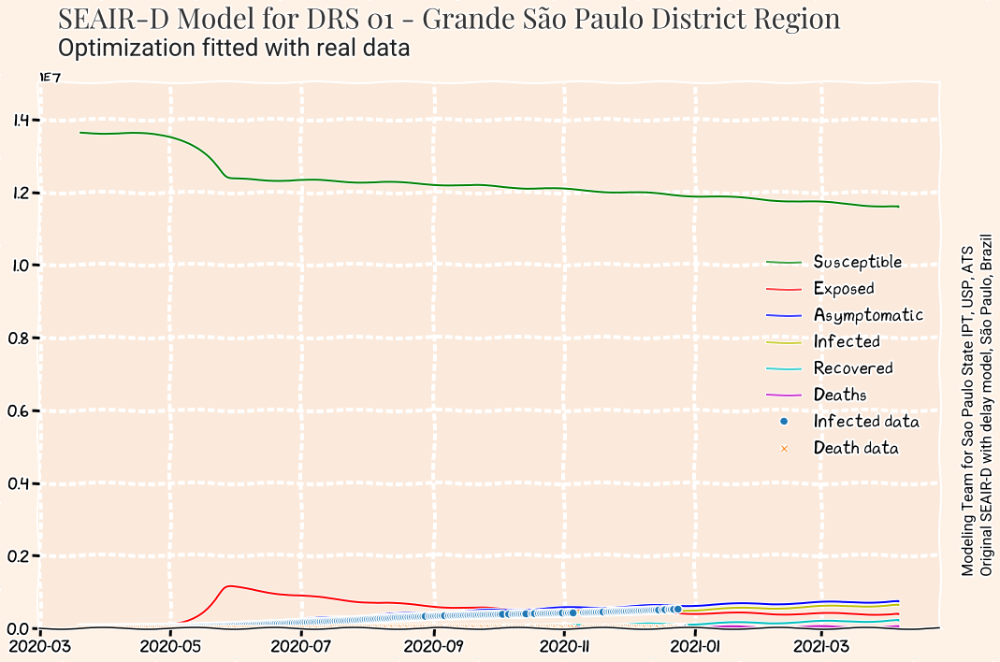

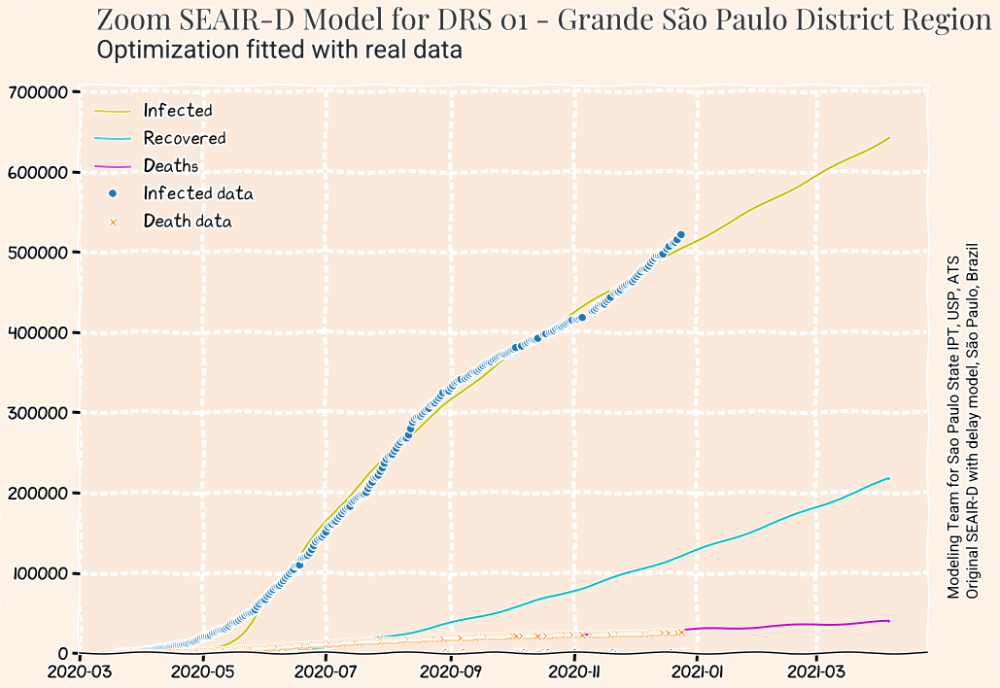

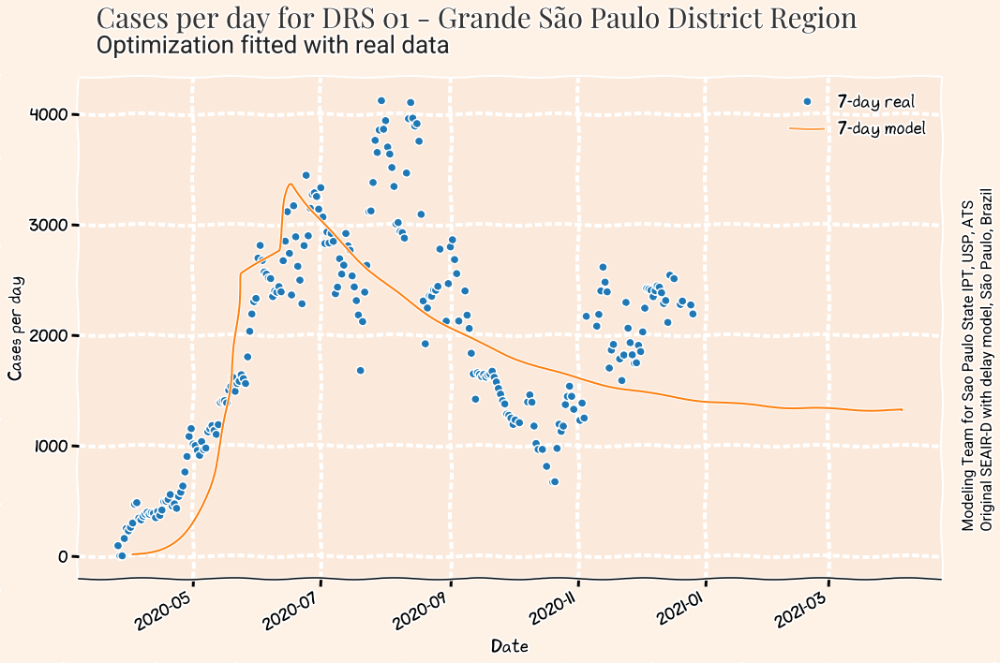

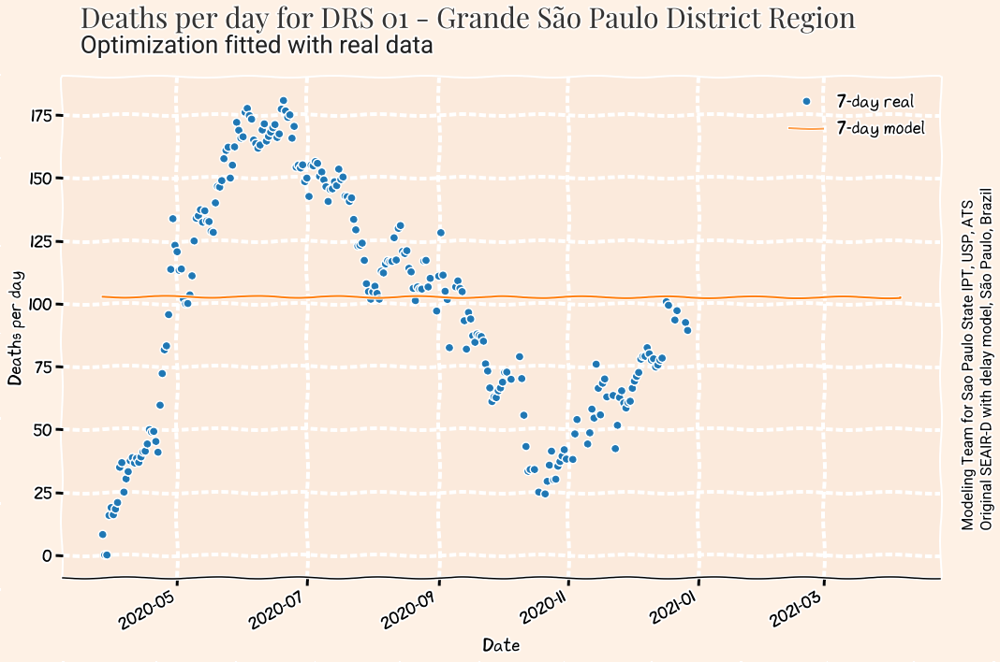

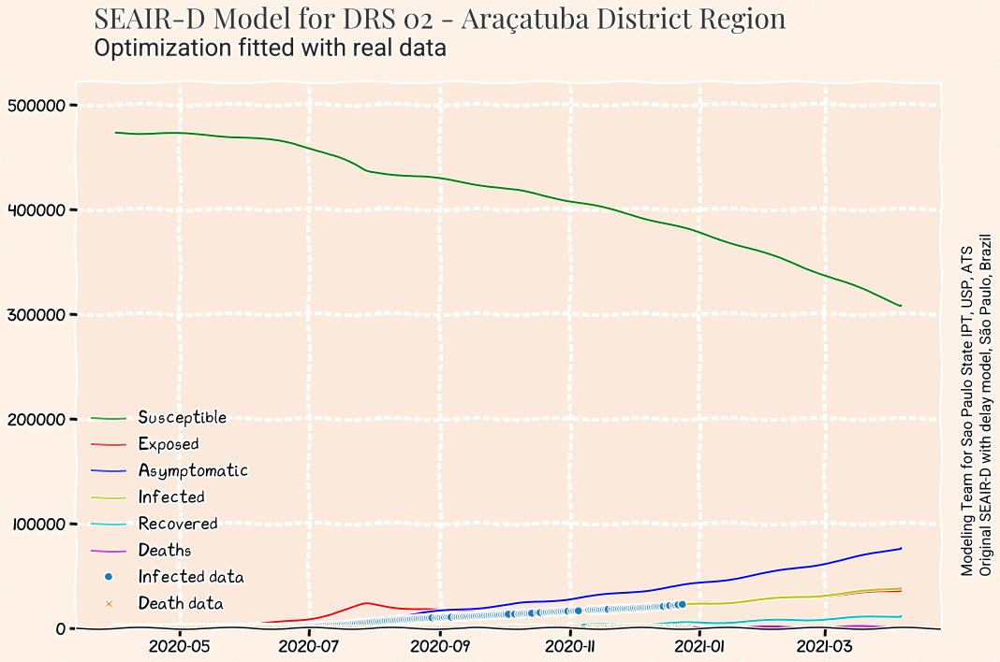

...

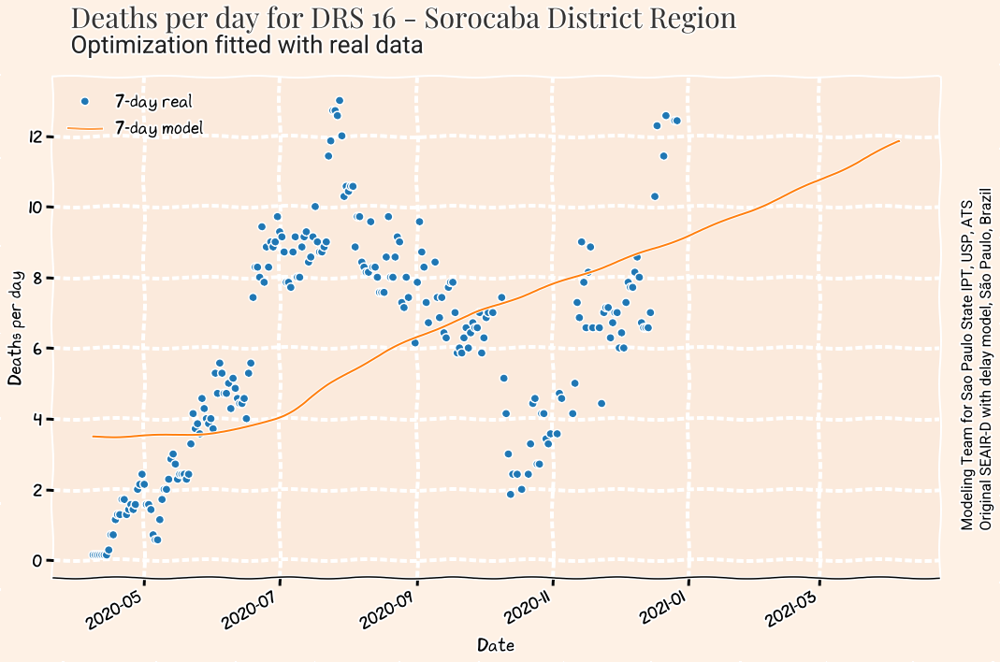

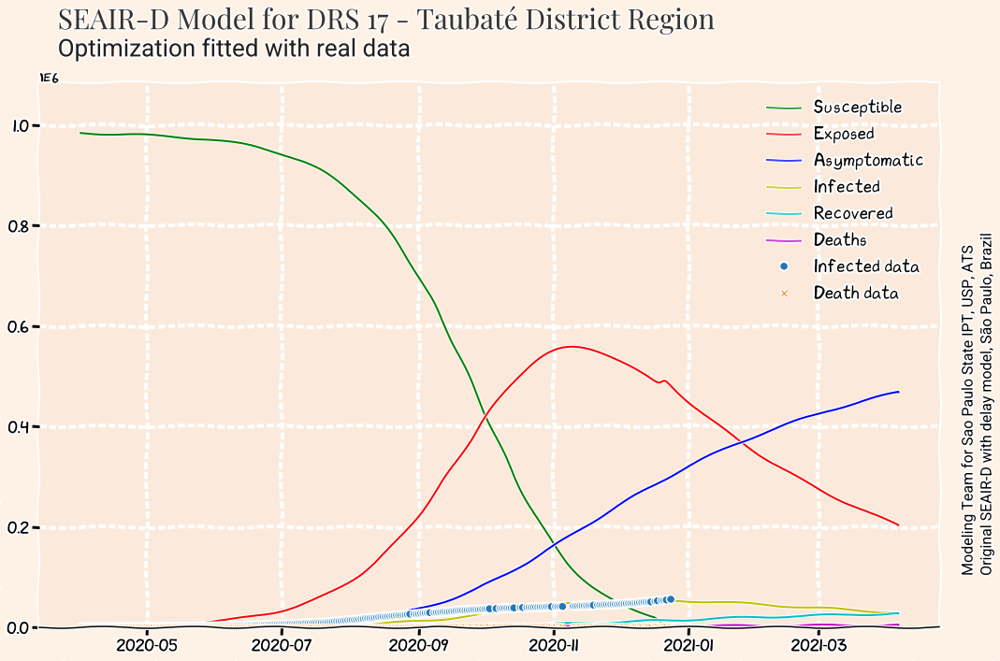

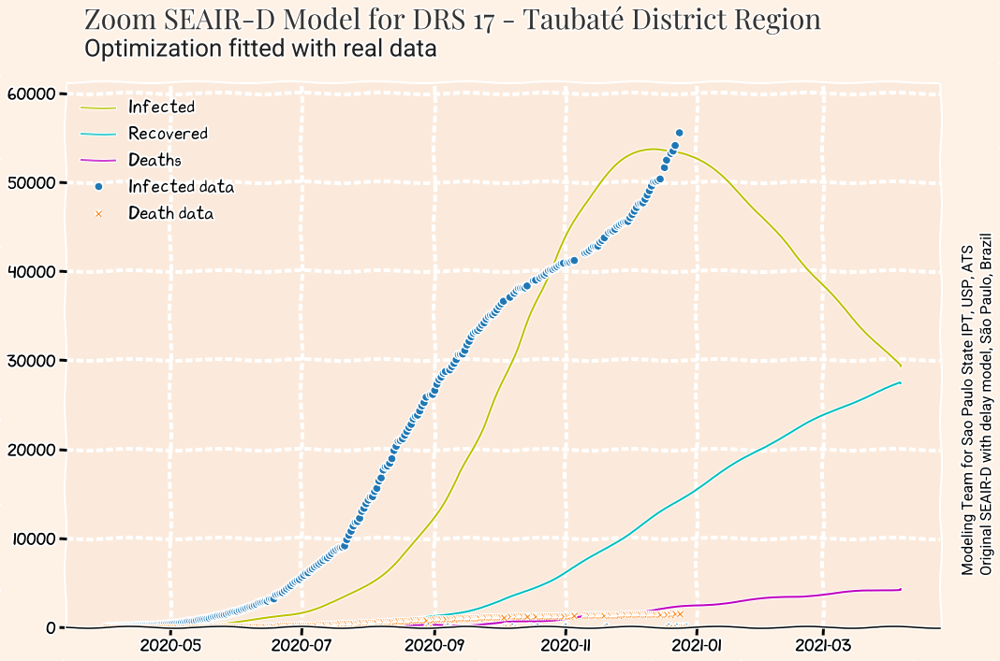

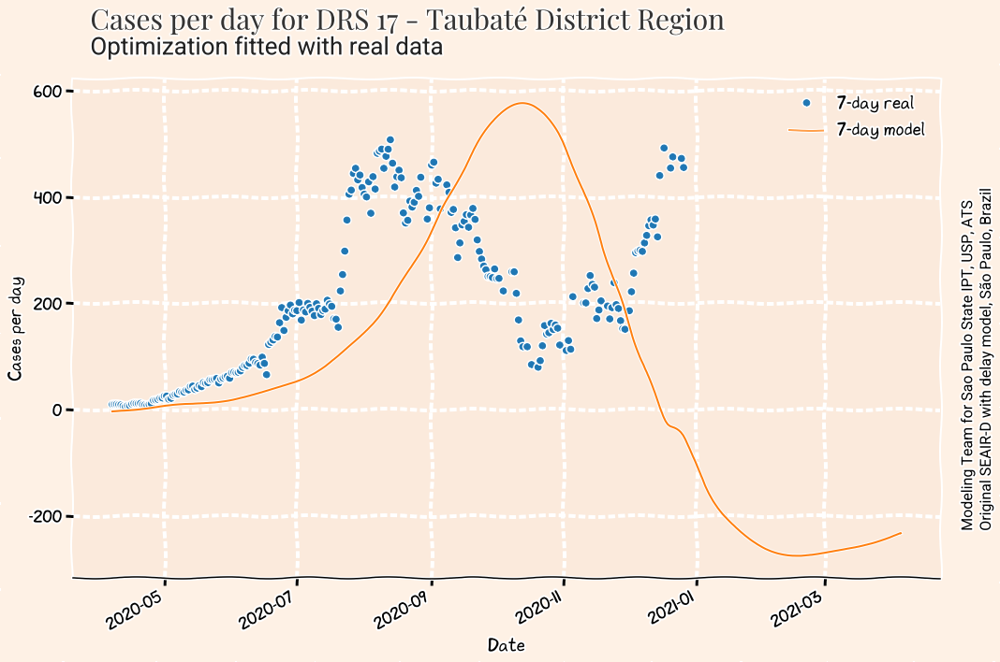

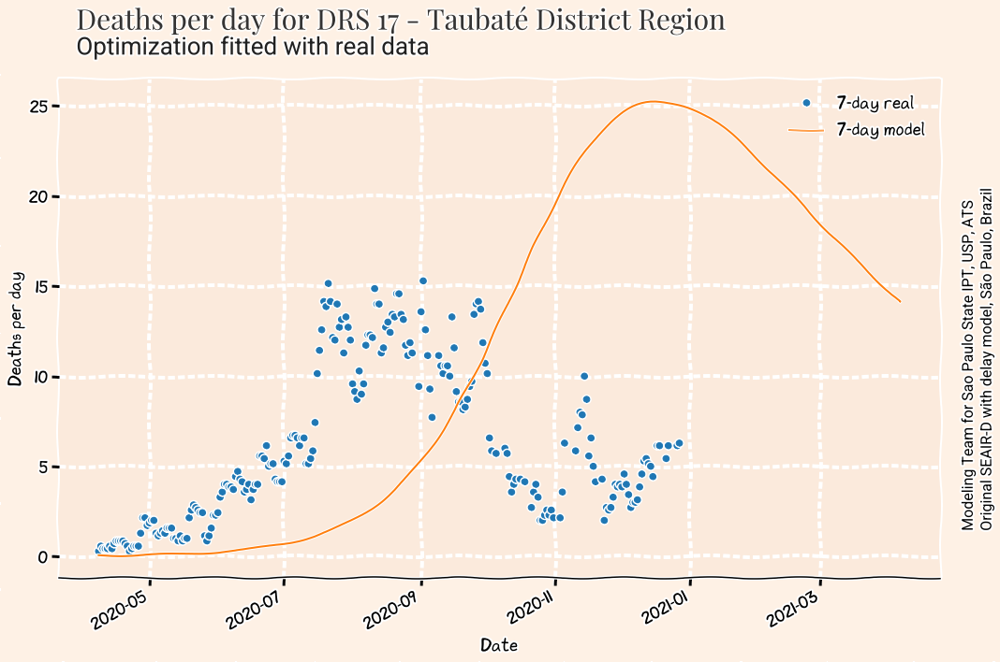

In [17]:
!export LC_ALL='en_US.utf8'

#plots one district or all districts  
if opt==5:
    allDistricts=True
else:
    allDistricts=False
        
if allDistricts:
    for districtRegion in DRS:
        query = dfparam.query('DRS == "{}"'.format(districtRegion)).reset_index()
        ratio = query['RATIO'][0]
        startCase = query['START'][0]
        startdate = query['start-date'][0]
        predict_range = query['prediction-range'][0]
        
        #calcula data máxima dos gráficos
        #100 dias é usado como máximo dos cálculos da derivada das mortes
        lastDate=dfSP.date.max()
        maxDate= datetime.strptime(lastDate, "%Y-%m-%d") + timedelta(days = 100) #"2020-08-31"
        maxDateStr = maxDate.strftime("%Y-%m-%d")

        covid_plots.covid_plots(districtRegion, districts4Plot, startdate, predict_range, \
                        startCase, opt, version, show=True, ratio=ratio, maxDate=maxDateStr, model=model)
else: 
    query = dfparam.query('DRS == "{}"'.format(districtRegion)).reset_index()
    ratio = query['RATIO'][0]
    startdate = query['start-date'][0]
    predict_range = query['prediction-range'][0]
    startCase = query['START'][0]
    
    #calcula data máxima dos gráficos
    #100 dias é usado como máximo dos cálculos da derivada das mortes
    lastDate=dfSP.date.max()
    maxDate= datetime.strptime(lastDate, "%Y-%m-%d") + timedelta(days = 100) #"2020-08-31"
    maxDateStr = maxDate.strftime("%Y-%m-%d")    
    
    covid_plots.covid_plots(districtRegion, districts4Plot, startdate, predict_range, \
                       startCase, opt, version, show=True, ratio=ratio, maxDate=maxDateStr, model=model)